<h1 style="font-size:4em;">
Spike Sorting from Scratch
</h1>

cwd: C:\Users\ExoGame
data length = 71,698,898 samples  (2390.0 s)


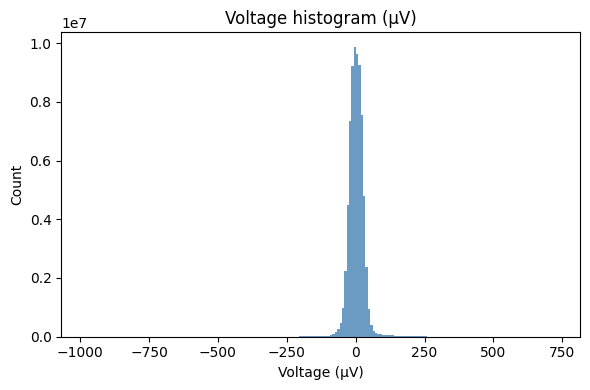

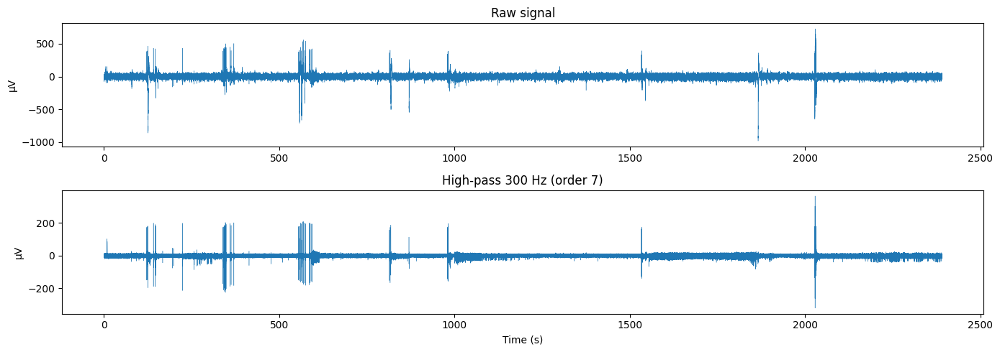

σₙ = 2.707 µV   →   θ = 13.533 µV
spikes detected: 8999
waveforms matrix: (8999, 120)


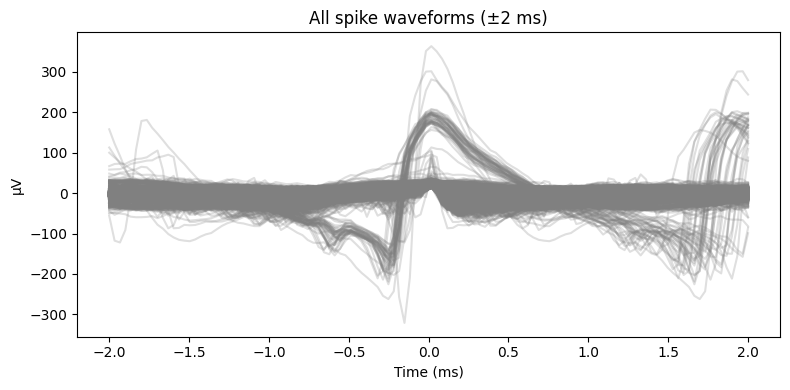

explained variance ratio: [0.3591214  0.15326253 0.10930093]


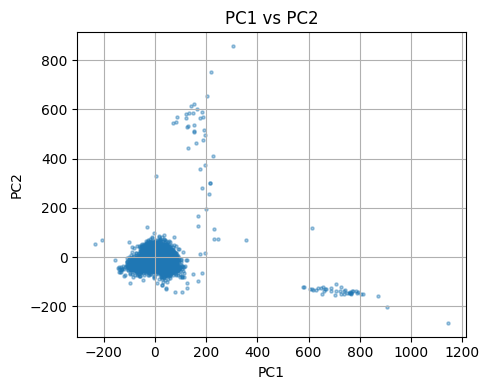

C:\ProgramData\anaconda3\envs\gpu_env\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] The system cannot find the file specified
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "C:\ProgramData\anaconda3\envs\gpu_env\lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
  File "C:\ProgramData\anaconda3\envs\gpu_env\lib\subprocess.py", line 493, in run
    with Popen(*popenargs, **kwargs) as process:
  File "C:\ProgramData\anaconda3\envs\gpu_env\lib\subprocess.py", line 858, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "C:\ProgramData\anaconda3\envs\gpu_env\lib\subprocess.py", line 1327, in _execute_child
    hp, ht, pid, tid = _winapi.CreateProcess

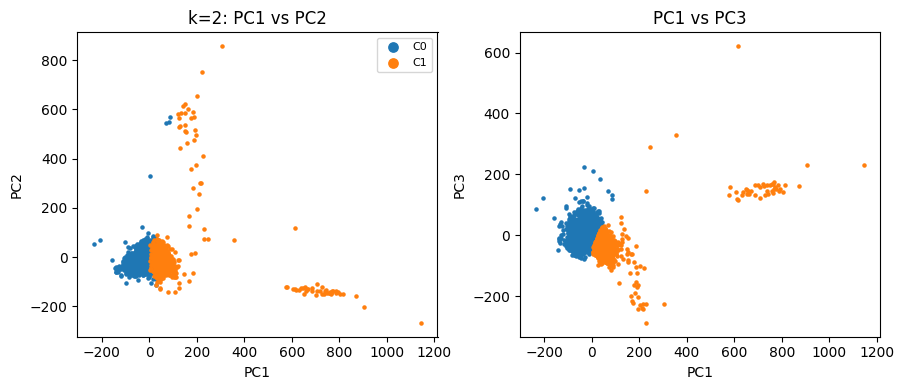

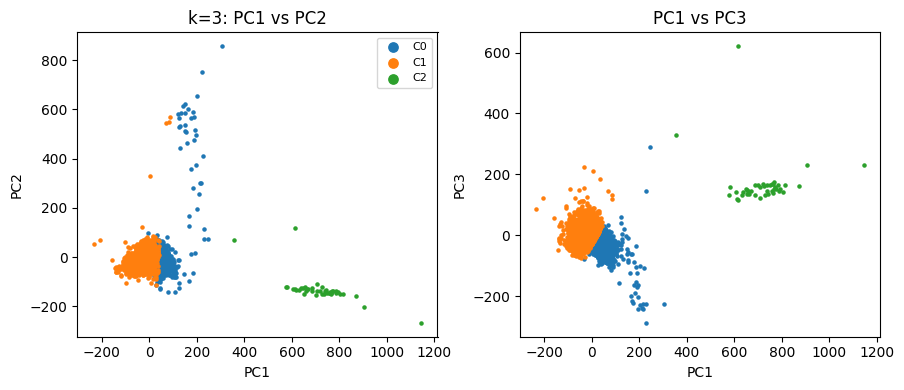

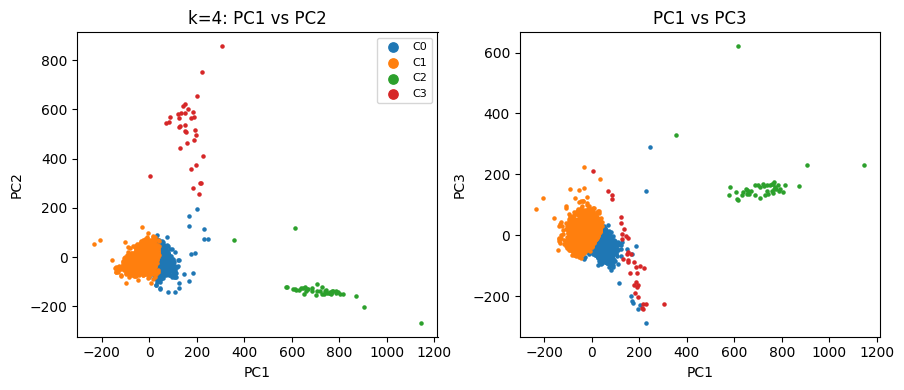

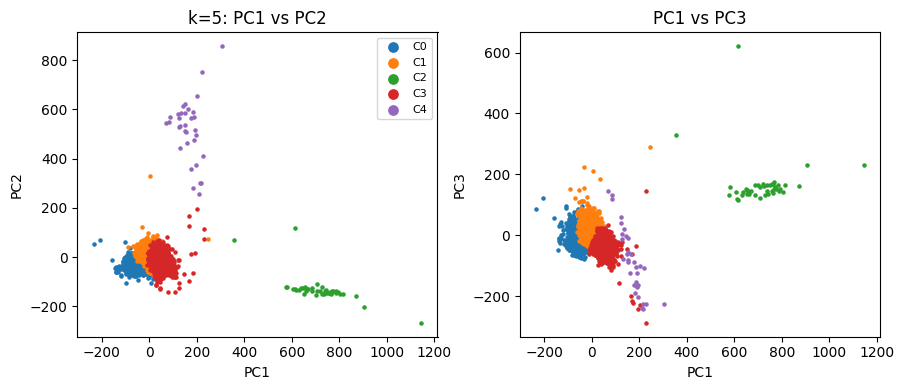

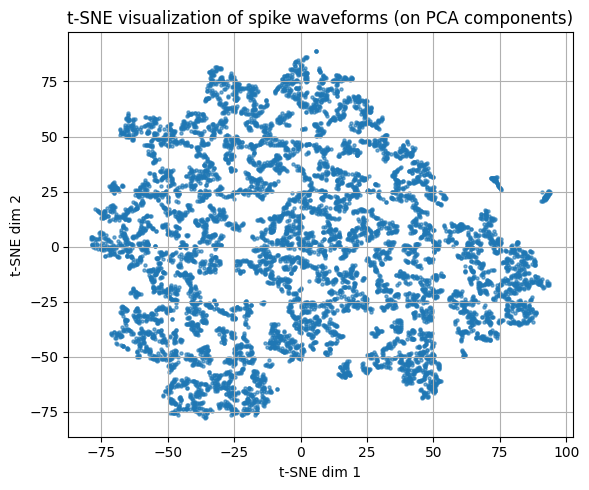

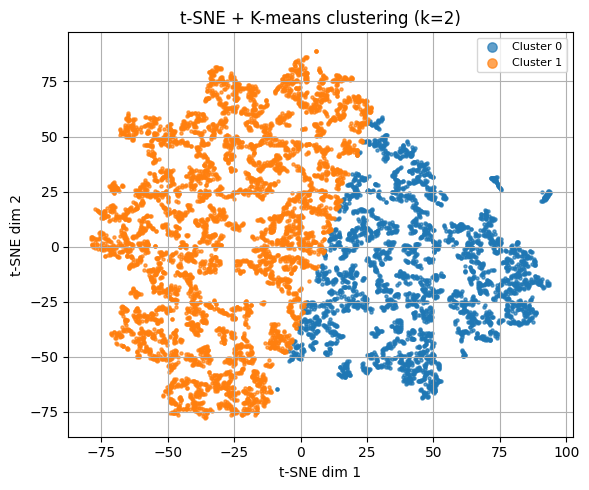

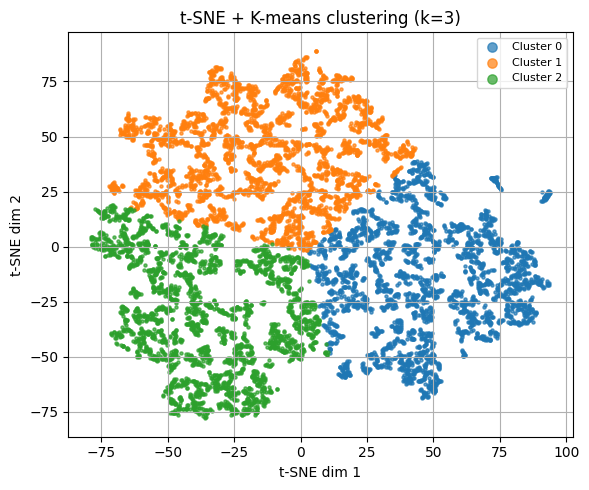

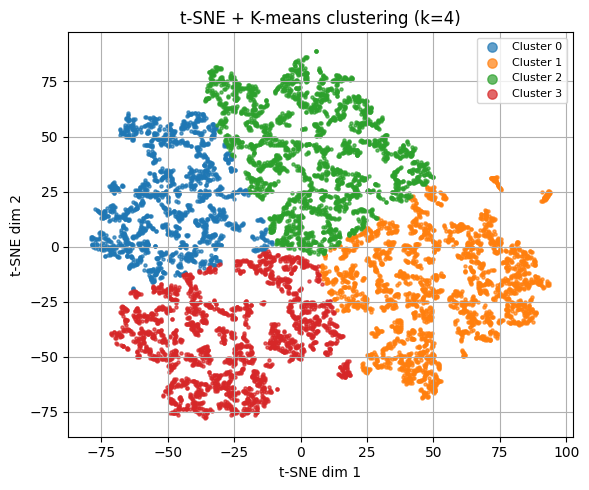

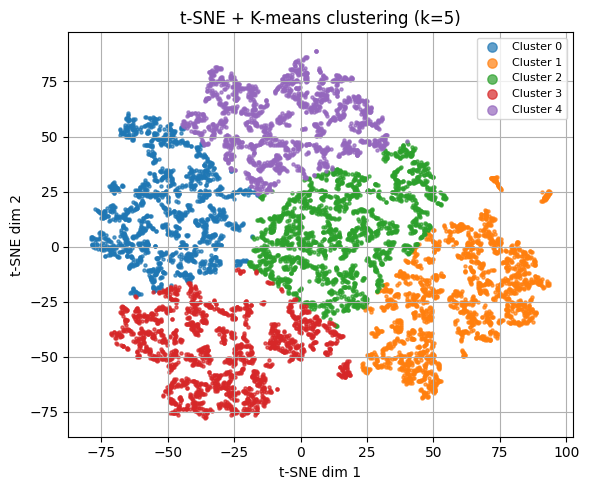

In [17]:
import os, h5py, numpy as np, matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, find_peaks
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
MAT_FILE      = 'singleIT.mat'
DATASET       = 'data_IT'
FS            = 30_000
SCALE_FACTOR  = 10
HP_CUTOFF     = 300
HP_ORDER      = 7
THR_MULT      = 5
WIN_MS        = 2
K_RANGE       = range(2, 6)
print('cwd:', os.getcwd())
with h5py.File(MAT_FILE, 'r') as f:
    if DATASET not in f:
        raise KeyError(f"'{DATASET}' not found in {MAT_FILE}")
    data = np.array(f[DATASET]).flatten()
data = data / SCALE_FACTOR
n_samples = data.size
time_s = np.arange(n_samples) / FS
print(f'data length = {n_samples:,} samples  ({n_samples/FS:.1f} s)')
plt.figure(figsize=(6,4))
plt.hist(data, bins=200, color='steelblue', alpha=.8)
plt.title('Voltage histogram (µV)')
plt.xlabel('Voltage (µV)'); plt.ylabel('Count')
plt.tight_layout(); plt.show()
def butter_hp(cut, fs, order):
    b, a = butter(order, cut/(0.5*fs), 'high')
    return b, a
b, a = butter_hp(HP_CUTOFF, FS, HP_ORDER)
data_filt = filtfilt(b, a, data)
plt.figure(figsize=(14,5))
plt.subplot(2,1,1)
plt.plot(time_s, data, lw=.3)
plt.title('Raw signal'); plt.ylabel('µV')
plt.subplot(2,1,2)
plt.plot(time_s, data_filt, lw=.3)
plt.title(f'High-pass {HP_CUTOFF} Hz (order {HP_ORDER})')
plt.xlabel('Time (s)'); plt.ylabel('µV')
plt.tight_layout(); plt.show()
sigma_n = np.median(np.abs(data_filt)/0.6745)
theta   = THR_MULT * sigma_n
print(f'σₙ = {sigma_n:.3f} µV   →   θ = {theta:.3f} µV')
peaks, _ = find_peaks(data_filt,
                      height=theta,
                      distance=int(0.001*FS))
print('spikes detected:', len(peaks))
if len(peaks) == 0:
    raise RuntimeError('No spikes above threshold – adjust θ or check data.')
w      = int(WIN_MS*FS/1000)
t_ms   = np.linspace(-WIN_MS, WIN_MS, 2*w)
waves  = []
for p in peaks:
    if p-w >= 0 and p+w < n_samples:
        waves.append(data_filt[p-w:p+w])
waveforms = np.vstack(waves)
print('waveforms matrix:', waveforms.shape)
plt.figure(figsize=(8,4))
plt.plot(t_ms, waveforms.T, color='gray', alpha=.25)
plt.title('All spike waveforms (±2 ms)')
plt.xlabel('Time (ms)'); plt.ylabel('µV')
plt.tight_layout(); plt.show()
pca = PCA(n_components=3)
pcs = pca.fit_transform(waveforms)
print('explained variance ratio:', pca.explained_variance_ratio_)
plt.figure(figsize=(5,4))
plt.scatter(pcs[:,0], pcs[:,1], s=5, alpha=.4)
plt.xlabel('PC1'); plt.ylabel('PC2'); plt.title('PC1 vs PC2')
plt.grid(True); plt.tight_layout(); plt.show()
for k in K_RANGE:
    km = KMeans(n_clusters=k, n_init=10, random_state=0)
    labels = km.fit_predict(pcs)
    fig, (ax1, ax2) = plt.subplots(1,2,figsize=(9,4))
    for lab in range(k):
        ax1.scatter(pcs[labels==lab,0], pcs[labels==lab,1], s=5, label=f'C{lab}')
        ax2.scatter(pcs[labels==lab,0], pcs[labels==lab,2], s=5)
    ax1.set_xlabel('PC1'); ax1.set_ylabel('PC2')
    ax1.set_title(f'k={k}: PC1 vs PC2'); ax1.legend(markerscale=3, fontsize=8)
    ax2.set_xlabel('PC1'); ax2.set_ylabel('PC3')
    ax2.set_title('PC1 vs PC3')
    plt.tight_layout(); plt.show()
tsne = TSNE(n_components=2, perplexity=30, random_state=0)
pcs_tsne = tsne.fit_transform(pcs)
plt.figure(figsize=(6,5))
plt.scatter(pcs_tsne[:,0], pcs_tsne[:,1], s=5, alpha=0.6)
plt.title('t-SNE visualization of spike waveforms (on PCA components)')
plt.xlabel('t-SNE dim 1')
plt.ylabel('t-SNE dim 2')
plt.grid(True)
plt.tight_layout()
plt.show()
for k in K_RANGE:
    km_tsne = KMeans(n_clusters=k, n_init=10, random_state=0)
    labels_tsne = km_tsne.fit_predict(pcs_tsne)
    plt.figure(figsize=(6,5))
    for lab in range(k):
        plt.scatter(pcs_tsne[labels_tsne==lab,0], pcs_tsne[labels_tsne==lab,1],
                    s=5, label=f'Cluster {lab}', alpha=0.7)
    plt.title(f't-SNE + K-means clustering (k={k})')
    plt.xlabel('t-SNE dim 1')
    plt.ylabel('t-SNE dim 2')
    plt.legend(markerscale=3, fontsize=8)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

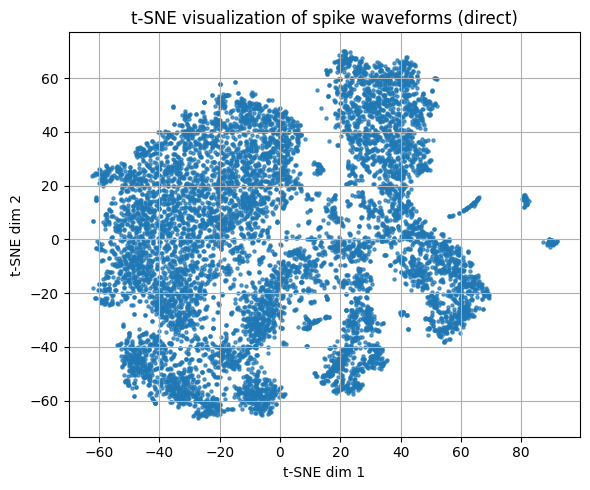

In [21]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, perplexity=30, random_state=0)
waveforms_tsne = tsne.fit_transform(waveforms)
plt.figure(figsize=(6,5))
plt.scatter(waveforms_tsne[:,0], waveforms_tsne[:,1], s=5, alpha=0.7)
plt.title('t-SNE visualization of spike waveforms (direct)')
plt.xlabel('t-SNE dim 1')
plt.ylabel('t-SNE dim 2')
plt.grid(True)
plt.tight_layout()
plt.show()

<h1 style="font-size:4em;">
Spikes.mat
</h1>

In [23]:
"""
Spike‐detection vs. ground‐truth comparison (no unit conversion)
– فیلتر بانداپس 300–3000 Hz
– تست ضریب‌های مختلف کاهش نمونه‌برداری (decimation)
– شناسایی پیک‌های مثبت/منفی با آستانهٔ σ-multiplier
– شمارش دقیق تعداد ‘hits’ بدون تبدیل واحد
"""
import h5py
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, find_peaks
MAT_RAW     = "singleIT.mat"
DATA_KEY    = "data_IT"
MAT_TRUTH   = "Spikes (1).mat"
TRUTH_CANDS = ["spikes","spikeTimes","trueSpikes","truth"]
FS          = 30000.0
LOWCUT      = 300.0
HIGHCUT     = 3000.0
FILTER_ORDER= 4
MIN_DIST_MS = 1.0
THR_MULT    = 4.0
DS_FACTORS  = [1, 2, 3, 5, 10, 20, 30, 60, 100]
def load_raw(fname, key):
    with h5py.File(fname, "r") as f:
        data = f[key][()]
    return np.array(data).flatten()
def load_truth(fname, candidates):
    with h5py.File(fname, "r") as f:
        for k in candidates:
            if k in f and isinstance(f[k], h5py.Dataset):
                d = f[k][()]
                if d.ndim==1 or (d.ndim==2 and 1 in d.shape):
                    return np.array(d).flatten().astype(int)
        best, best_len = None, 0
        def visitor(name, obj):
            nonlocal best, best_len
            if isinstance(obj, h5py.Dataset):
                shp = obj.shape
                if obj.ndim==1 or (obj.ndim==2 and 1 in shp):
                    length = shp[0] if obj.ndim==1 else (shp[0] if shp[1]==1 else shp[1])
                    if length>best_len:
                        best, best_len = obj, length
        f.visititems(visitor)
        if best is not None:
            return np.array(best).flatten().astype(int)
    raise RuntimeError("No 1D dataset found in truth file")
def bandpass(x, fs, low, high, order=4):
    b, a = butter(order, [low, high], btype='band', fs=fs)
    return filtfilt(b, a, x)
def detect_spikes(sig, fs, min_dist_ms, thr_mult):
    sigma_n = np.median(np.abs(sig)) / 0.6745
    thr = thr_mult * sigma_n
    min_dist = max(1, int(min_dist_ms * fs / 1000))
    p_pos, _ = find_peaks(sig,    height=thr, distance=min_dist)
    p_neg, _ = find_peaks(-sig,   height=thr, distance=min_dist)
    return np.sort(np.concatenate([p_pos, p_neg]))
if __name__=="__main__":
    raw = load_raw(MAT_RAW, DATA_KEY)
    print(f"Loaded raw: {raw.size} samples @ {FS:.0f} Hz")
    raw_f = bandpass(raw, FS, LOWCUT, HIGHCUT, FILTER_ORDER)
    truth = load_truth(MAT_TRUTH, TRUTH_CANDS)
    print(f"Loaded ground-truth: {truth.size} indices")
    results = []
    for ds in DS_FACTORS:
        fs_ds = FS / ds
        sig_ds = raw_f[::ds]
        det = detect_spikes(sig_ds, fs_ds, MIN_DIST_MS, THR_MULT)
        hits = np.intersect1d(det, truth, assume_unique=True).size
        results.append((ds, truth.size, det.size, hits))
        print(f"DS={ds:3d} → truth={truth.size:6d}, detected={det.size:6d}, matched={hits:6d}")
    print("\nSummary:")
    for ds, Ntruth, Ndet, Nhits in results:
        print(f"  DS={ds:3d}: matched {Nhits}/{Ntruth} ({Nhits/Ntruth*100:.2f} %)")

Loaded raw: 71698898 samples @ 30000 Hz
Loaded ground-truth: 90789 indices
DS=  1 → truth= 90789, detected= 66295, matched=    15
DS=  2 → truth= 90789, detected= 65110, matched=    55
DS=  3 → truth= 90789, detected= 63328, matched=   114
DS=  5 → truth= 90789, detected= 58567, matched=   187
DS= 10 → truth= 90789, detected= 46091, matched=   307
DS= 20 → truth= 90789, detected= 28248, matched=   288
DS= 30 → truth= 90789, detected= 19238, matched=  1004
DS= 60 → truth= 90789, detected=  9311, matched=   936
DS=100 → truth= 90789, detected=  5707, matched=   728

Summary:
  DS=  1: matched 15/90789 (0.02 %)
  DS=  2: matched 55/90789 (0.06 %)
  DS=  3: matched 114/90789 (0.13 %)
  DS=  5: matched 187/90789 (0.21 %)
  DS= 10: matched 307/90789 (0.34 %)
  DS= 20: matched 288/90789 (0.32 %)
  DS= 30: matched 1004/90789 (1.11 %)
  DS= 60: matched 936/90789 (1.03 %)
  DS=100: matched 728/90789 (0.80 %)


Using GT dataset 'ind_spikes_it' with 90789 events
θσ=84.674, θmax=3377.317, GT spikes=90789

θσ: det=19238, TP=1004, FP=18234, FN=89785
Prec=0.052, Rec=0.011, F1=0.018
θσ-all: 19238 waveforms


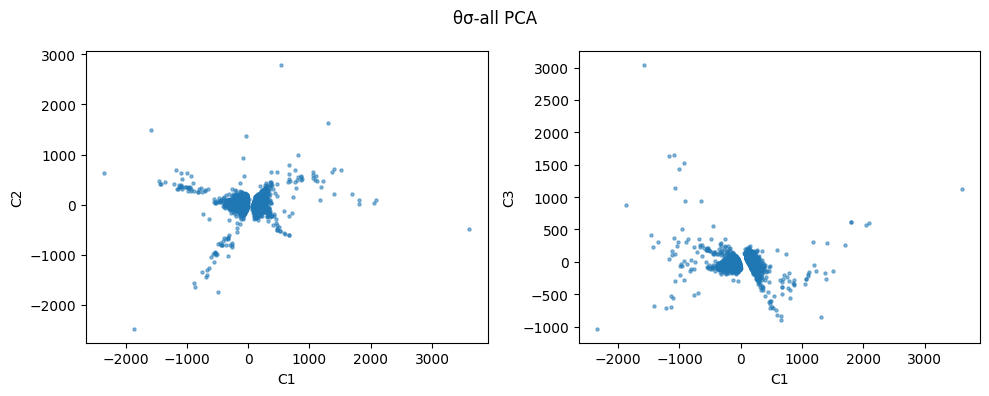

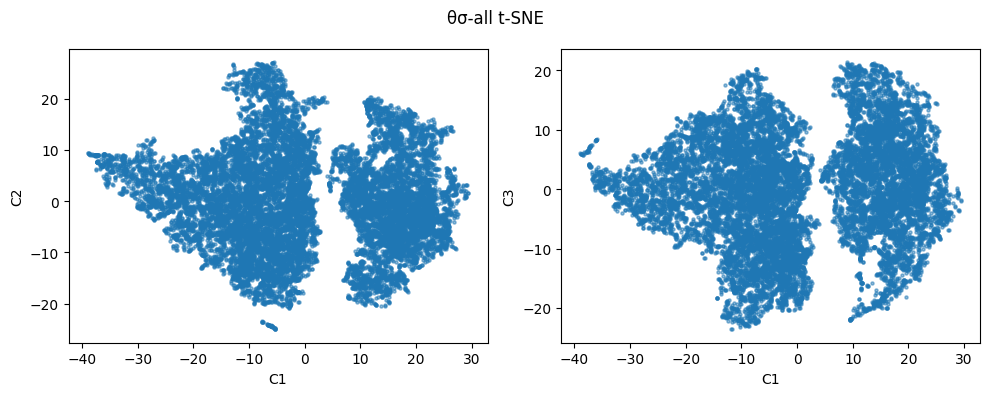

θσ-matched: 1004 waveforms


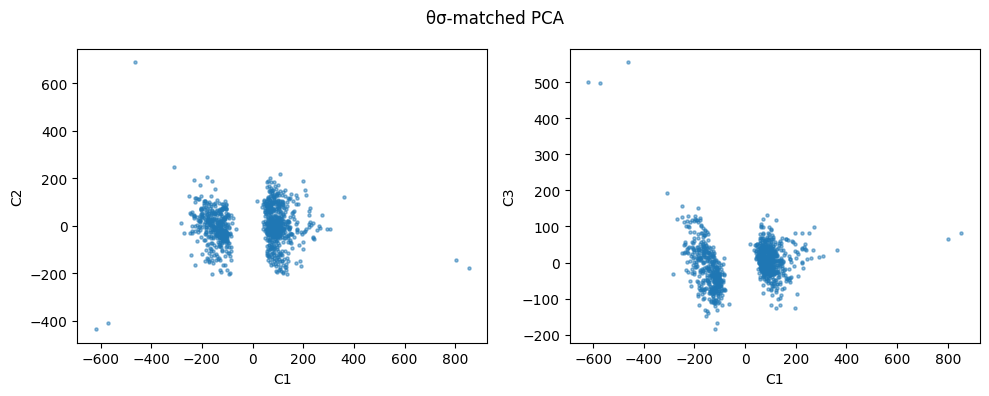

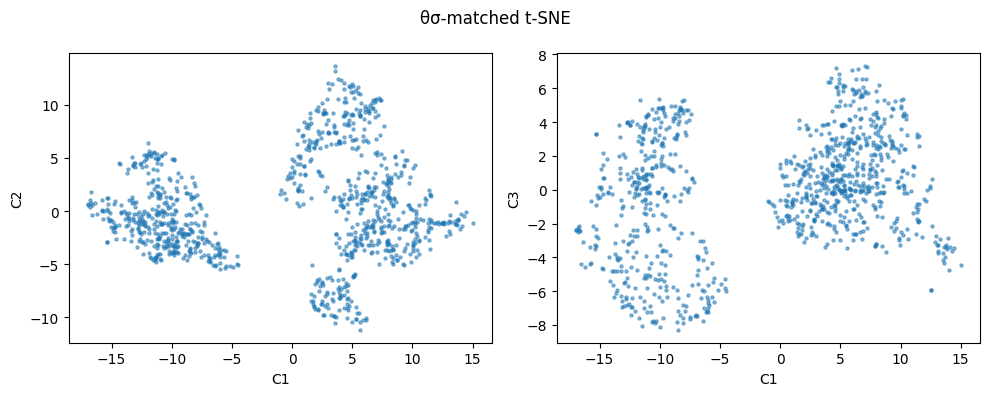


θmax: det=1, TP=0, FP=1, FN=90789
Prec=0.000, Rec=0.000, F1=0.000
θmax-all: 1 waveforms


ValueError: n_components=3 must be between 0 and min(n_samples, n_features)=1 with svd_solver='full'

In [45]:
"""
Spike‐detection @ truth rate (1000 Hz)
– band‐pass 300–3000 Hz (order=4)
– decimate raw 30 kHz→1 kHz (factor=30)
– detect ± peaks with two thresholds:
     θσ   = 4·σₙ      (σₙ = median(|x|)/0.6745)
     θmax = 0.9·max|x|
– truth indices are already at 1 kHz → no mapping back
– count hits by exact intersect at 1 kHz
– compute Precision, Recall, F1
– extract ±2 ms waveforms on 1 kHz signal
– PCA & t‐SNE on “all” vs “matched” spikes
"""
import h5py
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, find_peaks
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
MAT_RAW     = "singleIT.mat"
KEY_RAW     = "data_IT"
MAT_GT      = "Spikes (1).mat"
FS_RAW      = 30000.0
DS          = 30
FS_DS       = FS_RAW/DS
LOWCUT, HIGHCUT = 300.0, 3000.0
ORDER       = 4
THR_MULT    = 4.0
WIN_MS      = 2.0
MIN_DIST_MS = 1.0
def load_raw():
    with h5py.File(MAT_RAW,'r') as f:
        return f[KEY_RAW][()].flatten()
def load_truth():
    best, best_len, name = None, 0, None
    with h5py.File(MAT_GT,'r') as f:
        def visitor(n,obj):
            nonlocal best, best_len, name
            if isinstance(obj,h5py.Dataset):
                d = np.array(obj[()]).flatten()
                if d.ndim==1 and d.size>best_len:
                    best_len = d.size; best = d.astype(int); name = n
        f.visititems(visitor)
    if best is None:
        raise RuntimeError("No 1-D dataset in ground-truth file")
    print(f"Using GT dataset '{name}' with {best_len} events")
    return best
def bandpass(x, fs):
    b,a = butter(ORDER, [LOWCUT, HIGHCUT], btype='band', fs=fs)
    return filtfilt(b, a, x)
def detect(sig, fs, thr):
    d = max(1, int(MIN_DIST_MS*fs/1000))
    p,_ = find_peaks(sig, height=thr, distance=d)
    n,_ = find_peaks(-sig, height=thr, distance=d)
    return np.sort(np.concatenate([p,n]))
def extract_waveforms(sig, peaks, fs, win_ms):
    w = int(win_ms*fs/1000)
    waves=[]
    for p in peaks:
        if p-w>=0 and p+w<sig.size:
            waves.append(sig[p-w:p+w])
    return np.array(waves)
def plot_feats(feats, title):
    fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,4))
    ax1.scatter(feats[:,0],feats[:,1],s=5,alpha=.5); ax1.set_xlabel('C1'); ax1.set_ylabel('C2')
    ax2.scatter(feats[:,0],feats[:,2],s=5,alpha=.5); ax2.set_xlabel('C1'); ax2.set_ylabel('C3')
    fig.suptitle(title); plt.tight_layout(); plt.show()
raw = load_raw()
sig_f = bandpass(raw, FS_RAW)
sig_ds = sig_f[::DS]
truth = load_truth()
sigma_n   = np.median(np.abs(sig_ds)) / 0.6745
thr_sigma = THR_MULT * sigma_n
thr_max   = 0.9 * np.max(np.abs(sig_ds))
print(f"θσ={thr_sigma:.3f}, θmax={thr_max:.3f}, GT spikes={truth.size}")
dets = {
    'θσ': detect(sig_ds, FS_DS, thr_sigma),
    'θmax': detect(sig_ds, FS_DS, thr_max)
}
for tag, peaks in dets.items():
    TP = np.intersect1d(peaks, truth).size
    FP = peaks.size - TP
    FN = truth.size - TP
    prec = TP/(TP+FP) if TP+FP>0 else 0
    rec  = TP/(TP+FN) if TP+FN>0 else 0
    f1   = 2*prec*rec/(prec+rec) if prec+rec>0 else 0
    print(f"\n{tag}: det={peaks.size}, TP={TP}, FP={FP}, FN={FN}")
    print(f"Prec={prec:.3f}, Rec={rec:.3f}, F1={f1:.3f}")
    for mode, idxs in [('all', peaks), ('matched', np.intersect1d(peaks, truth))]:
        wav = extract_waveforms(sig_ds, idxs, FS_DS, WIN_MS)
        print(f"{tag}-{mode}: {wav.shape[0]} waveforms")
        if wav.size:
            pcs = PCA(n_components=3).fit_transform(wav)
            plot_feats(pcs, f"{tag}-{mode} PCA")
            emb = TSNE(n_components=3, init='pca', learning_rate='auto',
                       random_state=0, perplexity=30).fit_transform(wav)
            plot_feats(emb, f"{tag}-{mode} t-SNE")

<h1 style="font-size:4em;">
Analysis of Single Neuron Activity:
PSTH
</h1>

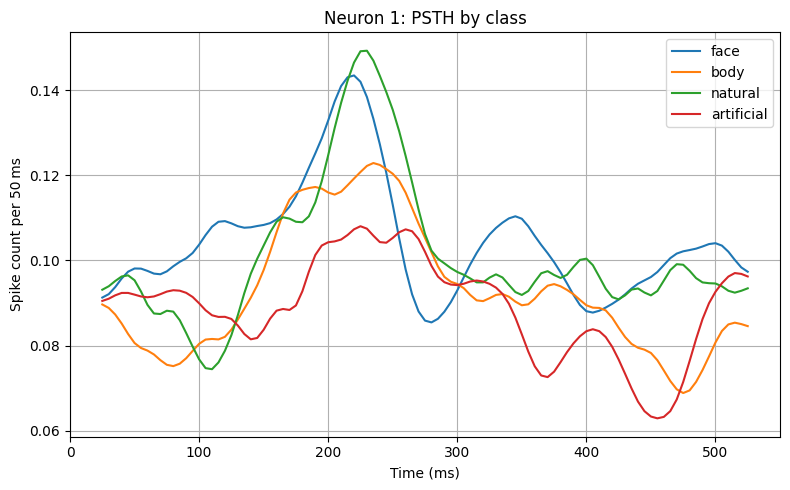

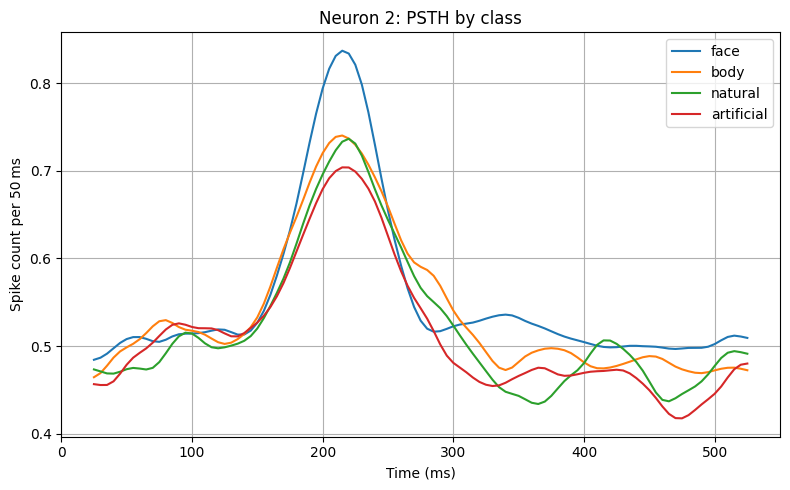

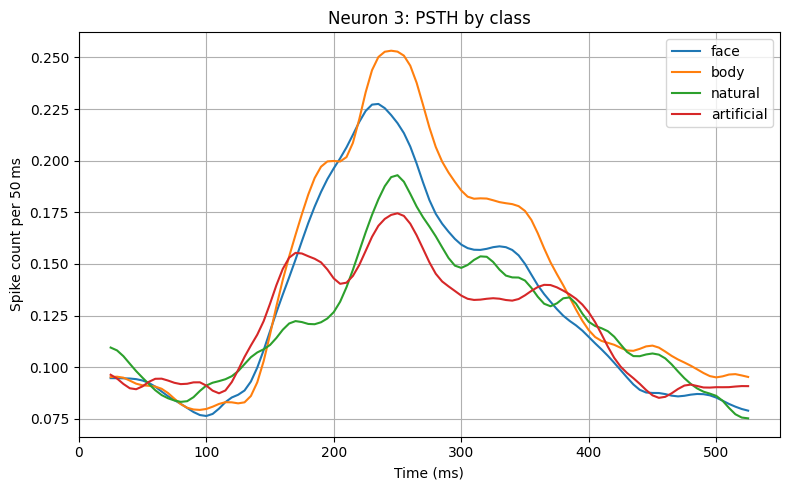

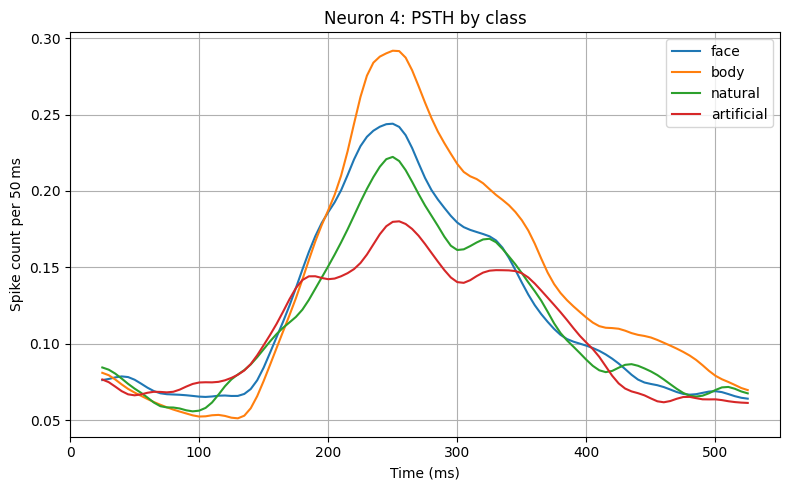

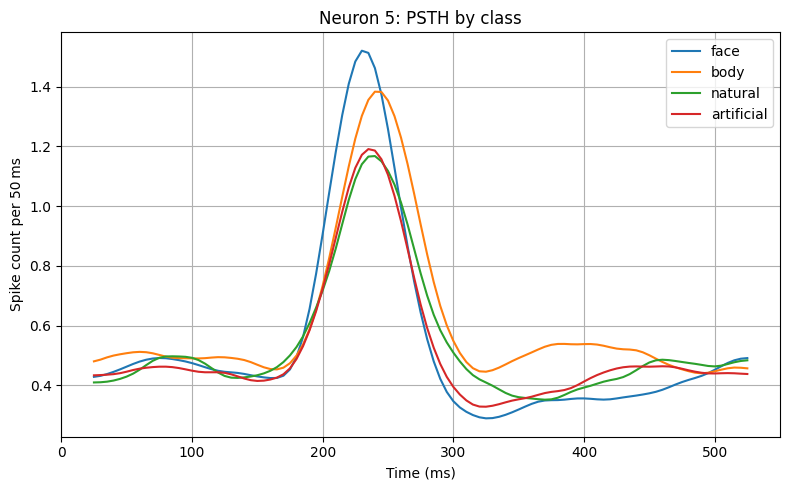

...

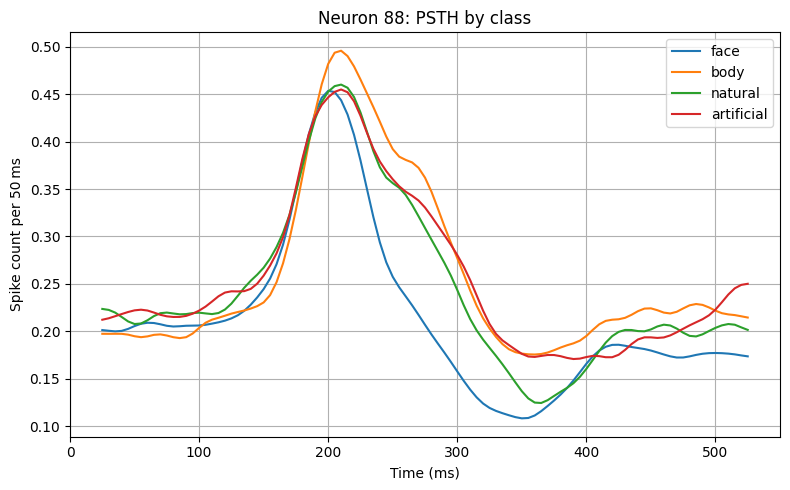

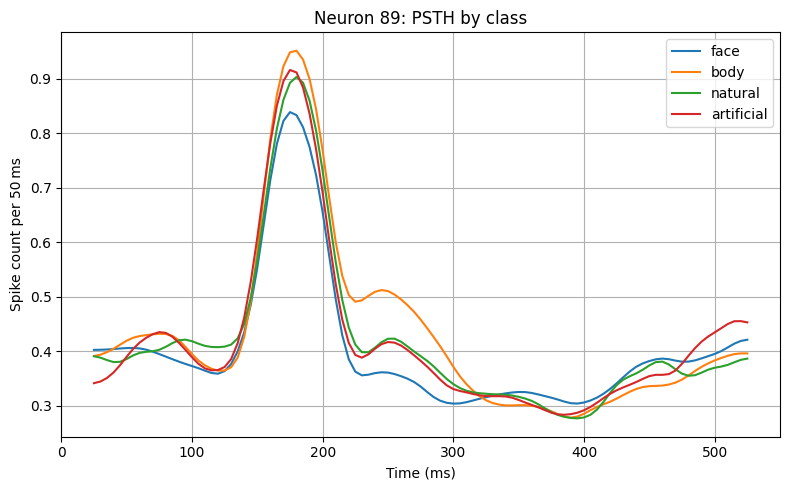

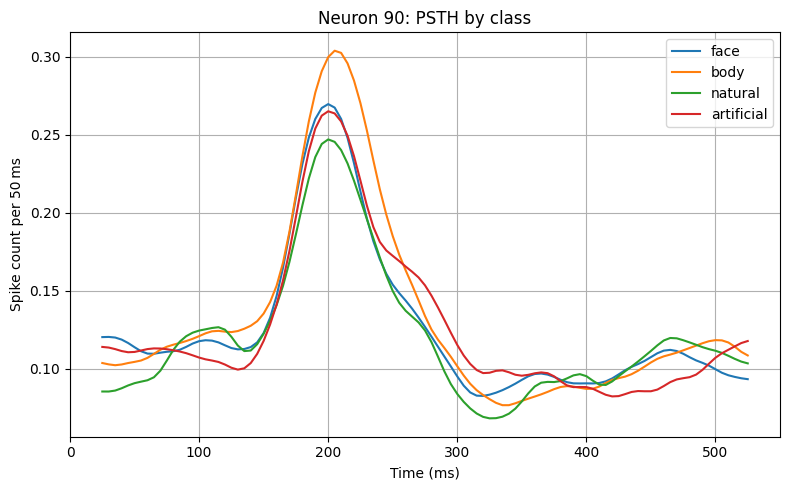

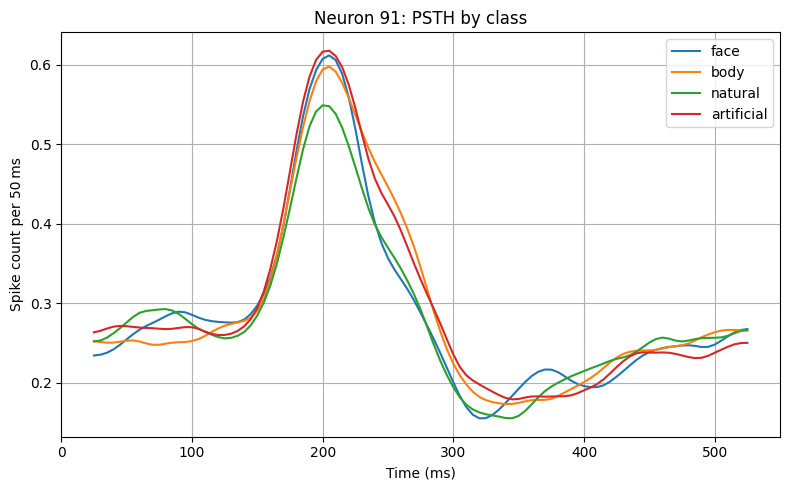

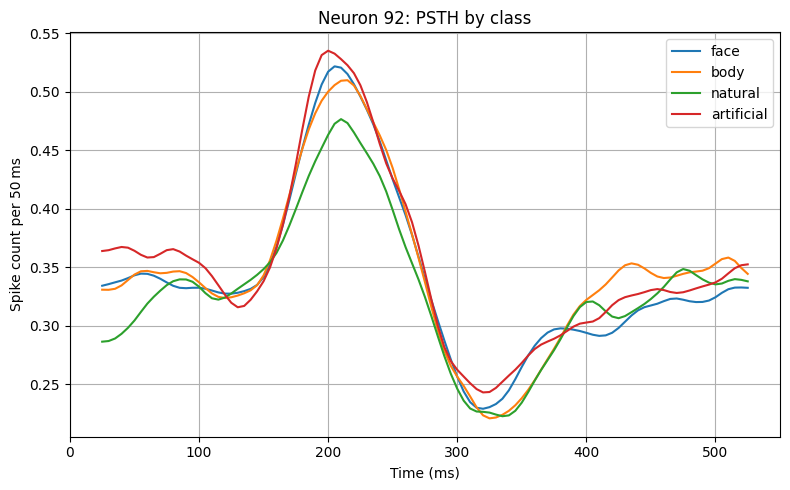

In [23]:
"""
Plot PSTH by stimulus class (face/body/natural/artificial) for each neuron,
with Gaussian smoothing.
"""
import h5py
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
MAT_FILE = 'dataVasati.mat'
START_MS = 0
END_MS   = 550
FS       = 1000
WIN_MS   = 50
STEP_MS  = 5
SMOOTH_SIGMA = 1.5
CLASS_MAP = {
    0: 'face',
    1: 'body',
    2: 'natural',
    3: 'artificial'
}
def load_per_neuron(mat_file, start_ms=0, end_ms=550, fs=1000):
    with h5py.File(mat_file, 'r') as f:
        grp = f['SpikeTrain_it_all']
        n_neurons = grp['data'].shape[0]
        data_list = []
        stim_list = []
        for i in range(n_neurons):
            refs = np.array(f[grp['cm'][i,0]]['index']).flatten()
            stim = np.array([int(f[r][()][0]) for r in refs])
            stim_list.append(stim)
            ds = grp['data'][i,0]
            arr = np.array(f[ds])
            if arr.shape[0] != stim.size:
                arr = arr.T
            s0 = int(start_ms * fs / 1000)
            s1 = int(end_ms   * fs / 1000)
            arr = arr[:, s0:s1]
            data_list.append(arr)
    return data_list, stim_list
def compute_features_single(data, window_ms=50, step_ms=5, fs=1000):
    n_trials, n_time = data.shape
    win_pts  = int(window_ms * fs / 1000)
    step_pts = int(step_ms   * fs / 1000)
    starts   = np.arange(0, n_time - win_pts + 1, step_pts)
    n_bins   = len(starts)
    feats    = np.zeros((n_trials, n_bins))
    for j, s0 in enumerate(starts):
        feats[:, j] = data[:, s0:s0+win_pts].sum(axis=1)
    times = starts / fs * 1000 + window_ms/2
    return feats, times
def map_to_class(code):
    if 1 <= code <= 200:   return 0
    if 201 <= code <= 320: return 1
    if 321 <= code <= 390: return 2
    if 391 <= code <= 500: return 3
    return -1
if __name__ == '__main__':
    data_list, stim_list = load_per_neuron(MAT_FILE, START_MS, END_MS, FS)
    for neuron_idx, (data, stim) in enumerate(zip(data_list, stim_list), start=1):
        feats, times = compute_features_single(data, WIN_MS, STEP_MS, FS)
        plt.figure(figsize=(8,5))
        for cls_code, cls_name in CLASS_MAP.items():
            mask = (np.array([map_to_class(s) for s in stim]) == cls_code)
            if mask.sum() == 0:
                continue
            mean_psth = feats[mask].mean(axis=0)
            smooth_psth = gaussian_filter1d(mean_psth, sigma=SMOOTH_SIGMA)
            plt.plot(times, smooth_psth, label=cls_name)
        plt.title(f'Neuron {neuron_idx}: PSTH by class')
        plt.xlabel('Time (ms)')
        plt.ylabel(f'Spike count per {WIN_MS} ms')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

<h1 style="font-size:4em;">
FANO FACTOR
</h1>

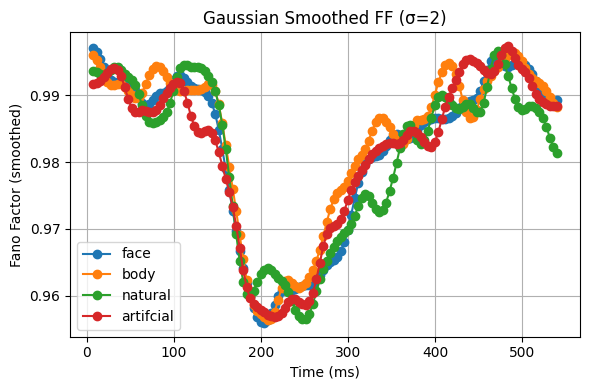

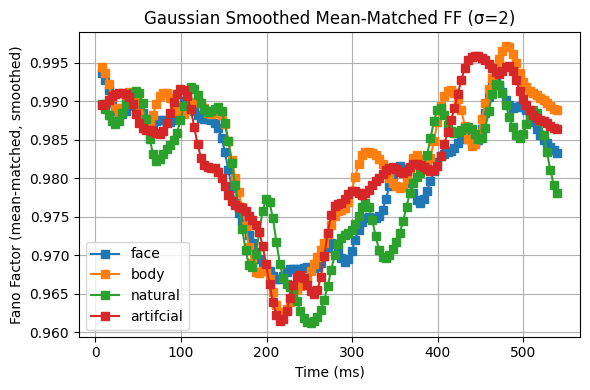

In [6]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
def load_per_neuron(mat_file):
    """
    Load per‐neuron spike trains and shared stimulus IDs.
    Returns:
      data_list: list of (n_trials, time) arrays
      stim_master: (n_trials,) array of stimulus IDs
    """
    with h5py.File(mat_file, 'r') as f:
        grp = f['SpikeTrain_it_all']
        ref_idxs    = np.array(f[grp['cm'][0,0]]['index']).flatten()
        stim_master = np.array([int(f[r][()][0]) for r in ref_idxs])
        data_list = []
        for i in range(grp['data'].shape[0]):
            arr = np.array(f[grp['data'][i,0]])
            if arr.shape[0] < arr.shape[1]:
                arr = arr.T
            data_list.append(arr)
    return data_list, stim_master
def build_population_dataset(data_list, stim_master, cats,
                             window_ms, step_ms,
                             start_ms, end_ms,
                             fs=1000):
    """
    Sliding‐window PSTH aligned across neurons.
    Returns:
      X: (n_samples, n_slices, n_neurons)
      y: (n_samples,)
      times: (n_slices,) centers in ms
    """
    n_neurons = len(data_list)
    unique_stims = np.unique(stim_master)
    starts = np.arange(start_ms, end_ms - window_ms + 1, step_ms)
    n_slices = len(starts)
    times    = starts + window_ms/2.0
    samples, labels = [], []
    for stim in unique_stims:
        idxs = np.where(stim_master == stim)[0]
        for r in idxs:
            resp = np.zeros((n_slices, n_neurons), dtype=float)
            for j, data in enumerate(data_list):
                trial = data[r]
                for k, t0 in enumerate(starts):
                    s0 = int(t0 * fs/1000)
                    s1 = int((t0 + window_ms) * fs/1000)
                    resp[k, j] = trial[s0:s1].sum()
            samples.append(resp)
            for lbl, (lo, hi) in enumerate(cats.values()):
                if lo <= stim <= hi:
                    labels.append(lbl)
                    break
    X = np.stack(samples, axis=0)
    y = np.array(labels, dtype=int)
    return X, y, times
def compute_fano(X):
    """
    Vectorized Fano computation.
    X: (n_samples, T, N)
    Returns:
      FF: (N, T)
      mean_counts: (N, T)
    """
    mean_counts = X.mean(axis=0)
    var_counts  = X.var(axis=0, ddof=1)
    with np.errstate(divide='ignore', invalid='ignore'):
        FF = var_counts / mean_counts
    return FF.T, mean_counts.T
def mean_match_ff(FF, mean_counts, n_quantiles=10, seed=0):
    """
    Control for mean‐rate differences across bins.
    FF, mean_counts: (N, T)
    Returns:
      FF_mm: (T,) mean‐matched Fano vs time
    """
    rng = np.random.RandomState(seed)
    N, T = FF.shape
    ref = mean_counts[:, 0]
    bins = np.quantile(ref, np.linspace(0,1,n_quantiles+1))
    hist_ref, _ = np.histogram(ref, bins=bins)
    FF_mm = np.full(T, np.nan)
    for k in range(T):
        vals = mean_counts[:, k]
        idxs = []
        for b in range(n_quantiles):
            candidates = np.where((vals >= bins[b]) & (vals < bins[b+1]))[0]
            if candidates.size:
                rng.shuffle(candidates)
                take = min(hist_ref[b], candidates.size)
                idxs.extend(candidates[:take])
        if idxs:
            FF_mm[k] = np.nanmean(FF[idxs, k])
    return FF_mm
if __name__ == '__main__':
    mat_file = 'dataVasati.mat'
    cats = {
        'face': (1, 200),
        'body':       (201, 320),
        'natural':    (321, 390),
        'artifcial':       (391, 500),
    }
    window_ms = 15
    step_ms   = 4
    start_ms, end_ms = 0, 550
    data_list, stim_master = load_per_neuron(mat_file)
    X, y, times = build_population_dataset(
        data_list, stim_master, cats,
        window_ms, step_ms,
        start_ms, end_ms
    )
    cat_names = list(cats.keys())
    n_slices = X.shape[1]
    FF_mean_all = np.zeros((len(cat_names), n_slices))
    FF_mm_all   = np.zeros((len(cat_names), n_slices))
    for i, cname in enumerate(cat_names):
        mask = (y == i)
        Xc = X[mask]
        FFc, mean_counts = compute_fano(Xc)
        FF_mean_all[i] = np.nanmean(FFc, axis=0)
        FF_mm_all[i]   = mean_match_ff(FFc, mean_counts, n_quantiles=10, seed=42)
    sigma = 2
    FF_mean_sm = gaussian_filter1d(FF_mean_all, sigma=sigma, axis=1)
    FF_mm_sm   = gaussian_filter1d(FF_mm_all,   sigma=sigma, axis=1)
    plt.figure(figsize=(6,4))
    for i, cname in enumerate(cat_names):
        plt.plot(times, FF_mean_sm[i], '-o', label=cname)
    plt.xlabel('Time (ms)')
    plt.ylabel('Fano Factor (smoothed)')
    plt.title(f'Gaussian Smoothed FF (σ={sigma})')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.figure(figsize=(6,4))
    for i, cname in enumerate(cat_names):
        plt.plot(times, FF_mm_sm[i], '-s', label=cname)
    plt.xlabel('Time (ms)')
    plt.ylabel('Fano Factor (mean-matched, smoothed)')
    plt.title(f'Gaussian Smoothed Mean-Matched FF (σ={sigma})')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

<h1 style="font-size:4em;">
SVM
</h1>

Max accuracy: 51.32% at 250.0 ms


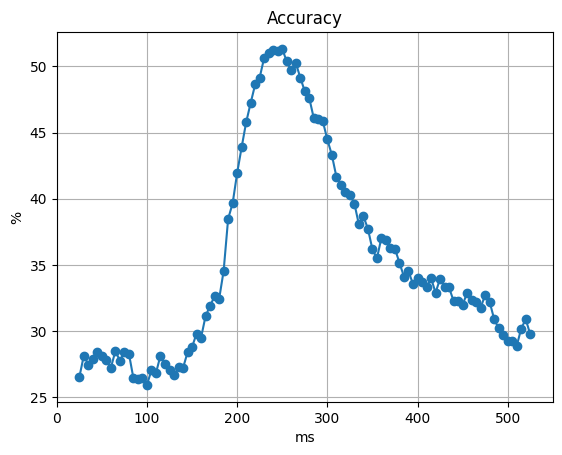

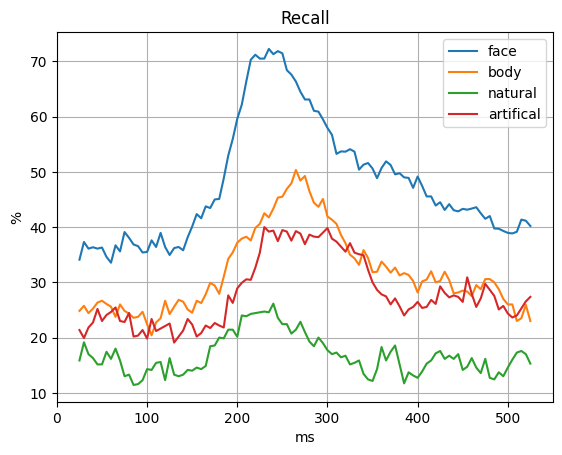

In [47]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.multiclass import OneVsOneClassifier
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from scipy.io import savemat
import warnings
from sklearn.model_selection import StratifiedKFold, cross_val_predict
warnings.filterwarnings('ignore')
def load_per_neuron(mat_file, start_ms=0, end_ms=550, fs=1000):
    """
    Returns:
      data_list: list of arrays (n_trials_j, n_time)
      stim_list: list of arrays (n_trials_j,) of stimulus codes
    """
    with h5py.File(mat_file, 'r') as mat:
        grp = mat['SpikeTrain_it_all']
        n_neurons = grp['data'].shape[0]
        data_list = []
        stim_list = []
        for i in range(n_neurons):
            idxs = np.array(mat[grp['cm'][i,0]]['index']).flatten()
            stim = np.array([int(mat[ref][()][0]) for ref in idxs])
            stim_list.append(stim)
            ds = grp['data'][i,0]
            arr = np.array(mat[ds])
            if arr.shape[0] != stim.size:
                arr = arr.T
            s0 = int(start_ms * fs / 1000)
            s1 = int(end_ms   * fs / 1000)
            arr = arr[:, s0:s1]
            data_list.append(arr)
    return data_list, stim_list
def compute_features_single(data, window_ms=50, step_ms=5, fs=1000):
    n_trials, n_time = data.shape
    win_pts = int(window_ms * fs / 1000)
    step_pts = int(step_ms   * fs / 1000)
    starts = np.arange(0, n_time - win_pts + 1, step_pts)
    n_slices = len(starts)
    feats = np.zeros((n_trials, n_slices))
    for idx, s0 in enumerate(starts):
        s1 = s0 + win_pts
        feats[:, idx] = data[:, s0:s1].sum(axis=1)
    times = starts / fs * 1000 + window_ms / 2
    return feats, times
def map_to_class(code):
    if 1 <= code <= 200:  return 0
    if 201 <= code <= 320: return 1
    if 321 <= code <= 390: return 2
    if 391 <= code <= 500: return 3
    return -1
def build_population_dataset(data_list, stim_list, cats):
    n_neurons = len(data_list)
    common = set(stim_list[0])
    for stim in stim_list[1:]:
        common &= set(stim)
    common = sorted(common)
    min_reps = {
        stim: min([np.sum(stim_list[j] == stim) for j in range(n_neurons)])
        for stim in common
    }
    feats_list = []
    times = None
    for j in range(n_neurons):
        feats_j, times = compute_features_single(data_list[j],
                                                 window_ms=list(cats.values())[0][2],
                                                 step_ms=list(cats.values())[0][3])
        feats_list.append(feats_j)
    n_slices = feats_list[0].shape[1]
    total_samples = sum(min_reps.values())
    X = np.zeros((total_samples, n_neurons, n_slices))
    y = np.zeros(total_samples, dtype=int)
    idx_sample = 0
    for stim in common:
        reps = min_reps[stim]
        cls = map_to_class(stim)
        for r in range(reps):
            for j in range(n_neurons):
                trials_j = np.where(stim_list[j] == stim)[0]
                t_idx = trials_j[r]
                X[idx_sample, j, :] = feats_list[j][t_idx]
            y[idx_sample] = cls
            idx_sample += 1
    return X, y, times
def classify_over_time(X, y):
    n_slices = X.shape[2]
    accuracy = np.zeros(n_slices)
    recall = np.zeros((4, n_slices))
    scaler = StandardScaler()
    for ts in range(n_slices):
        Xi = X[:, :, ts]
        Xi = scaler.fit_transform(Xi)
        clf = OneVsOneClassifier(SVC(kernel='rbf', C=1.0, gamma='scale', class_weight='balanced'))
        cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
        y_pred = cross_val_predict(clf, Xi, y, cv=cv, n_jobs=-1)
        accuracy[ts] = np.mean(y_pred == y) * 100
        cm = confusion_matrix(y, y_pred, labels=[0,1,2,3])
        recall[:, ts] = np.diag(cm) / np.sum(cm, axis=1) * 100
    return accuracy, recall
if __name__ == '__main__':
    mat_file = 'dataVasati.mat'
    cats = {
        'face': (1, 200, 50, 5),
        'body':       (201,320, 50, 5),
        'natural':    (321,390, 50, 5),
        'artifical':       (391,500, 50, 5)
    }
    data_list, stim_list = load_per_neuron(mat_file)
    X, y, times = build_population_dataset(data_list, stim_list, cats)
    accuracy, recall = classify_over_time(X, y)
    plt.figure(); plt.plot(times, accuracy, '-o'); plt.title('Accuracy'); plt.xlabel('ms'); plt.ylabel('%'); plt.grid(True)
    plt.figure();
    for i, name in enumerate(cats.keys()): plt.plot(times, recall[i], label=name)
    plt.title('Recall'); plt.xlabel('ms'); plt.ylabel('%'); plt.legend(); plt.grid(True)
    savemat('pop_results.mat', {'times': times, 'accuracy': accuracy, 'recall': recall})
    print(f"Max accuracy: {accuracy.max():.2f}% at {times[np.argmax(accuracy)]:.1f} ms")

<h1 style="font-size:4em;">
TIME-TIME DECODING
</h1>

… loading dataVasati.mat
  loaded 92 neurons, epoch 100-450 ms
  500 common stimuli, min repetition = 10
  PSTH from 50 ms → 450.0 ms, bins = 49
  feature matrix X shape = (500, 92, 49)


Permuting: 100%|██████████| 500/500 [39:04<00:00,  4.69s/it]


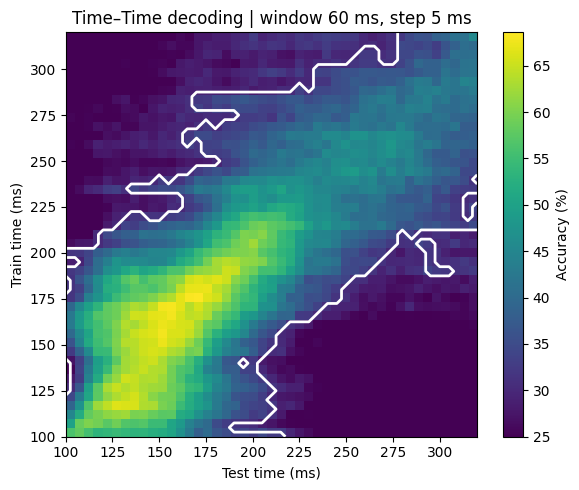

Done.


In [3]:
"""
Population-based temporal-generalization (Time–Time decoding)
– پنجره PSTH : 60 ms
– گام        : 5 ms     ← از 50 ms تا 450 ms
– هر «تصویر» ( stimulus code ) 10 بار ارائه شده؛
  ابتدا در هر نورون روی آن 10 trial میانگین می‌گیریم تا یک بردار PSTH
  برای همان تصویر بسازیم، سپس با SVM خطی برچسب کلاس را پیش‌بینی می‌کنیم.
– 5-fold stratified CV
– 500 permutation + cluster-based correction
– خروجی MAT : pop_TTdecoding_60ms_step5_from100.mat
"""
import h5py, numpy as np, matplotlib.pyplot as plt
from sklearn.svm import LinearSVC
from sklearn.multiclass import OneVsOneClassifier
from sklearn.model_selection import StratifiedKFold
from joblib import Parallel, delayed, parallel_backend
from scipy.ndimage import label
from tqdm import tqdm
from scipy.io import savemat
MAT_FILE    = 'dataVasati.mat'
EPOCH_START_MS, EPOCH_END_MS = 100, 450  
FS          = 1000
WIN_MS , STEP_MS  = 60 , 5
PSTH_START_MS = 50
CV_FOLDS    = 5
N_PERM      = 500
CHANCE_ACC  = 25.0
def map_cls(code: int) -> int:
    if   1 <= code <= 200:   return 0
    elif 201 <= code <= 320: return 1
    elif 321 <= code <= 390: return 2
    elif 391 <= code <= 500: return 3
    return -1
def cluster_perm(obs, null, alpha=0.05, chance=CHANCE_ACC):
    diff_obs  = obs  - chance
    diff_null = null - chance
    thr = np.percentile(diff_null.ravel(), 100 * (1 - alpha))
    supra, n  = label(diff_obs > thr, structure=np.ones((3, 3)))
    masses = [diff_obs[supra == i].sum() for i in range(1, n + 1)]
    maxnull = []
    for m in diff_null:
        s2, n2 = label(m > thr, structure=np.ones((3, 3)))
        maxnull.append(max([m[s2 == i].sum() for i in range(1, n2 + 1)] or [0]))
    crit = np.percentile(maxnull, 100 * (1 - alpha))
    sig  = np.zeros_like(obs, bool)
    for i, mass in enumerate(masses, 1):
        if mass > crit:
            sig[supra == i] = True
    return sig
print('… loading', MAT_FILE)
dataN, stimN = [], []
with h5py.File(MAT_FILE, 'r') as f:
    grp = f['SpikeTrain_it_all']
    N_neu = grp['data'].shape[0]
    e0 = int(EPOCH_START_MS * FS / 1000)
    e1 = int(EPOCH_END_MS   * FS / 1000)
    for i in range(N_neu):
        cm = grp['cm'][i,0]
        if isinstance(f[cm], h5py.Dataset):
            stims_i = np.asarray(f[cm]).astype(int).flatten()
        else:
            refs = np.asarray(f[cm]['index']).flatten()
            stims_i = np.array([int(f[r][()][0]) for r in refs])
        stimN.append(stims_i)
        arr = np.asarray(f[grp['data'][i,0]])
        if arr.shape[0] != stims_i.size:
            arr = arr.T
        dataN.append(arr[:, e0:e1])
print(f'  loaded {N_neu} neurons, epoch {EPOCH_START_MS}-{EPOCH_END_MS} ms')
images = set(stimN[0])
for st in stimN[1:]:
    images &= set(st)
images = sorted(images)
min_rep = min((sl==img).sum() for sl in stimN for img in images)
print(f'  {len(images)} common stimuli, min repetition = {min_rep}')
win_pts  = int(WIN_MS  * FS/1000)
step_pts = int(STEP_MS * FS/1000)
psths0   = int(PSTH_START_MS * FS/1000)
n_time   = dataN[0].shape[1]
bins_idx = np.arange(psths0, n_time - win_pts + 1, step_pts)
times    = bins_idx / FS * 1000 + WIN_MS/2
n_bins   = bins_idx.size
print(f'  PSTH from {PSTH_START_MS} ms → {n_time/FS*1000 + EPOCH_START_MS} ms, bins = {n_bins}')
N_img = len(images)
X = np.zeros((N_img, N_neu, n_bins))
y = np.zeros(N_img, int)
for k, img in enumerate(images):
    y[k] = map_cls(img)
    for n in range(N_neu):
        trials = dataN[n]
        stims   = stimN[n]
        idxs    = np.where(stims==img)[0][:min_rep]
        psth_avg = trials[idxs].mean(axis=0)
        for b, start in enumerate(bins_idx):
            X[k, n, b] = psth_avg[start:start+win_pts].sum()
print('  feature matrix X shape =', X.shape)
cv = list(StratifiedKFold(CV_FOLDS, shuffle=True, random_state=0)
          .split(np.zeros(N_img), y))
def decode_train_bin(b):
    acc = np.zeros(n_bins)
    for tr, te in cv:
        clf = OneVsOneClassifier(
            LinearSVC(dual=False, C=1.0, class_weight='balanced', max_iter=5000)
        )
        clf.fit(X[tr, :, b], y[tr])
        flat = X[te].transpose(2,0,1).reshape(n_bins * len(te), N_neu)
        pr   = clf.predict(flat).reshape(n_bins, len(te))
        acc += (pr == y[te]).mean(axis=1)
    return acc / len(cv) * 100
with parallel_backend('threading'):
    dec_mat = np.vstack(Parallel(n_jobs=-1)(
        delayed(decode_train_bin)(b) for b in range(n_bins)
    ))
null = np.zeros((N_PERM, n_bins, n_bins))
rng  = np.random.RandomState(0)
def decode_perm(y_perm, b):
    acc = np.zeros(n_bins)
    for tr, te in cv:
        clf = OneVsOneClassifier(
            LinearSVC(dual=False, C=1.0, class_weight='balanced', max_iter=5000)
        )
        clf.fit(X[tr, :, b], y_perm[tr])
        flat = X[te].transpose(2,0,1).reshape(n_bins * len(te), N_neu)
        pr   = clf.predict(flat).reshape(n_bins, len(te))
        acc += (pr == y_perm[te]).mean(axis=1)
    return acc / len(cv) * 100
for p in tqdm(range(N_PERM), desc='Permuting'):
    yp = rng.permutation(y)
    null[p] = Parallel(n_jobs=-1, backend='threading')(
        delayed(decode_perm)(yp, b) for b in range(n_bins)
    )
sig = cluster_perm(dec_mat, null, alpha=0.05, chance=CHANCE_ACC)
i0 = np.searchsorted(times, 100)
times_plot = times[i0:]
dec_plot   = dec_mat[i0:, i0:]
sig_plot   = sig[i0:, i0:]
plt.figure(figsize=(6,5))
im = plt.imshow(dec_plot, origin='lower', aspect='auto',
           extent=[times_plot[0], times_plot[-1],
                   times_plot[0], times_plot[-1]],
           vmin=CHANCE_ACC, vmax=dec_mat.max(), cmap='viridis')
plt.colorbar(im, label='Accuracy (%)')
plt.contour(times_plot, times_plot, sig_plot, levels=[0.5],
            colors='white', linewidths=2)
plt.xlabel('Test time (ms)')
plt.ylabel('Train time (ms)')
plt.title(f'Time–Time decoding | window {WIN_MS} ms, step {STEP_MS} ms')
plt.tight_layout()
plt.show()
savemat('pop_TTdecoding_60ms_step5_from100.mat',
        dict(times=times_plot, decoding=dec_plot, sig=sig_plot))
print('Done.')

<h1 style="font-size:4em;">
MUTUAL INFORMATION
</h1>

Dataset: 5000 trials, 92 neurons, 51 bins


Permuting: 100%|██████████| 1000/1000 [09:00<00:00,  1.85it/s]


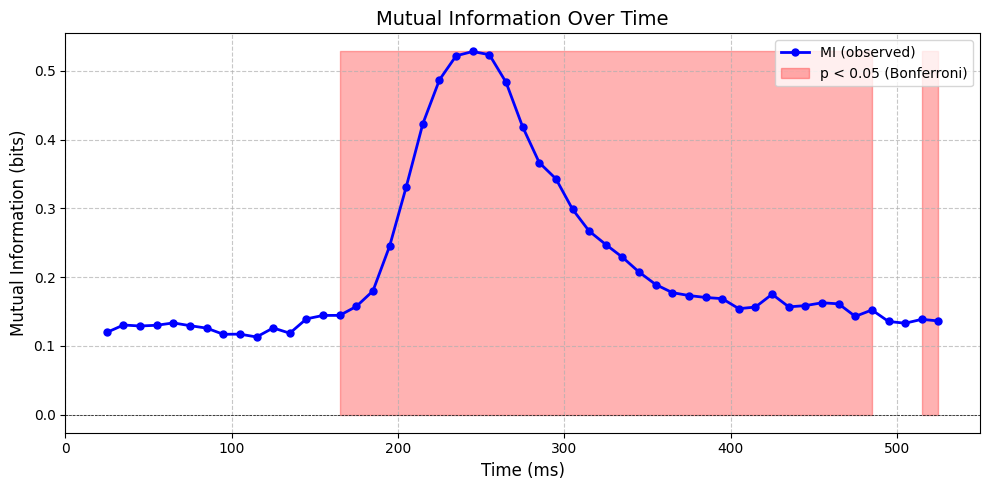

Results saved to 'mi_results.mat'
Significant time bins (p < 0.000980): [165. 175. 185. 195. 205. 215. 225. 235. 245. 255. 265. 275. 285. 295.
 305. 315. 325. 335. 345. 355. 365. 375. 385. 395. 405. 415. 425. 435.
 445. 455. 465. 475. 485. 515. 525.]


In [41]:
"""
Mutual Information Analysis Across Time with Permutation Test and Bonferroni Correction
--------------------------------------------------------------------------------
Dataset: dataVasati.mat (SpikeTrain_it_all)
PSTH Window = 50 ms, Step = 10 ms (overlapping)
Number of Permutations = 1000
Each neuron has its own trial labels (stimulus codes). We first organize data by stimulus.
"""
import h5py
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_classif
from joblib import Parallel, delayed
from tqdm import tqdm
from scipy.io import savemat
MAT_FILE = "dataVasati.mat"
START_MS = 0
END_MS   = 550
FS       = 1000
WIN_MS   = 50
STEP_MS  = 10
OVERLAP  = True
N_PERMS  = 1000
ALPHA    = 0.05
N_JOBS   = -1
if not OVERLAP:
    STEP_MS = WIN_MS
def map_to_class(code):
    """Map stimulus code to class (0-3)."""
    if 1 <= code <= 200: return 0
    elif 201 <= code <= 320: return 1
    elif 321 <= code <= 390: return 2
    elif 391 <= code <= 500: return 3
    return -1
def load_data(mat_file, start_ms, end_ms, fs=1000):
    """Load spike train data and stimulus codes from .mat file."""
    try:
        with h5py.File(mat_file, 'r') as mat:
            if 'SpikeTrain_it_all' not in mat:
                raise KeyError("Dataset 'SpikeTrain_it_all' not found.")
            grp = mat['SpikeTrain_it_all']
            s0, s1 = int(start_ms * fs / 1000), int(end_ms * fs / 1000)
            if s1 <= s0:
                raise ValueError(f"End time ({end_ms} ms) must exceed start time ({start_ms} ms).")
            data_list, stim_list = [], []
            for i in range(grp['data'].shape[0]):
                arr = np.array(mat[grp['data'][i,0]])
                refs = np.array(mat[grp['cm'][i,0]]['index']).flatten()
                stim = np.array([int(mat[r][()][0]) for r in refs])
                if arr.ndim == 1: arr = arr.reshape(1, -1)
                if arr.shape[0] != stim.size: arr = arr.T
                if arr.shape[0] != stim.size:
                    raise ValueError(f"Shape mismatch for neuron {i}: expected {stim.size} trials.")
                data_list.append(arr[:, s0:s1])
                stim_list.append(stim)
            return data_list, stim_list
    except Exception as e:
        raise RuntimeError(f"Failed to load data from {mat_file}: {str(e)}")
def compute_psth(data, win_ms, step_ms, fs):
    """Compute PSTH for each trial (discrete spike counts)."""
    n_trials, n_time = data.shape
    win_pts = int(win_ms * fs / 1000)
    step_pts = int(step_ms * fs / 1000)
    if win_pts <= 0 or step_pts <= 0:
        raise ValueError("Window and step sizes must be positive.")
    starts = np.arange(0, n_time - win_pts + 1, step_pts)
    feats = np.zeros((n_trials, len(starts)), dtype=int)
    for ki, s in enumerate(starts):
        feats[:, ki] = data[:, s:s + win_pts].sum(axis=1)
    times = starts / fs * 1000 + win_ms / 2
    return feats, times
def build_dataset(data_list, stim_list, win_ms, step_ms, fs):
    """Construct dataset by organizing trials based on stimulus codes."""
    if not data_list or not stim_list or len(data_list) != len(stim_list):
        raise ValueError("Data and stimulus lists must be non-empty and equal in length.")
    n_neu = len(data_list)
    n_bins = int((END_MS - START_MS - WIN_MS) / STEP_MS) + 1
    if n_bins <= 0:
        raise ValueError("Invalid number of bins. Check time parameters.")
    all_stim = set()
    for stim in stim_list:
        all_stim.update(stim)
    all_stim = sorted(all_stim)
    trials_per_stim = {s: [] for s in all_stim}
    for j in range(n_neu):
        stim = stim_list[j]
        data = data_list[j]
        for s in all_stim:
            indices = np.where(stim == s)[0]
            trials_per_stim[s].append((j, indices))
    min_trials = {}
    for s in all_stim:
        trial_counts = [len(indices) for _, indices in trials_per_stim[s]]
        if all(count > 0 for count in trial_counts):
            min_trials[s] = min(trial_counts)
        else:
            min_trials[s] = 0
    total_trials = sum(min_trials[s] for s in all_stim if min_trials[s] > 0)
    if total_trials == 0:
        raise ValueError("No stimuli are present in all neurons with at least one trial.")
    X = np.zeros((total_trials, n_neu, n_bins), dtype=int)
    y = np.zeros(total_trials, dtype=int)
    trial_idx = 0
    times = None
    for s in all_stim:
        if min_trials[s] == 0:
            continue
        cls = map_to_class(s)
        if cls == -1:
            continue
        for t in range(min_trials[s]):
            for j in range(n_neu):
                neuron_idx, indices = trials_per_stim[s][j]
                trial_data = data_list[neuron_idx][indices[t], :]
                feats, times = compute_psth(trial_data[np.newaxis, :], win_ms, step_ms, fs)
                if feats.shape[1] != n_bins:
                    raise ValueError(f"Bin count mismatch for neuron {j}: expected {n_bins}, got {feats.shape[1]}.")
                X[trial_idx, j, :] = feats[0, :]
            y[trial_idx] = cls
            trial_idx += 1
    if trial_idx == 0:
        raise ValueError("No valid trials found after processing stimuli.")
    return X[:trial_idx], y[:trial_idx], times
def mi_sum(Xb, y):
    """Compute MI for the neuron population in a time bin (discrete)."""
    return mutual_info_classif(Xb, y, discrete_features=True, random_state=0).sum()
def perm_mi(seed, X, y, n_bins):
    """Compute MI for permuted data."""
    rng = np.random.RandomState(seed)
    y_perm = rng.permutation(y)
    out = np.zeros(n_bins)
    for b in range(n_bins):
        out[b] = mi_sum(X[:, :, b], y_perm)
    return out
if __name__ == "__main__":
    try:
        data_list, stim_list = load_data(MAT_FILE, START_MS, END_MS, FS)
    except Exception as e:
        print(f"Error loading data: {e}")
        exit(1)
    try:
        X, y, times = build_dataset(data_list, stim_list, WIN_MS, STEP_MS, FS)
        n_bins = X.shape[2]
        print(f"Dataset: {X.shape[0]} trials, {X.shape[1]} neurons, {n_bins} bins")
    except Exception as e:
        print(f"Error building dataset: {e}")
        exit(1)
    try:
        obs_mi = np.array([mi_sum(X[:, :, b], y) for b in range(n_bins)])
    except Exception as e:
        print(f"Error computing observed MI: {e}")
        exit(1)
    try:
        null = np.stack(Parallel(n_jobs=N_JOBS)(
            delayed(perm_mi)(seed, X, y, n_bins) for seed in tqdm(range(N_PERMS), desc="Permuting")
        ), axis=0)
    except Exception as e:
        print(f"Error during permutation test: {e}")
        exit(1)
    pvals = np.mean(null >= obs_mi[None, :], axis=0)
    alpha_bonf = ALPHA / n_bins
    sig = pvals < alpha_bonf
    plt.figure(figsize=(10, 5))
    plt.plot(times, obs_mi, '-o', lw=2, markersize=5, label="MI (observed)", color='blue')
    plt.axhline(0, color='k', lw=0.5, linestyle='--')
    plt.fill_between(times, 0, obs_mi.max(), where=sig, color='red', alpha=0.3,
                     label=f"p < {ALPHA:.2f} (Bonferroni)")
    plt.xlabel("Time (ms)", fontsize=12)
    plt.ylabel("Mutual Information (bits)", fontsize=12)
    plt.title("Mutual Information Over Time", fontsize=14)
    plt.legend(fontsize=10)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    try:
        savemat("mi_results.mat", {
            "times": times,
            "obs_mi": obs_mi,
            "null": null,
            "pvals": pvals,
            "sig": sig
        })
        print("Results saved to 'mi_results.mat'")
    except Exception as e:
        print(f"Error saving results: {e}")
    if sig.any():
        print(f"Significant time bins (p < {alpha_bonf:.6f}): {times[sig]}")
    else:
        print("No significant time bins found.")

<h1 style="font-size:4em;">
D-PRIME
</h1>

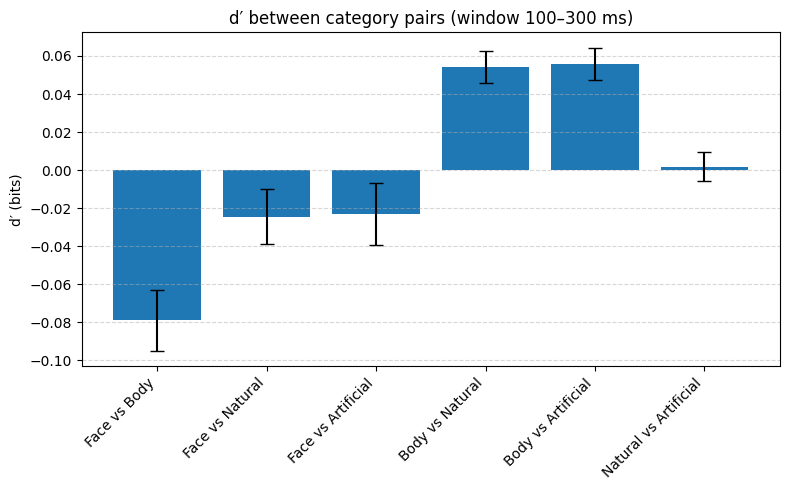

In [51]:
"""
Compute and plot d-prime between category pairs
– Spike counts in 100–300 ms post-stimulus window
– Categories: Face, Body, Natural, Artificial
– d′ = (μ₁−μ₂) / sqrt(½(σ₁²+σ₂²))
– Bar plot of mean ± SEM across neurons
"""
import h5py
import numpy as np
import matplotlib.pyplot as plt
import itertools
MAT_FILE  = 'dataVasati.mat'
START_MS  =   0
END_MS    = 550
FS        = 1000
WIN_START = 100
WIN_END   = 300
def map_cat(code):
    if 1 <= code <= 200:   return 'Face'
    if 201 <= code <= 320: return 'Body'
    if 321 <= code <= 390: return 'Natural'
    if 391 <= code <= 500: return 'Artificial'
    return None
def load_per_neuron(mat_file, start_ms=0, end_ms=550, fs=1000):
    with h5py.File(mat_file,'r') as f:
        grp = f['SpikeTrain_it_all']
        data_list, stim_list = [], []
        for i in range(grp['data'].shape[0]):
            refs = np.array(f[grp['cm'][i,0]]['index']).flatten()
            stim = np.array([int(f[r][()][0]) for r in refs])
            stim_list.append(stim)
            arr = np.array(f[grp['data'][i,0]])
            if arr.ndim==1: arr = arr[None,:]
            if arr.shape[0] != stim.size: arr = arr.T
            s0 = int(start_ms * fs/1000)
            s1 = int(end_ms   * fs/1000)
            data_list.append(arr[:, s0:s1])
    return data_list, stim_list
data_list, stim_list = load_per_neuron(MAT_FILE, START_MS, END_MS, FS)
n_neurons = len(data_list)
cats = ['Face','Body','Natural','Artificial']
pairs = list(itertools.combinations(cats,2))
dprime = np.zeros((n_neurons, len(pairs)))
w0 = WIN_START  - START_MS
w1 = WIN_END    - START_MS
for i in range(n_neurons):
    data = data_list[i]
    stim = stim_list[i]
    counts = data[:, w0:w1].sum(axis=1)
    grp_counts = {cat: counts[np.array([map_cat(s)==cat for s in stim])]
                  for cat in cats}
    for j,(c1,c2) in enumerate(pairs):
        x1 = grp_counts[c1]
        x2 = grp_counts[c2]
        if x1.size<2 or x2.size<2:
            dprime[i,j] = np.nan
            continue
        mu1, mu2 = x1.mean(), x2.mean()
        s1, s2   = x1.std(ddof=1), x2.std(ddof=1)
        denom    = np.sqrt(0.5*(s1**2 + s2**2))
        dprime[i,j] = (mu1 - mu2)/denom if denom>0 else 0
mean_dp = np.nanmean(dprime, axis=0)
sem_dp  = np.nanstd(dprime, axis=0, ddof=1)/np.sqrt(np.sum(~np.isnan(dprime),axis=0))
plt.figure(figsize=(8,5))
x = np.arange(len(pairs))
labels = [f'{a} vs {b}' for a,b in pairs]
plt.bar(x, mean_dp, yerr=sem_dp, capsize=5, color='C0')
plt.xticks(x, labels, rotation=45, ha='right')
plt.ylabel("d′ (bits)")
plt.title(f"d′ between category pairs (window {WIN_START}–{WIN_END} ms)")
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.show()

<h1 style="font-size:4em;">
RDM KENDALL
</h1>

RDM & τ: 100%|██████████| 101/101 [01:17<00:00,  1.30it/s]


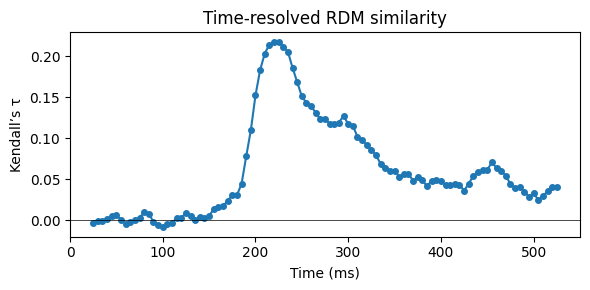

In [3]:
"""
Time‐resolved RDM analysis with Kendall’s tau
"""
import h5py
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import kendalltau
from tqdm import tqdm
MAT_FILE   = "dataVasati.mat"
START_MS   =   0
END_MS     = 550
FS         = 1000
WIN_MS     =  50
STEP_MS    =   5
def map_to_class(code):
    if   1 <= code <= 200: return 0
    elif 201 <= code <= 320: return 1
    elif 321 <= code <= 390: return 2
    elif 391 <= code <= 500: return 3
    else: return -1
def compute_psth_single(arr, win_ms, step_ms, fs):
    """Sliding‐window spike counts: (n_trials, n_bins), times (n_bins,)"""
    n_trials, n_time = arr.shape
    win_pts  = int(win_ms  * fs/1000)
    step_pts = int(step_ms * fs/1000)
    starts   = np.arange(0, n_time-win_pts+1, step_pts)
    feats    = np.zeros((n_trials, len(starts)), float)
    for i,s in enumerate(starts):
        feats[:,i] = arr[:, s:s+win_pts].sum(axis=1)
    times = starts/fs*1000 + win_ms/2
    return feats, times
data_list, stim_list = [], []
with h5py.File(MAT_FILE,'r') as f:
    grp = f['SpikeTrain_it_all']
    for i in range(grp['data'].shape[0]):
        refs  = np.array(f[grp['cm'][i,0]]['index']).flatten()
        stim  = np.array([int(f[r][()][0]) for r in refs])
        stim_list.append(stim)
        arr   = np.array(f[grp['data'][i,0]])
        if arr.ndim==1: arr = arr.reshape(1,-1)
        if arr.shape[0]!=stim.size: arr = arr.T
        s0 = int(START_MS*FS/1000)
        s1 = int(END_MS  *FS/1000)
        data_list.append(arr[:, s0:s1])
n_neu = len(data_list)
feats_list, times = [], None
for arr in data_list:
    f, t = compute_psth_single(arr, WIN_MS, STEP_MS, FS)
    feats_list.append(f)
    times = t
n_bins   = feats_list[0].shape[1]
common = set(stim_list[0])
for sl in stim_list[1:]:
    common &= set(sl)
common = sorted(common)
S = len(common)
labels = np.array([map_to_class(s) for s in common])
gt = np.zeros((S,S), int)
for i in range(S):
    for j in range(S):
        gt[i,j] = 0 if labels[i]==labels[j] else 1
triu_idx = np.triu_indices(S, k=1)
gt_flat  = gt[triu_idx]
taus = np.zeros(n_bins)
ps   = np.zeros(n_bins)
for b in tqdm(range(n_bins), desc="RDM & τ"):
    patt = np.zeros((S, n_neu), float)
    for i, s in enumerate(common):
        for j in range(n_neu):
            idxs = np.where(stim_list[j]==s)[0]
            patt[i,j] = feats_list[j][idxs, b].mean()
    corr = np.corrcoef(patt)
    rdm  = 1 - corr
    neu_flat = rdm[triu_idx]
    tau, p   = kendalltau(neu_flat, gt_flat)
    taus[b]  = tau
    ps[b]    = p
plt.figure(figsize=(6,3))
plt.plot(times, taus, '-o', markersize=4)
plt.axhline(0, color='k', linewidth=0.5)
plt.xlabel("Time (ms)")
plt.ylabel("Kendall’s τ")
plt.title("Time‐resolved RDM similarity")
plt.tight_layout()
plt.show()
np.savez("rdm_time_course.npz",
         times=times, tau=taus, pval=ps)

<h1 style="font-size:4em;">
RDM VS GROUND TRUTH
</h1>

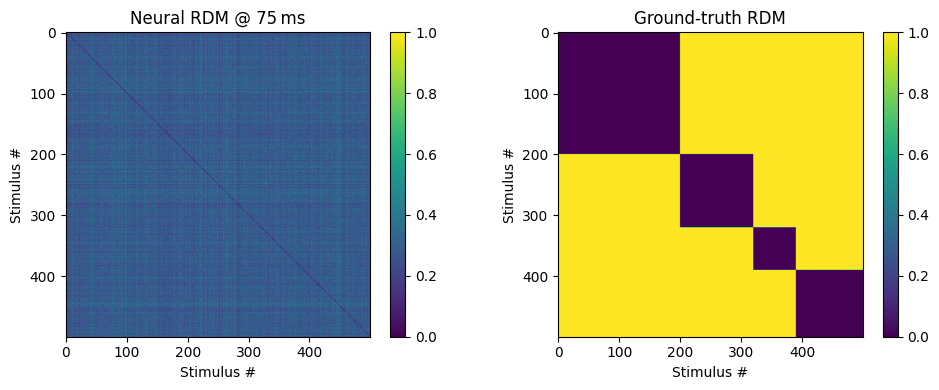

In [5]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist, squareform
MAT_FILE = 'dataVasati.mat'
START_MS = 0
END_MS   = 550
FS       = 1000
WIN_MS, STEP_MS = 50, 5
def map_to_class(code):
    if 1 <= code <= 200:   return 0
    if 201 <= code <= 320: return 1
    if 321 <= code <= 390: return 2
    if 391 <= code <= 500: return 3
    return -1
def compute_psth_single(arr, win_ms, step_ms, fs):
    n_trials, n_time = arr.shape
    win   = int(win_ms  * fs/1000)
    step  = int(step_ms * fs/1000)
    starts = np.arange(0, n_time - win + 1, step)
    feats = np.zeros((n_trials, len(starts)))
    for j, s0 in enumerate(starts):
        feats[:, j] = arr[:, s0:s0+win].sum(axis=1)
    times = starts/fs*1000 + win_ms/2
    return feats, times
data_list, stim_list = [], []
with h5py.File(MAT_FILE,'r') as f:
    grp = f['SpikeTrain_it_all']
    for i in range(grp['data'].shape[0]):
        arr = np.array(f[grp['data'][i,0]])
        refs   = np.array(f[grp['cm'][i,0]]['index']).flatten()
        stim_i = np.array([int(f[r][()][0]) for r in refs])
        if arr.ndim==1: arr = arr.reshape(1,-1)
        if arr.shape[0] != stim_i.size: arr = arr.T
        s0, s1 = int(START_MS*FS/1000), int(END_MS*FS/1000)
        data_list.append(arr[:, s0:s1])
        stim_list .append(stim_i)
n_neu = len(data_list)
psth_list = []
for arr in data_list:
    feats, times = compute_psth_single(arr, WIN_MS, STEP_MS, FS)
    psth_list.append(feats)
n_bins   = psth_list[0].shape[1]
common = set(stim_list[0])
for sl in stim_list[1:]:
    common &= set(sl)
common = sorted(common)
n_stim  = len(common)
min_rep = min((sl==s).sum() for sl in stim_list for s in common)
w = 10
patterns = np.zeros((n_stim, n_neu), float)
for i_s, stim in enumerate(common):
    vals = []
    for j in range(n_neu):
        trials_idx = np.where(stim_list[j] == stim)[0][:min_rep]
        vals.append(psth_list[j][trials_idx, w].mean())
    patterns[i_s] = vals
def one_minus_corr(u,v):
    return 1 - np.corrcoef(u,v)[0,1]
rdm_neural = squareform(pdist(patterns, metric=one_minus_corr))
classes = np.array([map_to_class(s) for s in common])
gt_rdm = (classes[:,None] != classes[None,:]).astype(float)
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(10,4))
im1 = ax1.imshow(rdm_neural, vmin=0, vmax=1, cmap='viridis')
ax1.set_title(f'Neural RDM @ {times[w]:.0f} ms')
fig.colorbar(im1, ax=ax1, fraction=0.046)
im2 = ax2.imshow(gt_rdm, vmin=0, vmax=1, cmap='viridis')
ax2.set_title('Ground‐truth RDM')
fig.colorbar(im2, ax=ax2, fraction=0.046)
for ax in (ax1,ax2):
    ax.set_xlabel('Stimulus
    ax.set_ylabel('Stimulus
plt.tight_layout()
plt.show()

<h1 style="font-size:4em;">
MORE RDM
</h1>

C:\Users\ExoGame\AppData\Local\Temp\ipykernel_48556\710819958.py:92: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.03, 1, 0.95])


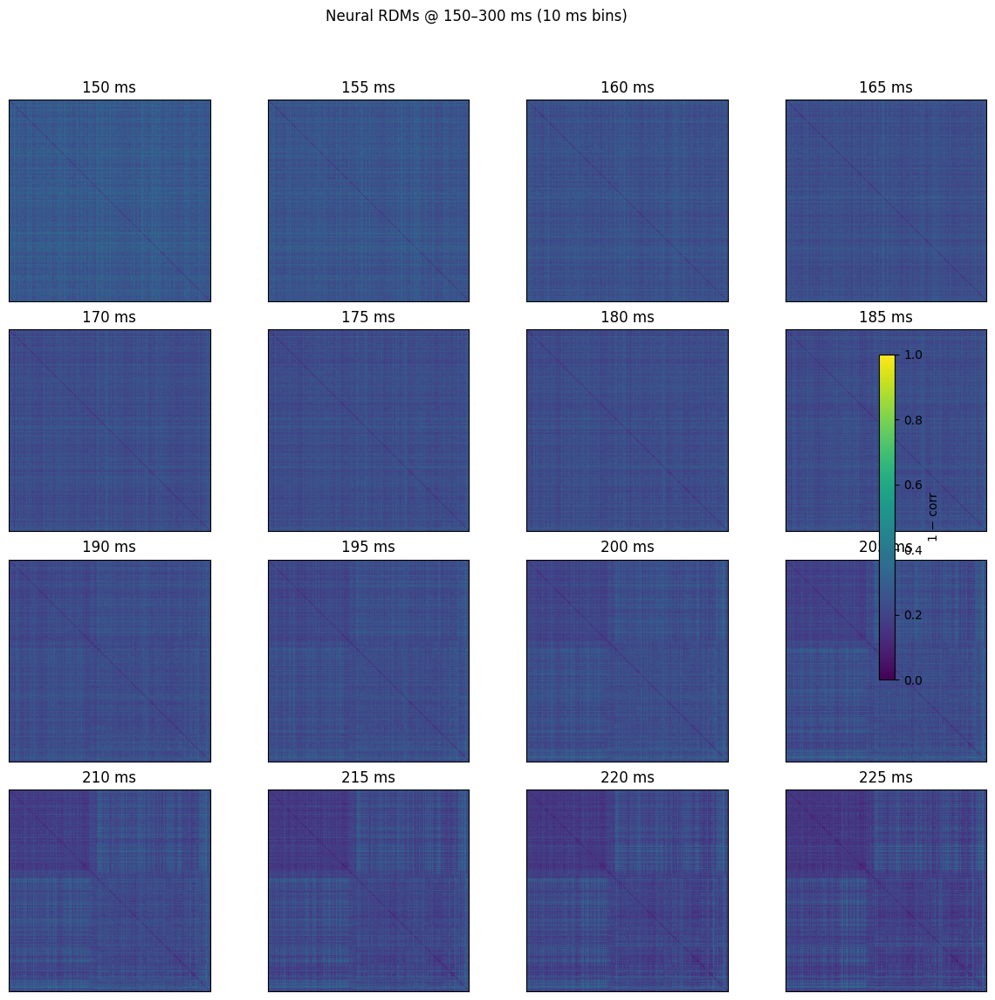

In [1]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist, squareform
MAT_FILE  = 'dataVasati.mat'
START_MS  = 0
END_MS    = 550
FS        = 1000
WIN_MS, STEP_MS = 50, 5
def compute_psth_single(arr, win_ms, step_ms, fs):
    n_trials, n_time = arr.shape
    win   = int(win_ms  * fs/1000)
    step  = int(step_ms * fs/1000)
    starts = np.arange(0, n_time - win + 1, step)
    feats = np.zeros((n_trials, len(starts)))
    for j, s0 in enumerate(starts):
        feats[:, j] = arr[:, s0:s0+win].sum(axis=1)
    times = starts/fs*1000 + win_ms/2
    return feats, times
data_list, stim_list = [], []
with h5py.File(MAT_FILE,'r') as f:
    grp = f['SpikeTrain_it_all']
    for i in range(grp['data'].shape[0]):
        arr = np.array(f[grp['data'][i,0]])
        refs   = np.array(f[grp['cm'][i,0]]['index']).flatten()
        stim_i = np.array([int(f[r][()][0]) for r in refs])
        if arr.ndim == 1:
            arr = arr.reshape(1, -1)
        if arr.shape[0] != stim_i.size:
            arr = arr.T
        s0, s1 = int(START_MS*FS/1000), int(END_MS*FS/1000)
        data_list.append(arr[:, s0:s1])
        stim_list .append(stim_i)
n_neu = len(data_list)
psth_list = []
for arr in data_list:
    feats, times = compute_psth_single(arr, WIN_MS, STEP_MS, FS)
    psth_list.append(feats)
common = set(stim_list[0])
for sl in stim_list[1:]:
    common &= set(sl)
common = sorted(common)
n_stim  = len(common)
min_rep = min((sl == s).sum() for sl in stim_list for s in common)
w_inds = [i for i, t in enumerate(times) if 150 <= t <= 300 and ((t - 150) % 5 == 0)]
selected_times = times[w_inds]
fig, axes = plt.subplots(4, 4, figsize=(12, 12))
axes = axes.flatten()
for ax, w in zip(axes, w_inds):
    patterns = np.zeros((n_stim, n_neu))
    for i_s, stim in enumerate(common):
        vals = []
        for j in range(n_neu):
            trials_idx = np.where(stim_list[j] == stim)[0][:min_rep]
            vals.append(psth_list[j][trials_idx, w].mean())
        patterns[i_s] = vals
    def one_minus_corr(u, v):
        return 1 - np.corrcoef(u, v)[0,1]
    rdm = squareform(pdist(patterns, metric=one_minus_corr))
    im = ax.imshow(rdm, vmin=0, vmax=1, cmap='viridis')
    ax.set_title(f'{selected_times[w_inds.index(w)]:.0f} ms')
    ax.set_xticks([])
    ax.set_yticks([])
cbar = fig.colorbar(im, ax=axes, fraction=0.02, pad=0.01)
cbar.set_label('1 − corr')
plt.suptitle('Neural RDMs @ 150–300 ms (10 ms bins)')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

<h1 style="font-size:4em;">
Phase-Amplitude Coupling (PAC) and Spectrum Analysis
</h1>

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension



Session 0: n_samples = 900, n_trials = 818, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.01027992 -0.01444011 -0.01442457 -0.01188247 -0.00961566 -0.00846168
 -0.00730894 -0.0053874  -0.00334175 -0.00205593]
  Face: avg_sig sample values after detrend: [-0.01168979 -0.01584726 -0.01582901 -0.01328418 -0.01101465 -0.00985795
 -0.00870249 -0.00677823 -0.00472986 -0.00344133]
  Face: Calculated PAC (MI and Canolty)


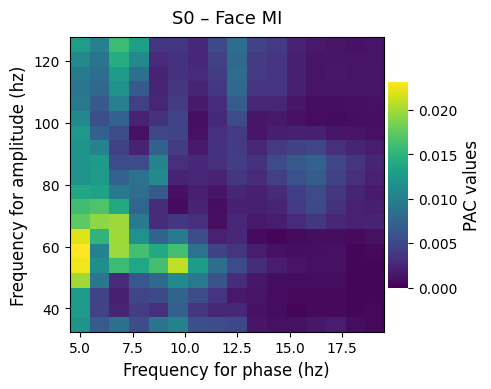

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


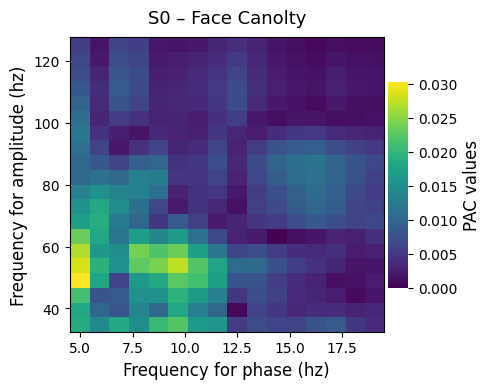

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [1.47147848e-07 2.52183965e-08 5.25930595e-06 6.11605505e-05
 1.11820425e-04 1.03683749e-05 1.26587977e-05 8.94185619e-06
 4.64723490e-07 1.42637645e-06]


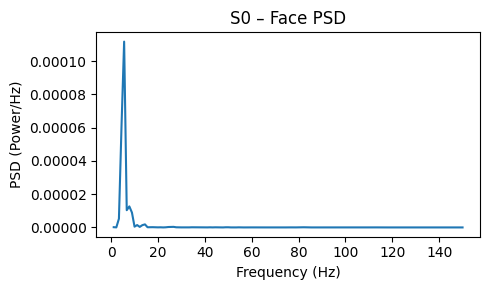

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.00842782 -0.01234691 -0.01335162 -0.01255754 -0.01187463 -0.01172147
 -0.01114953 -0.00962012 -0.00773751 -0.00624176]
  Body: avg_sig sample values after detrend: [-0.01149999 -0.01541347 -0.01641258 -0.0156129  -0.01492439 -0.01476563
 -0.01418809 -0.01265307 -0.01076486 -0.0092635 ]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


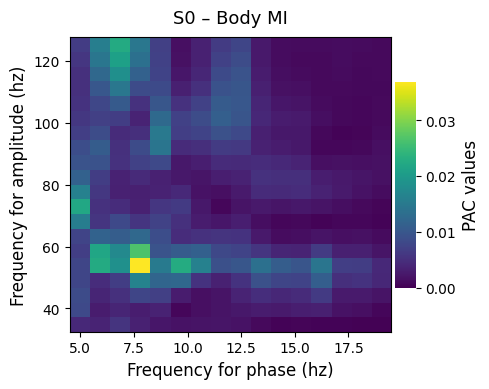

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


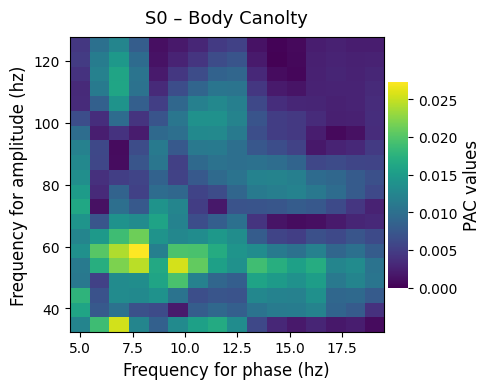

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [6.45254907e-07 1.12679695e-08 4.62922258e-07 3.18490704e-05
 8.05859710e-05 5.35990906e-06 4.41691946e-07 2.10286368e-06
 4.46455122e-06 3.31284615e-06]


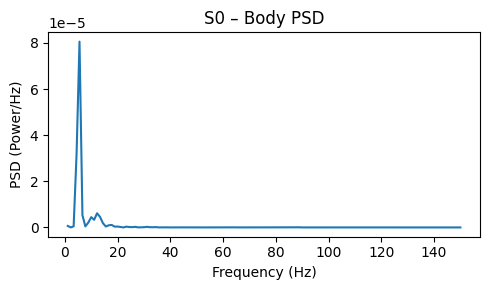

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [0.00654928 0.00935049 0.00963088 0.00848404 0.00781168 0.00829966
 0.0092956  0.01015474 0.01093564 0.01178684]
  Natural: avg_sig sample values after detrend: [0.00519388 0.0079972  0.00827969 0.00713496 0.00646471 0.00695479
 0.00795284 0.00881408 0.00959709 0.0104504 ]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


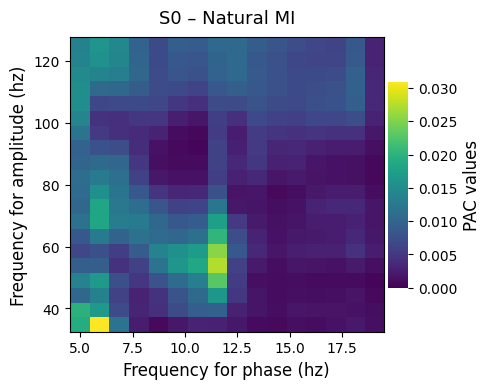

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


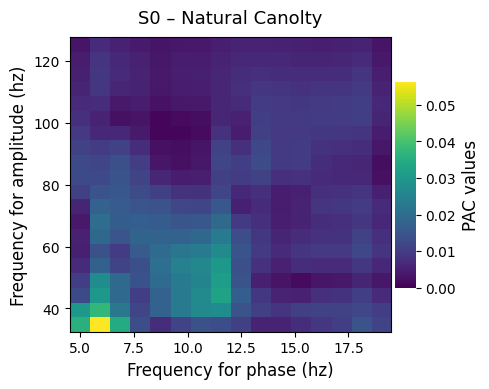

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [1.18998589e-07 1.82716090e-07 1.07193658e-05 1.37440512e-05
 1.15614972e-05 2.18497548e-05 1.37360019e-05 2.19802548e-05
 4.58329170e-06 2.28619587e-07]


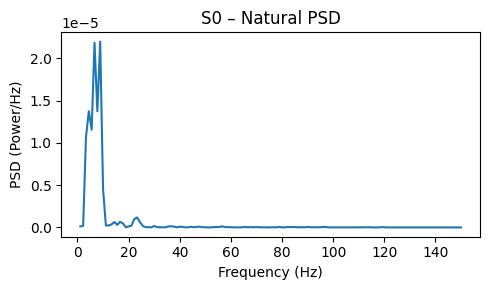

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [0.00985927 0.01390413 0.01420657 0.01261069 0.01197812 0.01306936
 0.01454632 0.01527347 0.01549273 0.01581222]
  Artifact: avg_sig sample values after detrend: [0.00990825 0.01395262 0.01425458 0.01265821 0.01202515 0.01311591
 0.01459238 0.01531903 0.01553782 0.01585682]
  Artifact: Calculated PAC (MI and Canolty)


WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


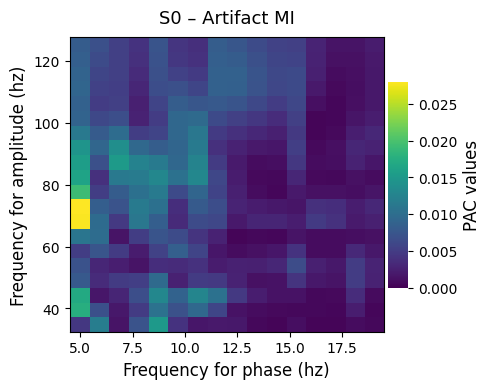

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


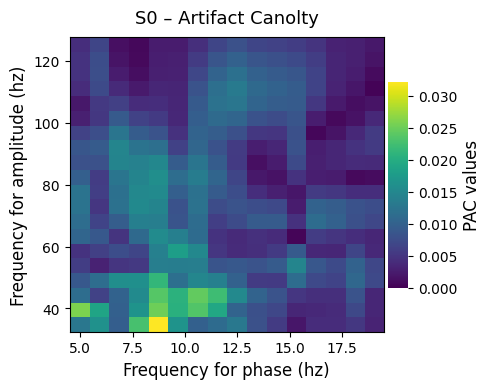

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [1.89418167e-08 5.26545342e-08 2.83705198e-06 3.76666171e-05
 2.95323015e-05 4.55685097e-05 2.26466901e-05 5.64122093e-06
 1.49167647e-06 9.78106398e-09]


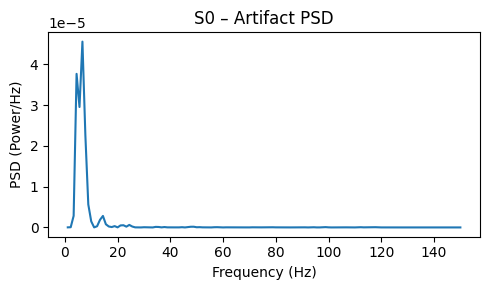

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 1: n_samples = 900, n_trials = 821, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [0.0166727  0.02372869 0.02521612 0.02424765 0.02501408 0.02798712
 0.03059214 0.03129967 0.03122626 0.03190279]
  Face: avg_sig sample values after detrend: [0.01292834 0.01999165 0.02148639 0.02052523 0.02129897 0.02427931
 0.02689164 0.02760648 0.02754038 0.02822422]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


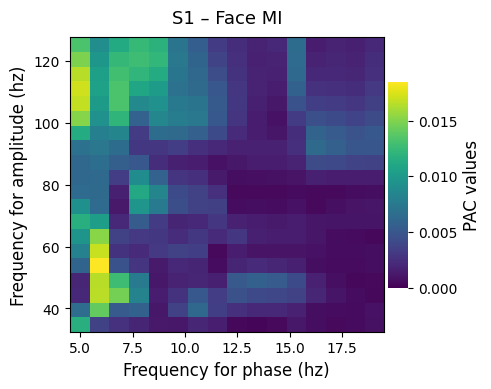

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


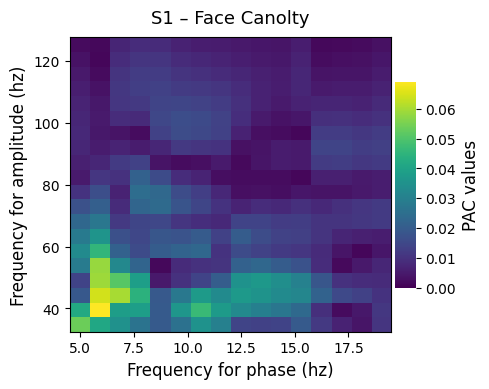

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [9.30457140e-07 1.90669881e-07 3.19615528e-05 1.14781897e-04
 2.44186334e-05 9.71555924e-06 2.73793517e-05 6.51969343e-05
 5.20796150e-05 1.42591218e-05]


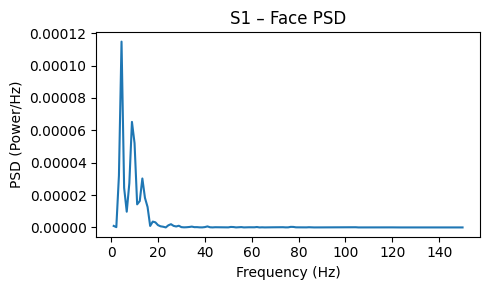

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.00426978 -0.00658487 -0.0075261  -0.00754022 -0.00768065 -0.00840458
 -0.00937409 -0.01017001 -0.01074372 -0.01114531]
  Body: avg_sig sample values after detrend: [-0.00375722 -0.00607134 -0.00701159 -0.00702474 -0.00716419 -0.00788715
 -0.00885569 -0.00965063 -0.01022337 -0.01062398]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


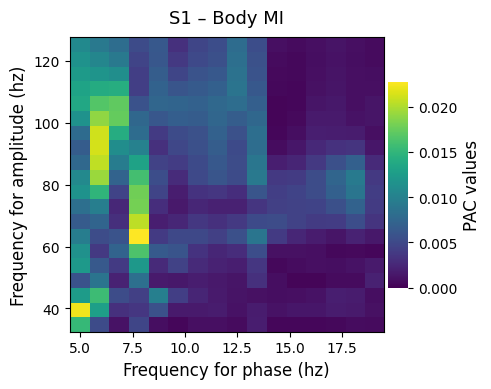

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


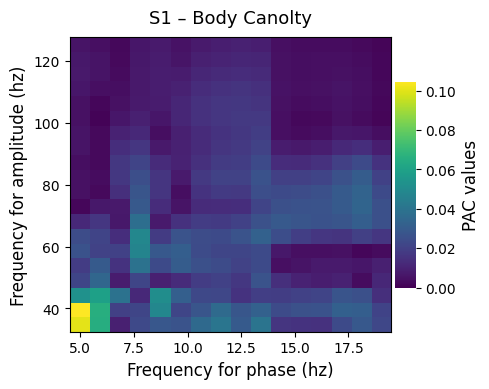

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [3.01537770e-07 2.00644490e-07 2.23618872e-05 9.47326194e-05
 1.15914073e-05 1.25583504e-04 8.18880936e-05 3.32321934e-05
 1.06170413e-05 2.18112520e-05]


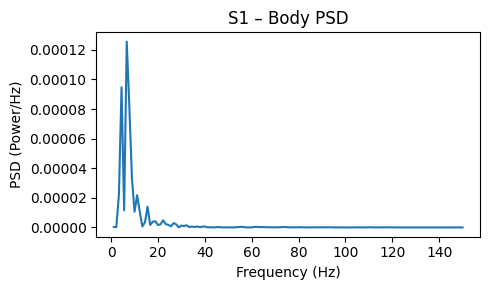

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.0147668  -0.02070506 -0.02077515 -0.01770263 -0.01587855 -0.01659223
 -0.01788879 -0.01794822 -0.01689784 -0.01541561]
  Natural: avg_sig sample values after detrend: [-0.01552948 -0.02146447 -0.0215313  -0.01845553 -0.01662818 -0.0173386
 -0.0186319  -0.01868807 -0.01763442 -0.01614894]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


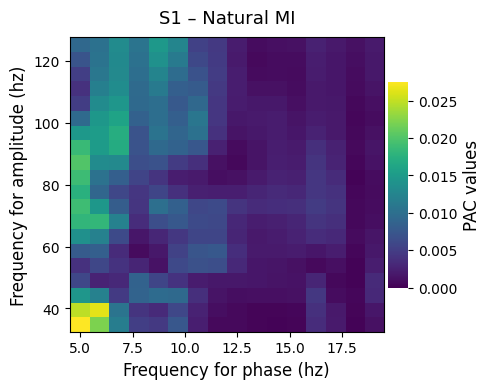

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


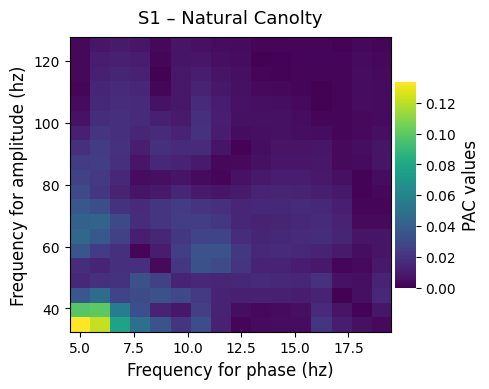

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [3.77446209e-07 1.47777407e-07 7.58342705e-06 4.79001870e-05
 7.24248712e-05 1.83309271e-04 6.46124097e-05 2.70864287e-05
 4.15889345e-05 4.75363427e-06]


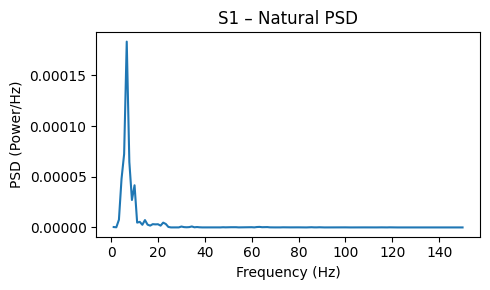

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [0.02077117 0.03144915 0.0355165  0.03510372 0.03438934 0.03432326
 0.03285704 0.02904596 0.02468821 0.02177836]
  Artifact: avg_sig sample values after detrend: [0.02188386 0.0325578  0.03662111 0.03620428 0.03548587 0.03541575
 0.03394549 0.03013037 0.02576858 0.02285469]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


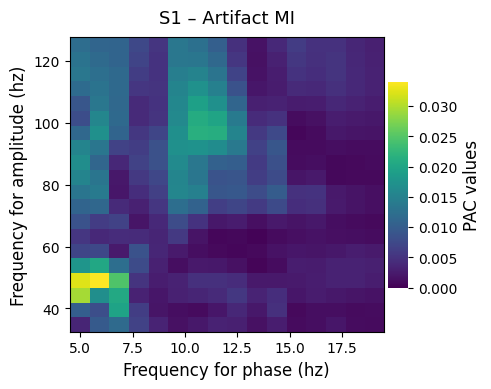

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


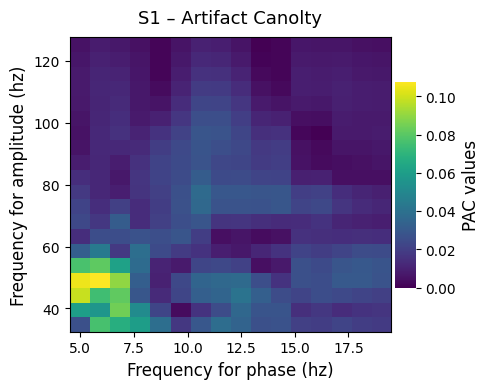

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [3.54467651e-07 5.84717326e-07 5.65028635e-05 1.77482735e-04
 9.07455327e-05 3.30561439e-05 7.08332127e-05 9.74020037e-05
 2.05171868e-05 2.39037987e-05]


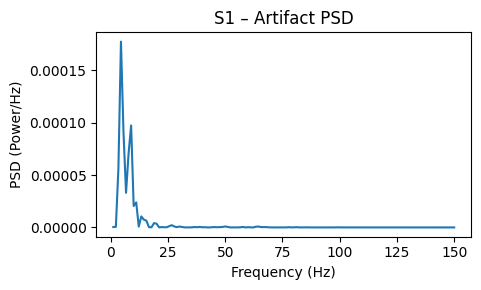

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 2: n_samples = 900, n_trials = 822, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [ 0.00247633  0.00348043  0.00383434  0.00396314  0.00414755  0.0040101
  0.00294074  0.00084157 -0.0017715  -0.00431737]
  Face: avg_sig sample values after detrend: [ 0.00399299  0.00499668  0.00535018  0.00547857  0.00566256  0.0055247
  0.00445492  0.00235534 -0.00025813 -0.00280442]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


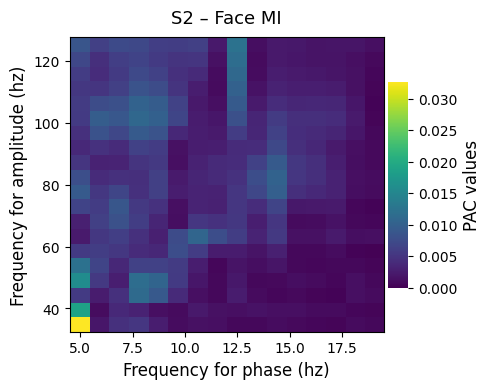

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


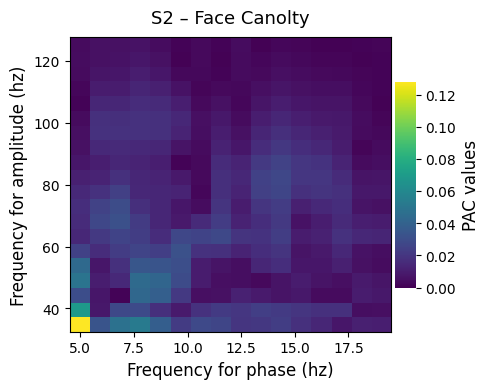

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [6.40858735e-07 3.87977962e-08 6.70519475e-06 3.18048517e-05
 6.51415300e-05 3.46896528e-06 2.55352793e-05 7.39254374e-06
 1.07824246e-05 1.00536511e-05]


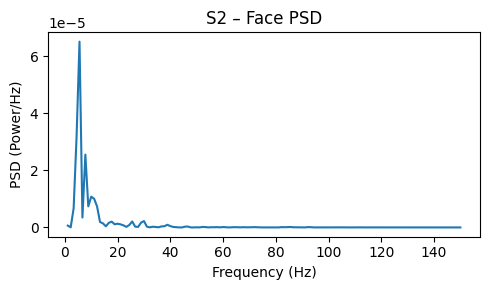

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [0.00798965 0.01026238 0.00911362 0.00672118 0.00584283 0.00704693
 0.00900199 0.01069509 0.01237501 0.01448821]
  Body: avg_sig sample values after detrend: [0.0080908  0.01035981 0.00920733 0.00681117 0.00592911 0.00712949
 0.00908083 0.0107702  0.0124464  0.01455589]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


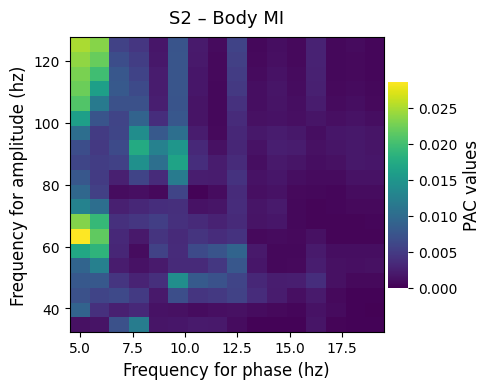

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


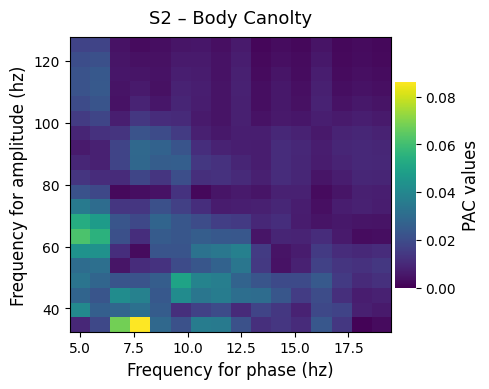

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [1.04043519e-06 2.56659356e-07 4.48103210e-06 3.14955910e-05
 2.52187220e-05 1.51277715e-05 1.87428599e-05 1.22622809e-05
 4.95301240e-06 1.43014874e-05]


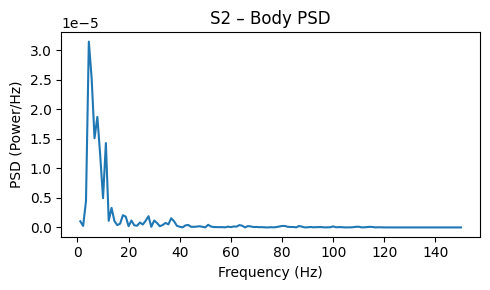

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.01476074 -0.02066622 -0.02130994 -0.01956432 -0.01936691 -0.02135246
 -0.02334192 -0.02390116 -0.02375065 -0.02386904]
  Natural: avg_sig sample values after detrend: [-0.0146881  -0.02059407 -0.02123829 -0.01949317 -0.01929625 -0.0212823
 -0.02327225 -0.02383199 -0.02368197 -0.02380086]
  Natural: Calculated PAC (MI and Canolty)


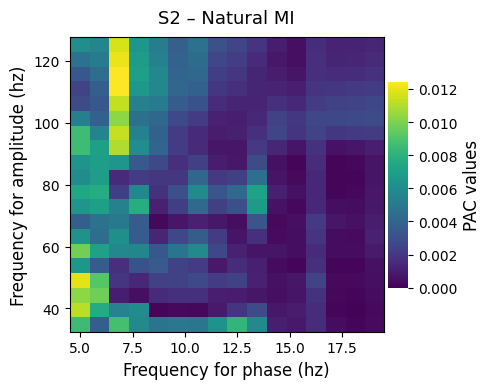

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


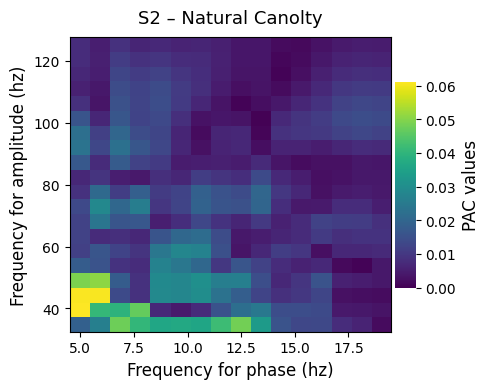

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [7.49475532e-09 1.17411564e-07 1.80011969e-05 1.33914763e-04
 2.53710464e-04 6.67665087e-05 1.22207397e-05 1.01025142e-04
 8.90081355e-05 4.16317465e-05]


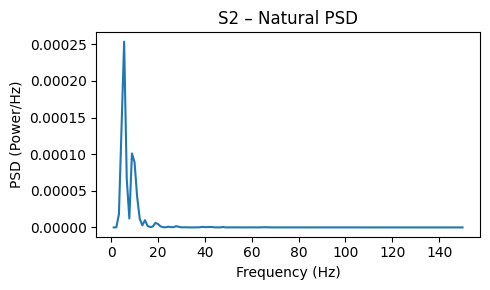

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-1.66882169e-03 -1.20190387e-03  2.93988919e-04  1.57542325e-03
  1.51500185e-03  7.13881415e-05 -1.96762872e-03 -3.88784221e-03
 -5.44815467e-03 -6.58186712e-03]
  Artifact: avg_sig sample values after detrend: [-0.00264748 -0.00217776 -0.00067906  0.00060518  0.00054756 -0.00089324
 -0.00292946 -0.00484686 -0.00640437 -0.00753528]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


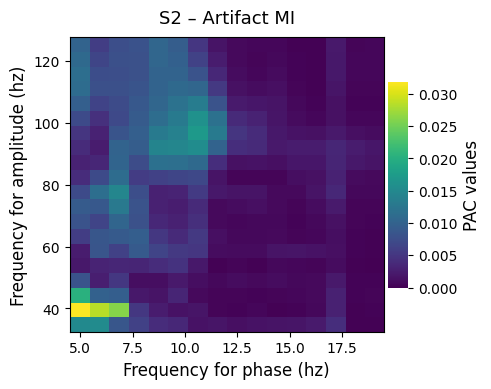

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


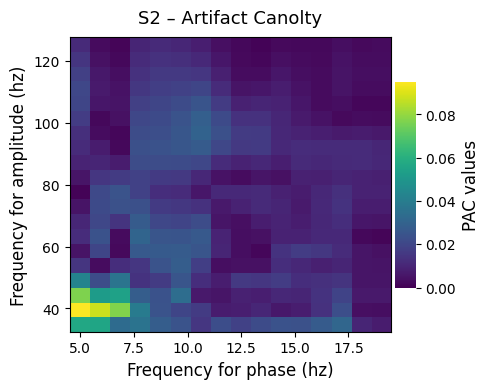

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [1.82487711e-07 2.34135298e-07 3.85898828e-06 1.29182501e-05
 7.71463874e-05 2.20284801e-05 3.61949601e-05 1.01870704e-04
 6.77120596e-05 2.37665480e-05]


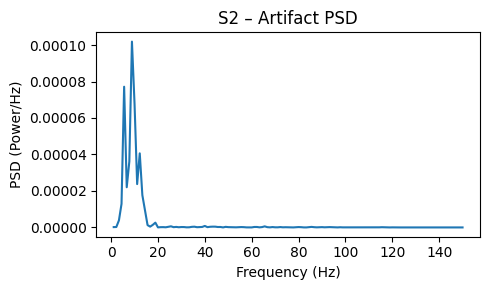

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension



Session 3: n_samples = 900, n_trials = 821, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.01320485 -0.01999189 -0.02237474 -0.0218611  -0.02155167 -0.02240482
 -0.02297129 -0.02198046 -0.01977308 -0.01713782]
  Face: avg_sig sample values after detrend: [-0.0124959  -0.01928462 -0.02166916 -0.02115721 -0.02084946 -0.0217043
 -0.02227246 -0.02128332 -0.01907763 -0.01644406]
  Face: Calculated PAC (MI and Canolty)


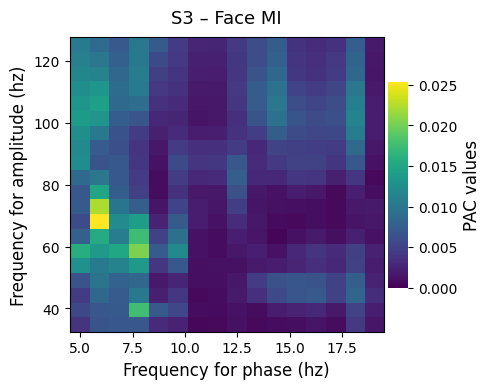

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


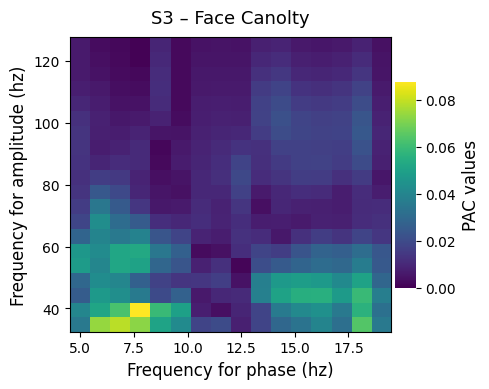

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [5.07979270e-08 7.11725239e-08 1.48641238e-05 5.84924384e-05
 9.52621969e-05 3.42919497e-05 1.43313974e-05 1.23950244e-05
 1.24886976e-05 1.15524526e-05]


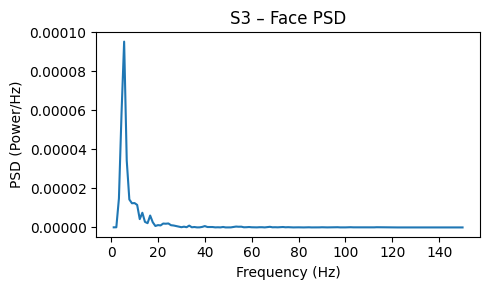

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.01480767 -0.02249497 -0.02534075 -0.02488068 -0.02435206 -0.024754
 -0.02475525 -0.02356924 -0.02231892 -0.02243432]
  Body: avg_sig sample values after detrend: [-0.01235972 -0.02005313 -0.02290503 -0.02245108 -0.02192856 -0.02233662
 -0.02234399 -0.02116409 -0.01991989 -0.02004141]
  Body: Calculated PAC (MI and Canolty)


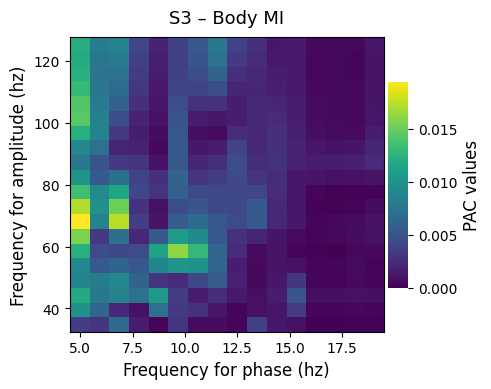

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


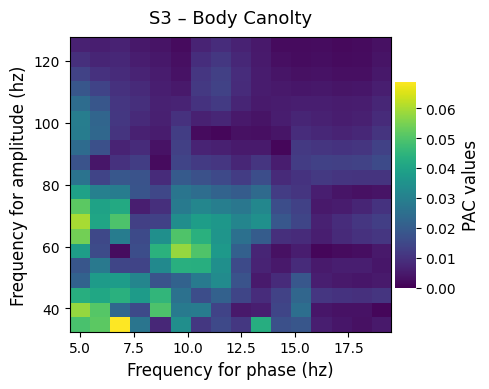

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [6.11711074e-07 2.43412217e-07 1.85461515e-05 1.20317213e-05
 1.21090723e-04 3.54455959e-06 5.65597857e-05 8.21131265e-05
 8.28263475e-05 6.90178830e-05]


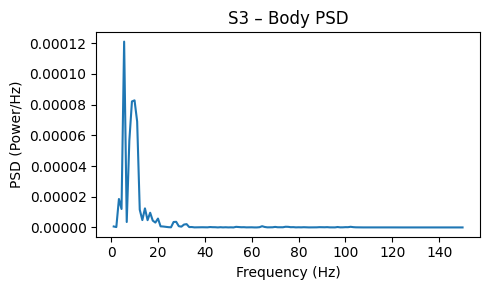

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.00551165 -0.00920955 -0.01178944 -0.01324628 -0.01404203 -0.01418396
 -0.01336553 -0.01176494 -0.0101821  -0.00927236]
  Natural: avg_sig sample values after detrend: [-0.00535513 -0.00905184 -0.01163056 -0.01308623 -0.01388079 -0.01402155
 -0.01320193 -0.01160017 -0.01001615 -0.00910523]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


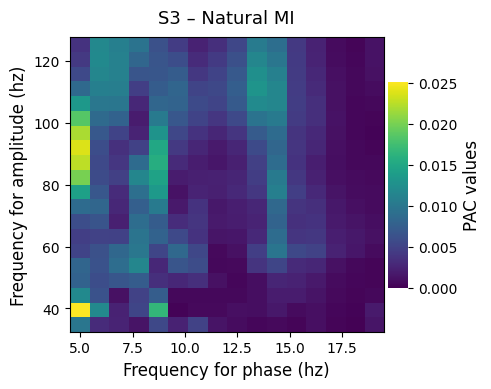

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


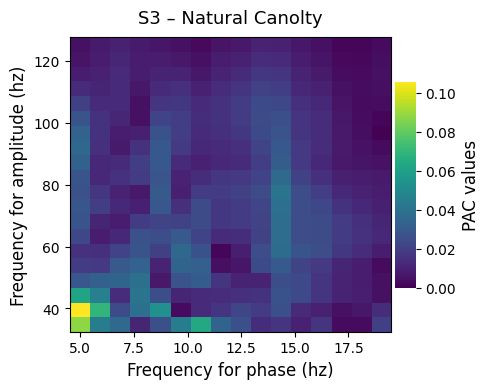

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [1.87307404e-07 1.47548058e-07 1.82074816e-05 2.54863719e-05
 2.98849053e-05 1.73104930e-04 1.29513120e-04 9.90131670e-05
 7.76538501e-05 3.26174795e-05]


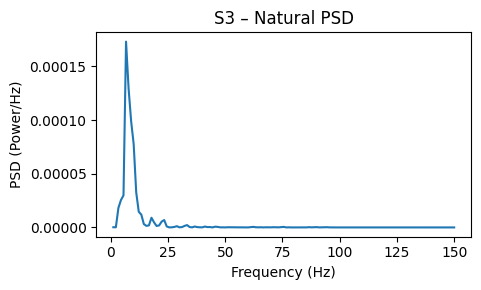

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-0.0182827  -0.02719916 -0.03016877 -0.0295669  -0.02948321 -0.03081877
 -0.03155737 -0.03062471 -0.02948301 -0.02986641]
  Artifact: avg_sig sample values after detrend: [-0.01458288 -0.02350871 -0.02648769 -0.02589519 -0.02582088 -0.02716581
 -0.02791379 -0.0269905  -0.02585817 -0.02625094]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


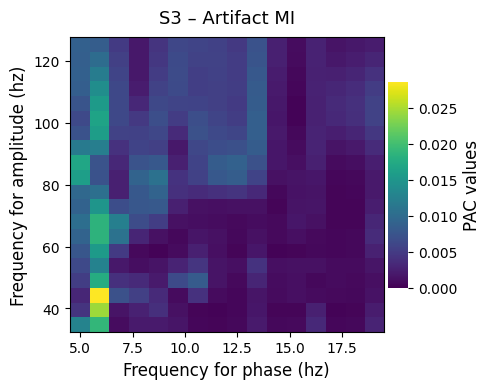

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


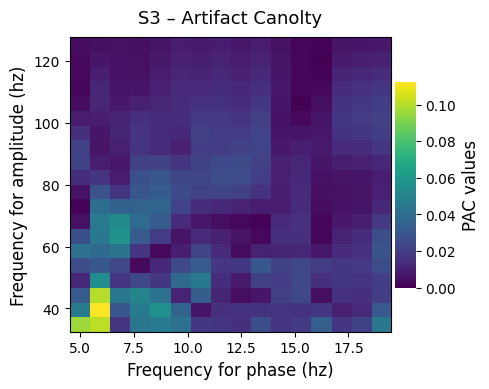

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [1.59254746e-06 2.19058447e-09 1.39155686e-05 8.84627682e-05
 1.26954392e-04 1.70530477e-05 4.91305602e-05 1.01200031e-05
 1.27324128e-05 1.16418329e-05]


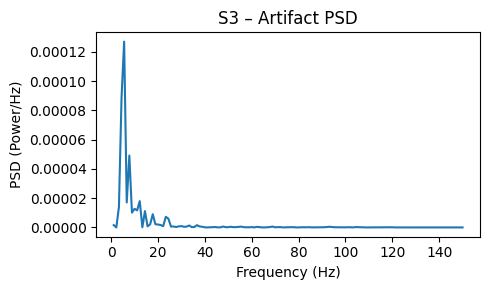

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)



Session 4: n_samples = 900, n_trials = 820, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.02616837 -0.03852712 -0.04211904 -0.04069005 -0.04045941 -0.0427926
 -0.04449992 -0.0435316  -0.04152719 -0.04078461]
  Face: avg_sig sample values after detrend: [-0.02467232 -0.03703363 -0.04062812 -0.03920169 -0.03897361 -0.04130937
 -0.04301926 -0.0420535  -0.04005166 -0.03931164]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


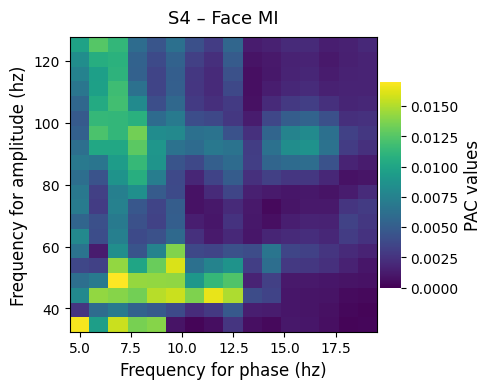

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


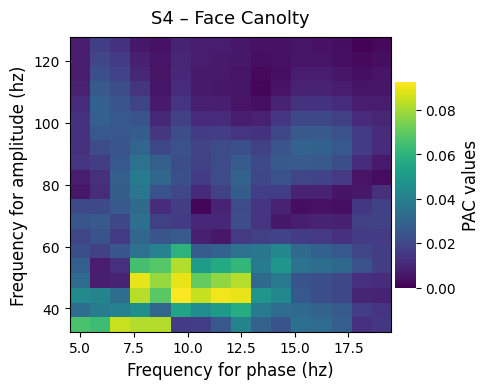

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [1.28866185e-07 9.63317423e-07 1.01563627e-04 2.39365602e-04
 3.08930998e-06 1.00384911e-04 4.72362154e-05 1.71550343e-05
 4.47866208e-05 2.18367049e-05]


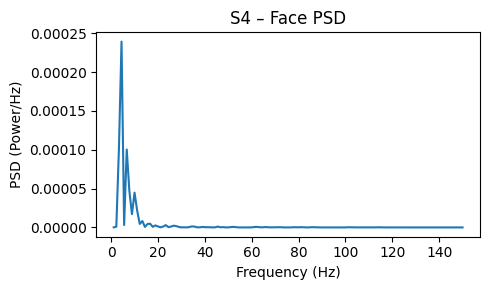

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.00367805 -0.00641504 -0.00783492 -0.00753014 -0.0061033  -0.0043336
 -0.00265565 -0.00139722 -0.00111334 -0.0023999 ]
  Body: avg_sig sample values after detrend: [0.00573266 0.00297377 0.00153198 0.00181485 0.00321978 0.00496756
 0.0066236  0.00786012 0.0081221  0.00681363]


WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


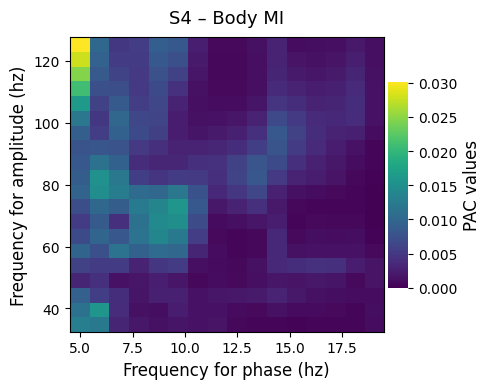

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


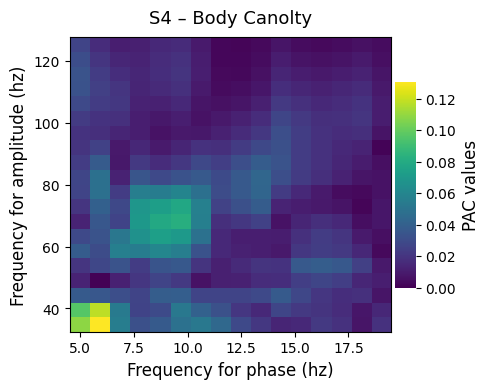

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [7.84639417e-06 7.20861311e-07 1.28171430e-04 5.14870400e-04
 2.02238968e-04 2.64337534e-05 3.19044197e-05 6.17333335e-05
 1.38980671e-05 5.61409574e-07]


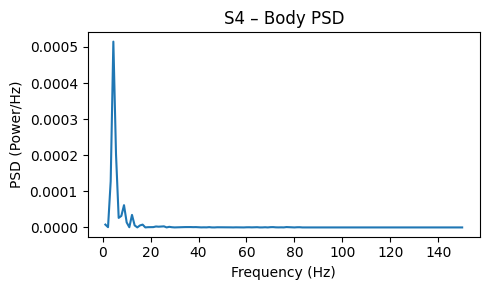

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [0.02577601 0.03623105 0.03722826 0.03353038 0.03200602 0.03392426
 0.03562056 0.03469676 0.03264731 0.03162238]
  Natural: avg_sig sample values after detrend: [0.0230542  0.03351854 0.03452505 0.03083647 0.02932142 0.03124896
 0.03295457 0.03204007 0.02999992 0.0289843 ]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


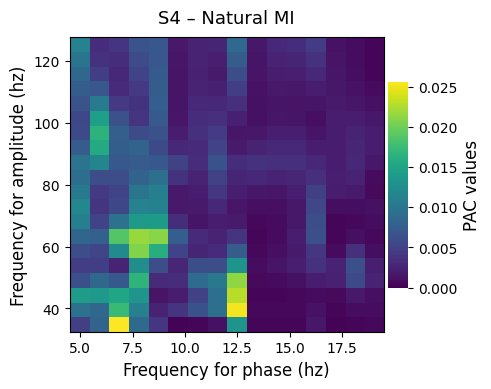

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


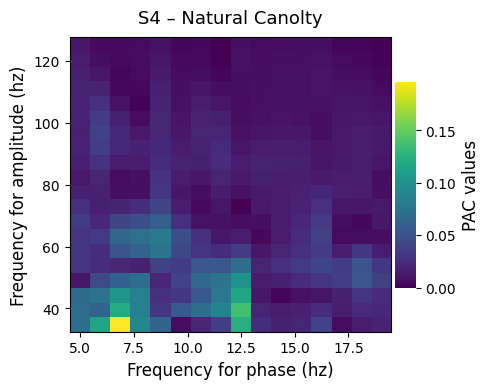

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [1.97291654e-06 1.33112159e-06 1.54178732e-04 6.25866109e-04
 2.95144692e-04 2.98895508e-05 6.12347110e-06 1.49425479e-05
 4.94698683e-05 4.69135360e-05]


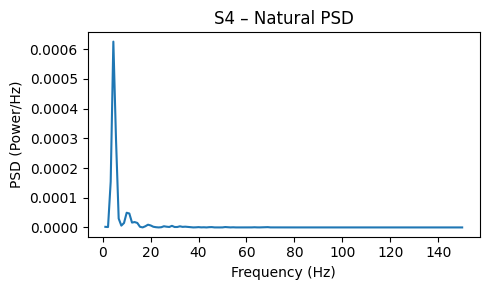

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-0.01395778 -0.02003978 -0.02032637 -0.01651614 -0.01217604 -0.00868116
 -0.00502563 -0.00062781  0.00335872  0.00567408]
  Artifact: avg_sig sample values after detrend: [-0.01930789 -0.02538261 -0.02566191 -0.0218444  -0.01749701 -0.01399485
 -0.01033202 -0.00592692 -0.0019331   0.00038954]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


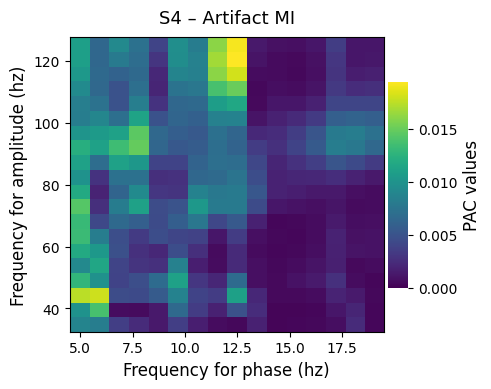

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


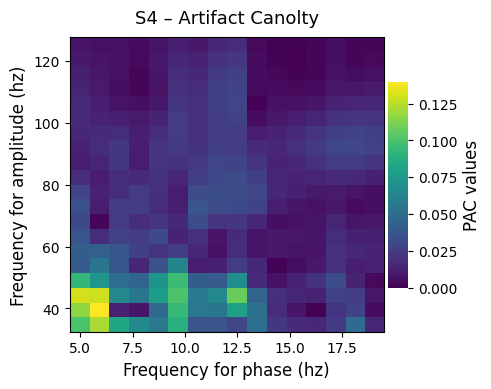

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [2.18640720e-06 1.34936649e-06 7.09360330e-05 1.68698041e-04
 1.89703900e-05 6.30993996e-06 9.11744687e-05 3.05323183e-05
 2.02680077e-05 4.66802364e-06]


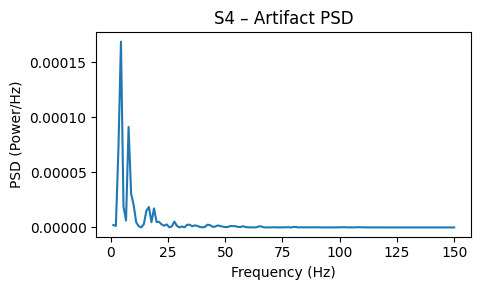

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 5: n_samples = 900, n_trials = 818, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [ 0.00444506  0.00645092  0.00704121  0.00683622  0.00663137  0.00626423
  0.00491711  0.00224567 -0.00122032 -0.0047223 ]
  Face: avg_sig sample values after detrend: [ 0.0034676   0.00547234  0.00606151  0.00585541  0.00564943  0.00528118
  0.00393294  0.00126038 -0.00220673 -0.00570983]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


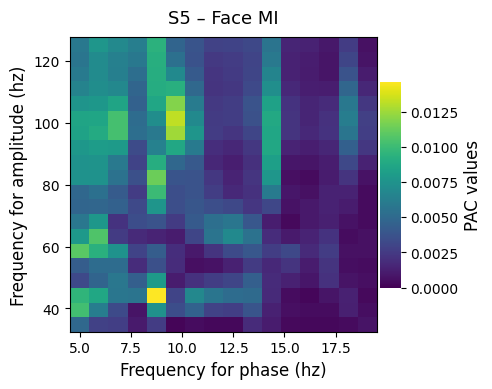

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


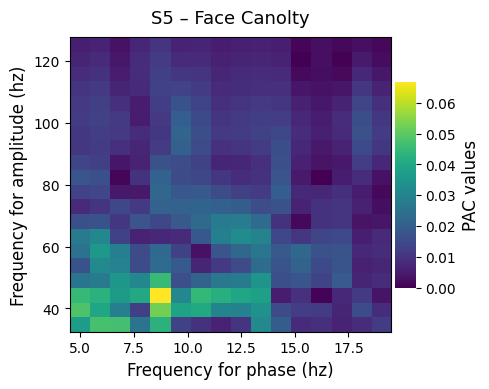

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [7.59183983e-07 8.08256438e-08 6.15995290e-06 1.12151445e-04
 8.86761907e-05 1.99496354e-05 8.78387763e-05 1.15821137e-04
 6.78644551e-05 1.30128943e-05]


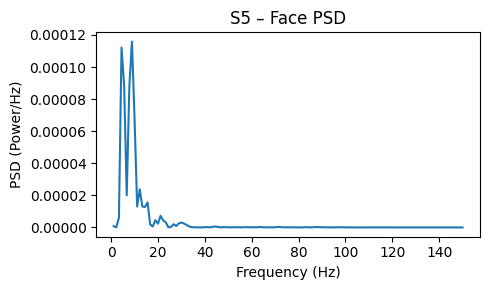

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.00405901 -0.00542677 -0.00553151 -0.00545592 -0.00622323 -0.00762307
 -0.00869805 -0.00901298 -0.00900698 -0.00922911]
  Body: avg_sig sample values after detrend: [-0.00176227 -0.00313335 -0.0032414  -0.00316913 -0.00393976 -0.00534292
 -0.00642122 -0.00673946 -0.00673679 -0.00696223]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


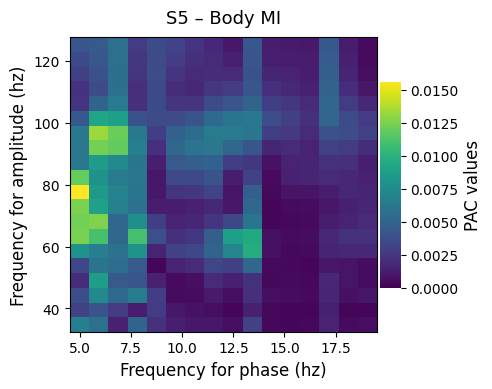

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


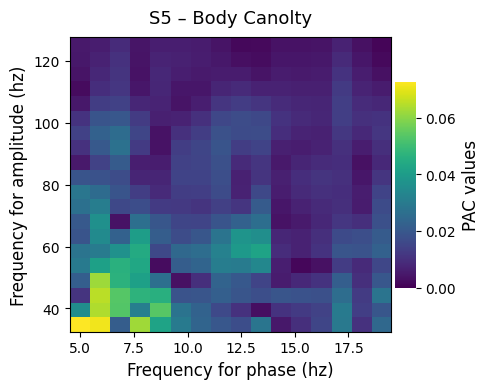

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [2.88747809e-07 9.89781087e-07 4.74827076e-05 1.84622271e-04
 8.22251945e-05 1.57799183e-05 3.20784222e-06 2.37100391e-05
 4.69758044e-05 1.27906750e-05]


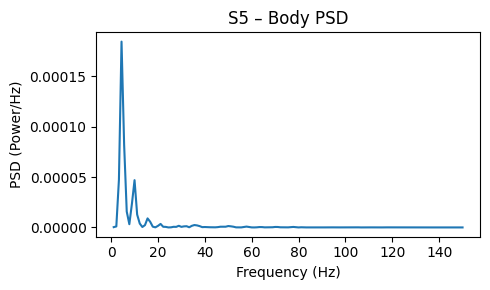

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [0.00206417 0.00441008 0.00721382 0.01031004 0.01358114 0.01665639
 0.01888085 0.01966534 0.01885311 0.01677751]
  Natural: avg_sig sample values after detrend: [-0.00038597  0.00196656  0.00477691  0.00787974  0.01115746  0.01423934
  0.0164704   0.01726152  0.0164559   0.01438692]


WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


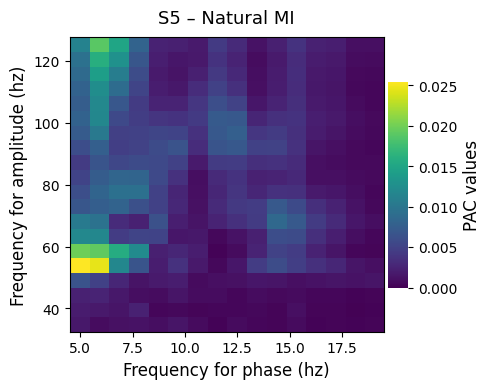

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


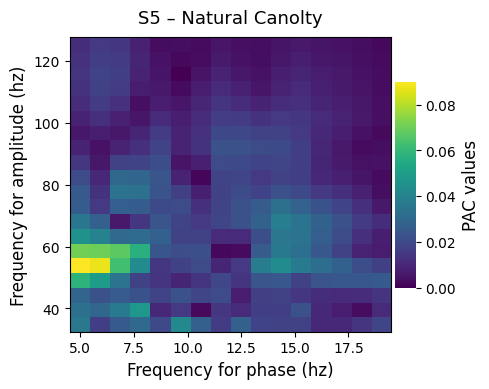

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [7.72647225e-07 8.53785715e-07 4.71954447e-06 7.38049717e-05
 3.86428942e-05 8.71608901e-05 5.11883818e-05 1.40016431e-04
 2.74589011e-05 4.82259220e-05]


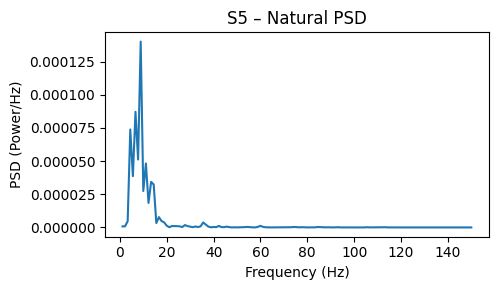

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [0.01914393 0.02670682 0.02674731 0.02282347 0.02043003 0.02100165
 0.02203316 0.02156092 0.02030391 0.01953515]
  Artifact: avg_sig sample values after detrend: [0.0181726  0.02573966 0.02578433 0.02186467 0.0194754  0.0200512
 0.02108688 0.02061882 0.01936598 0.0186014 ]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


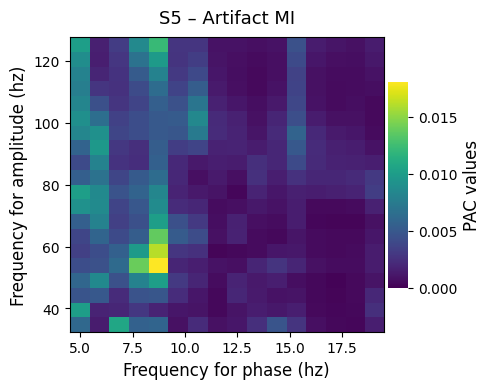

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


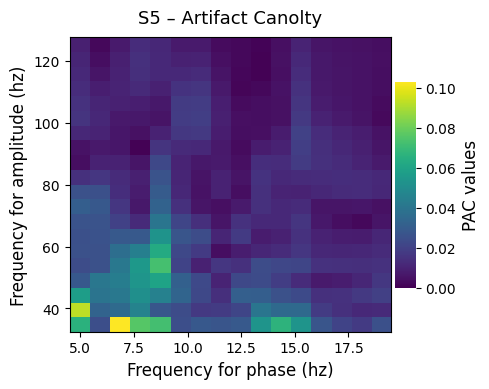

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [5.70199390e-07 7.24406407e-07 4.03617939e-05 5.20853333e-05
 3.05888878e-05 6.79514421e-05 2.80520647e-05 7.12511499e-06
 4.30676006e-05 4.16313543e-05]


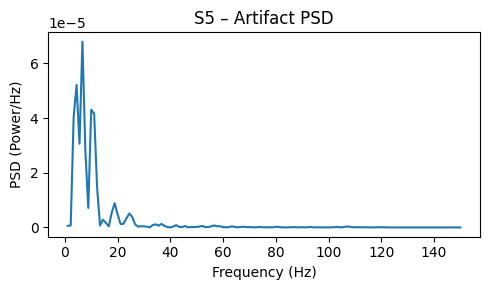

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 6: n_samples = 900, n_trials = 814, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [ 0.00854813  0.00986421  0.00645164  0.00062473 -0.00462362 -0.00852415
 -0.01207557 -0.01576404 -0.01891372 -0.02107815]
  Face: avg_sig sample values after detrend: [ 0.01138892  0.01270174  0.00928591  0.00345574 -0.00179587 -0.00569967
 -0.00925435 -0.01294609 -0.01609903 -0.01826672]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


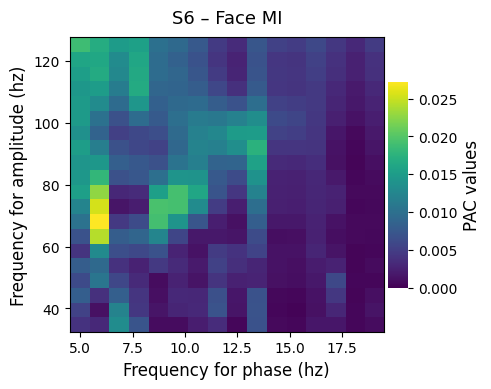

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


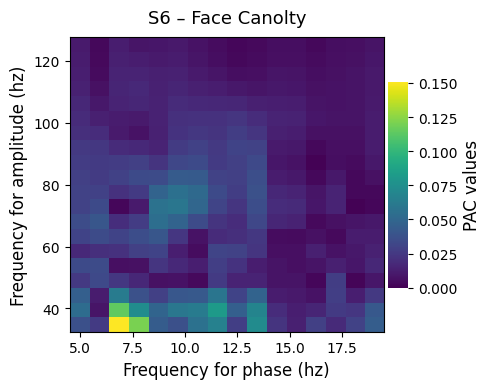

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [9.66347295e-07 3.29421541e-07 5.76516481e-05 4.02672156e-04
 1.08121225e-04 2.04810553e-04 4.89467674e-04 3.47244046e-04
 6.80680290e-05 2.20160262e-05]


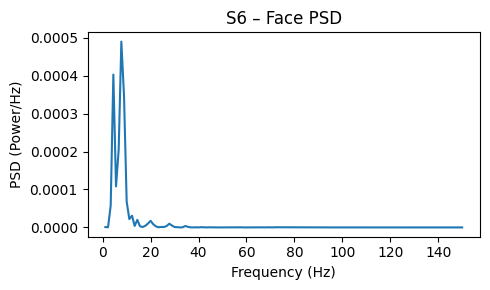

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.01009491 -0.01192367 -0.00888484 -0.00426203 -0.00181351 -0.00201693
 -0.0026989  -0.00222769 -0.0008126   0.00095765]
  Body: avg_sig sample values after detrend: [-7.71878051e-03 -9.55471799e-03 -6.52305568e-03 -1.90741590e-03
  5.33927005e-04  3.23335251e-04 -3.65804046e-04  9.82250468e-05
  1.50614874e-03  3.26922495e-03]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


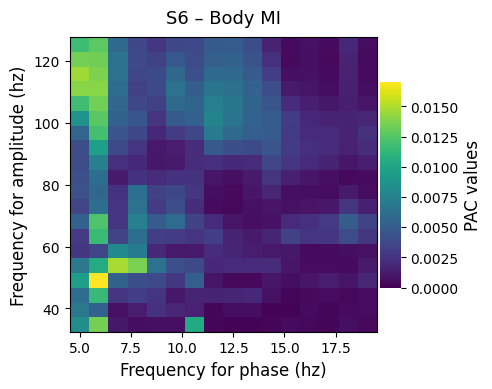

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


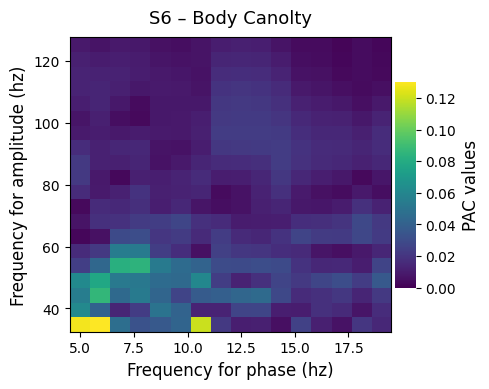

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [1.14577568e-06 2.45660154e-06 2.35291248e-04 5.69384231e-04
 3.30812120e-05 3.79375080e-05 3.28897065e-04 3.47007639e-04
 8.12178893e-05 7.22362694e-05]


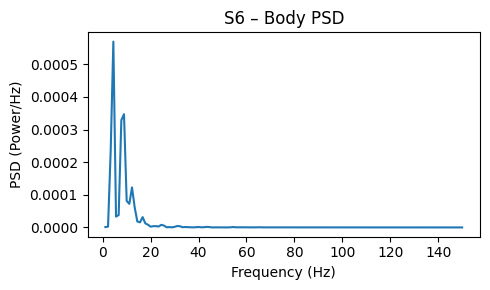

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [0.04244719 0.05828753 0.05758824 0.0488318  0.04390758 0.04498294
 0.04570724 0.04181197 0.0356693  0.03097022]
  Natural: avg_sig sample values after detrend: [0.04109882 0.05694792 0.05625739 0.04750971 0.04259425 0.04367836
 0.04441142 0.04052491 0.034391   0.02970067]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


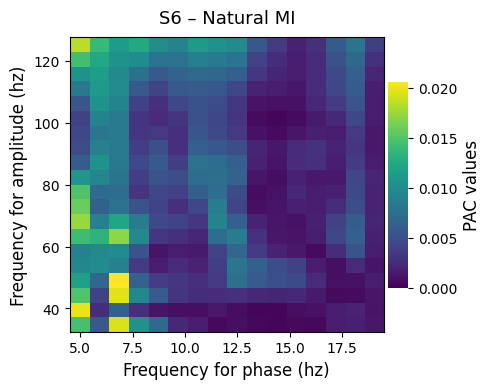

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


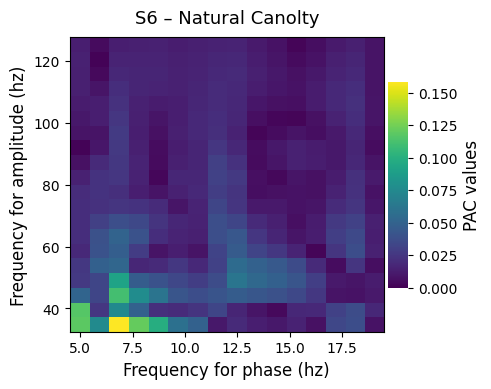

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [3.48576903e-06 4.96716671e-06 2.10292356e-04 7.56042236e-05
 3.05860716e-04 1.57423558e-04 2.28984710e-04 3.73362048e-05
 9.42415637e-05 2.44206030e-05]


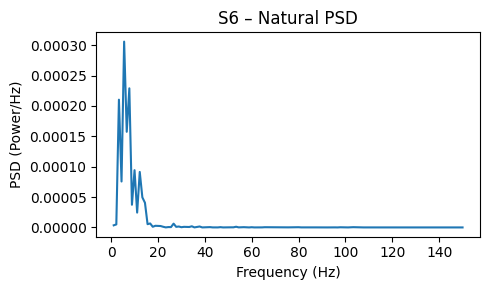

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [ 0.01408191  0.02060316  0.0219644   0.01982171  0.01727474  0.01500239
  0.01137446  0.00544258 -0.00167519 -0.00833967]
  Artifact: avg_sig sample values after detrend: [ 0.01995496  0.02645918  0.02780339  0.02564365  0.02307965  0.02079027
  0.01714531  0.01119639  0.00406159 -0.00261992]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


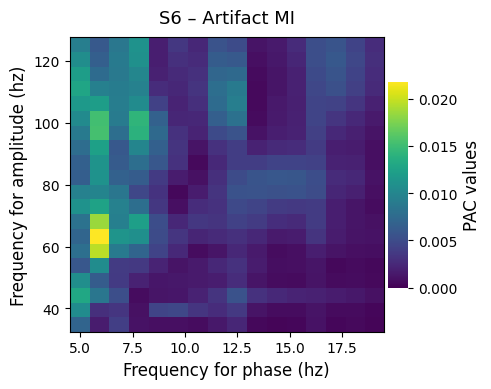

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


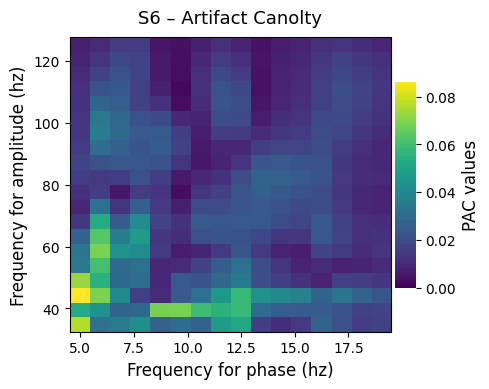

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [5.49014824e-06 2.55326522e-06 1.44371420e-04 4.56859003e-04
 4.64016625e-04 4.43550905e-04 2.73608079e-04 3.07559971e-04
 3.52835443e-05 6.11506693e-05]


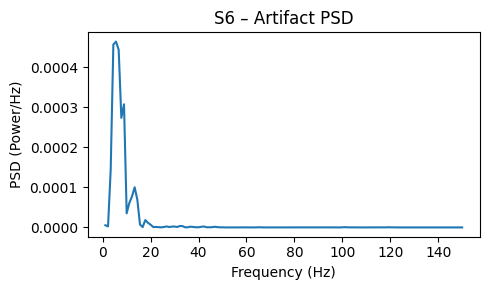

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 7: n_samples = 900, n_trials = 821, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.00302451 -0.00188235  0.00140851  0.00501264  0.00754165  0.00934236
  0.01159849  0.01473557  0.01814586  0.02114214]
  Face: avg_sig sample values after detrend: [-0.00510052 -0.00395433 -0.00065944  0.00294872  0.00548177  0.00728651
  0.00954668  0.01268779  0.01610212  0.01910243]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


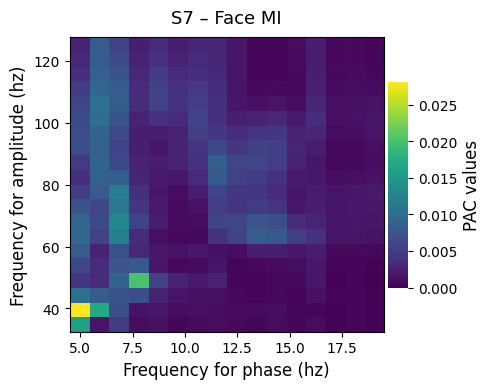

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


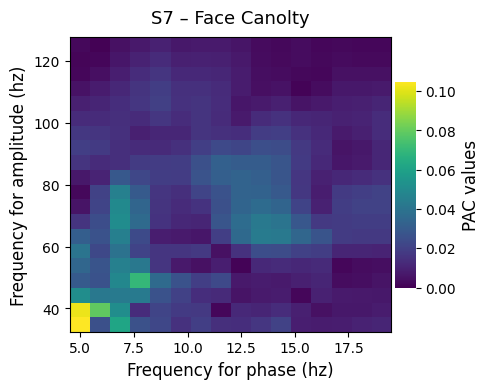

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [2.89114077e-07 1.53638799e-08 1.06476423e-06 1.95731463e-05
 1.95182480e-04 1.46980330e-04 4.18842695e-05 7.50236336e-05
 2.69468057e-05 7.13589786e-06]


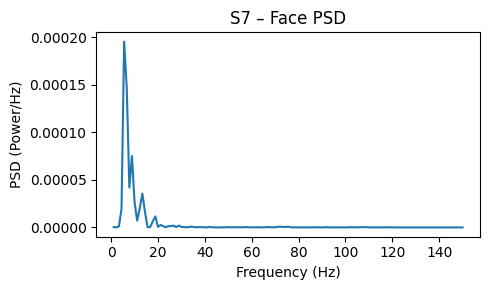

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.0014507  -0.00045091  0.0025464   0.00668096  0.01066711  0.01378
  0.01596879  0.01733424  0.0178595   0.01762622]
  Body: avg_sig sample values after detrend: [-0.00269311 -0.00169084  0.00130895  0.00544599  0.00943462  0.01255
  0.01474128  0.0161092   0.01663695  0.01640615]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)


  Body: Calculated PAC (MI and Canolty)

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


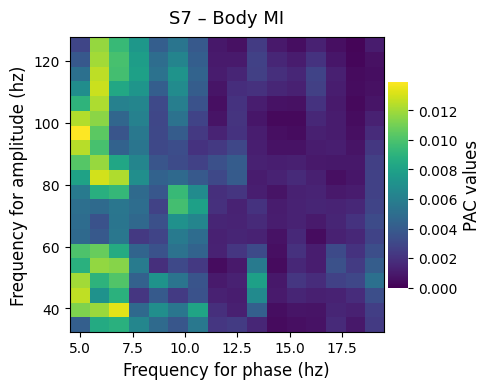

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


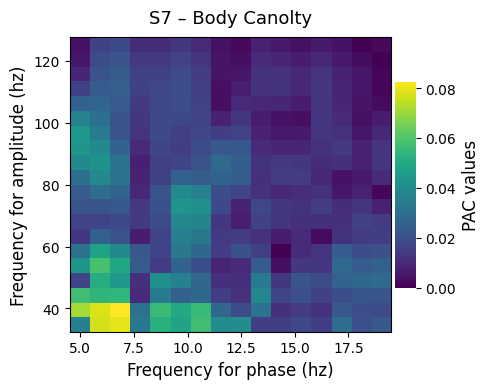

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [9.15044223e-08 3.29204185e-07 3.64927576e-05 9.97640673e-05
 1.07388824e-04 1.07606888e-04 2.48872937e-05 2.70462760e-05
 2.27434599e-05 1.80421382e-05]


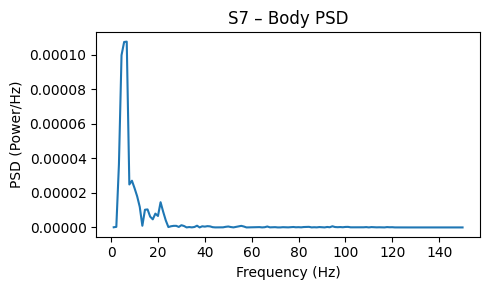

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [ 0.0009198   0.00212329  0.0030618   0.00290475  0.00114546 -0.00215197
 -0.00642821 -0.01086634 -0.01464718 -0.01719159]
  Natural: avg_sig sample values after detrend: [-3.24825013e-04  8.81758250e-04  1.82336010e-03  1.66940008e-03
 -8.67963397e-05 -3.38114033e-03 -7.65428679e-03 -1.20893216e-02
 -1.58670700e-02 -1.84083915e-02]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


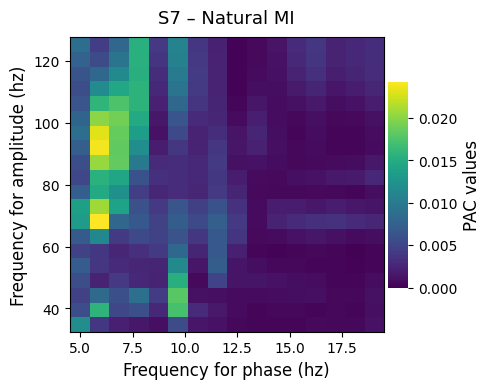

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


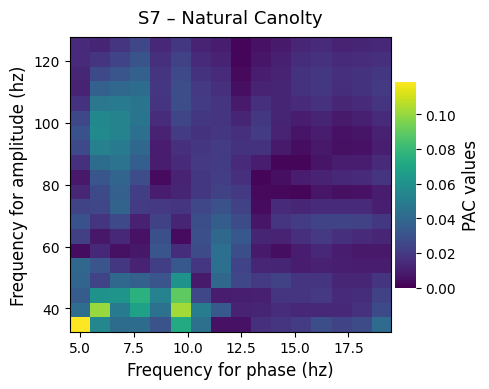

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [1.68532005e-07 9.42878044e-08 4.38073759e-06 7.06619676e-06
 5.68171755e-05 1.39849229e-04 4.93204162e-05 8.34301749e-05
 3.51892426e-05 2.77383710e-06]


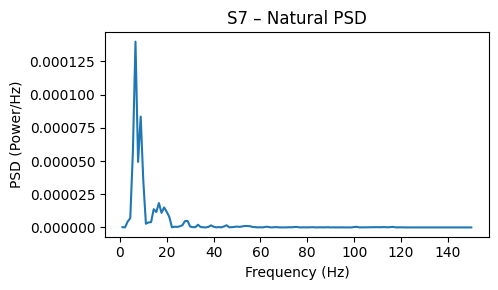

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-0.00603847 -0.00569606 -0.00108332  0.0053127   0.0104288   0.01339614
  0.01531429  0.01715205  0.018789    0.01986092]
  Artifact: avg_sig sample values after detrend: [-0.00418011 -0.00384155  0.00076733  0.0071595   0.01227175  0.01523523
  0.01714953  0.01898343  0.02061652  0.02168459]
  Artifact: Calculated PAC (MI and Canolty)


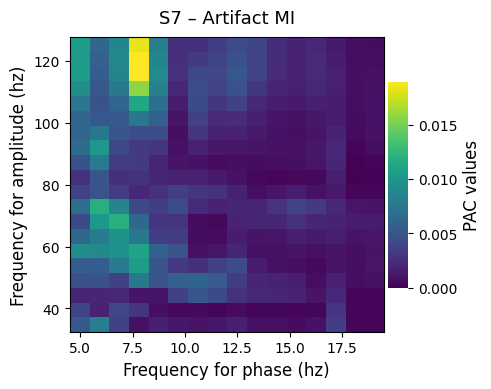

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


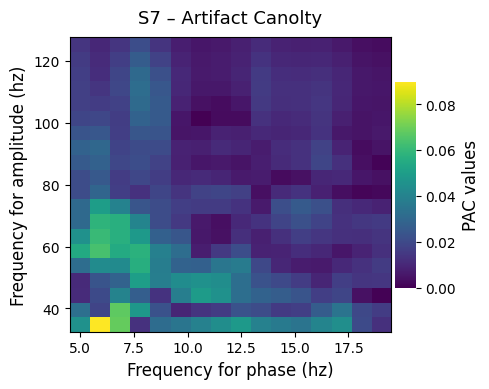

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [2.31171429e-07 1.65918364e-07 5.71139548e-05 3.02803297e-04
 5.83908628e-05 7.42411331e-05 1.49643597e-05 2.48071280e-05
 9.56738001e-06 3.77918995e-05]


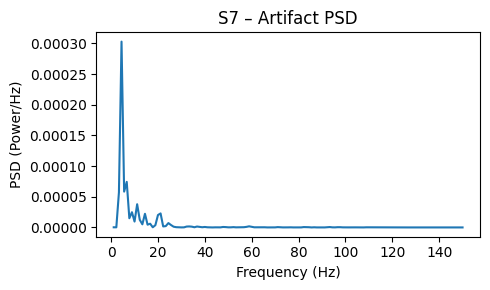

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension



Session 8: n_samples = 900, n_trials = 819, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.01828599 -0.02889835 -0.03336129 -0.03244956 -0.02985943 -0.02756432
 -0.02493047 -0.02144767 -0.01831683 -0.01687649]
  Face: avg_sig sample values after detrend: [-0.02150966 -0.03211504 -0.03657101 -0.03565229 -0.03305519 -0.0307531
 -0.02811227 -0.0246225  -0.02148467 -0.02003736]
  Face: Calculated PAC (MI and Canolty)


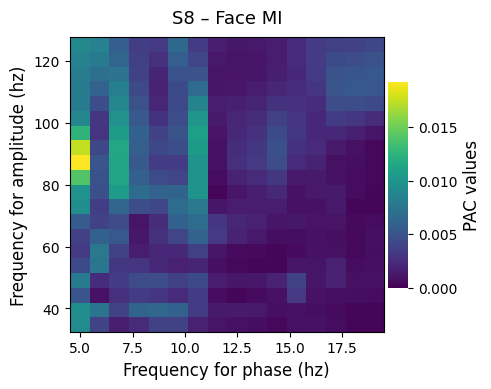

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


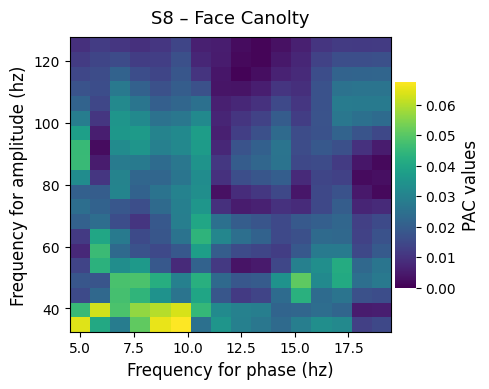

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [7.92491183e-07 7.51142367e-07 4.22081658e-05 5.22729171e-05
 7.87949518e-05 4.60992449e-05 2.44924920e-05 7.47842727e-06
 2.79841309e-06 4.45803931e-07]


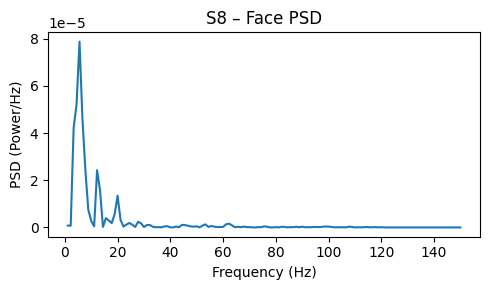

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.02697248 -0.03750374 -0.03758863 -0.03227643 -0.02898806 -0.02922299
 -0.02912705 -0.02607721 -0.0216311  -0.01824796]
  Body: avg_sig sample values after detrend: [-0.03193246 -0.04245542 -0.04253201 -0.03721152 -0.03391485 -0.03414148
 -0.03403725 -0.03097911 -0.0265247  -0.02313326]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


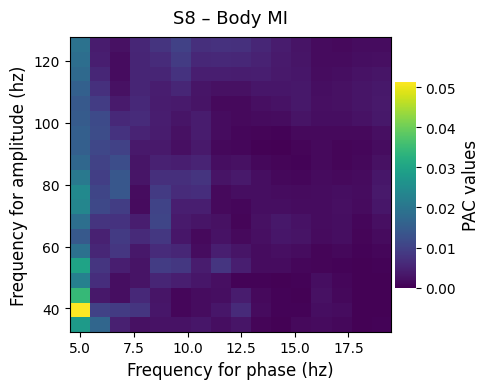

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


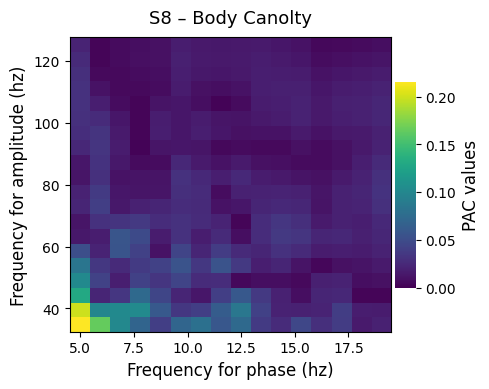

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [1.80876845e-06 1.33519775e-06 5.59977284e-05 5.06381523e-05
 9.99977007e-07 3.67240655e-07 2.70209133e-05 7.53088706e-06
 1.23203548e-05 1.96713951e-06]


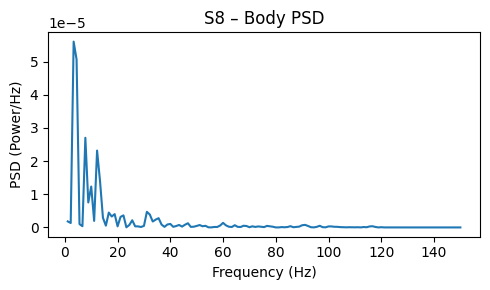

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [0.02264344 0.03329375 0.03660143 0.03609481 0.03726655 0.04112037
 0.04448999 0.04510301 0.04389008 0.04243884]
  Natural: avg_sig sample values after detrend: [0.02261588 0.03326424 0.03656995 0.03606137 0.03723114 0.041083
 0.04445066 0.04506172 0.04384682 0.04239362]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


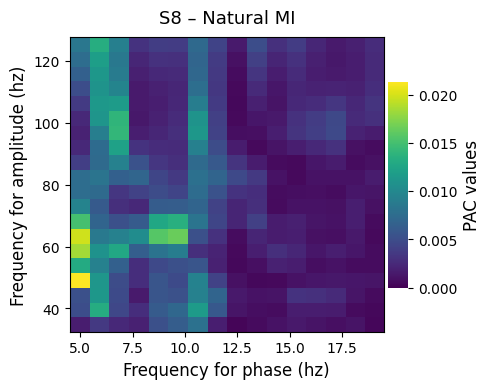

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


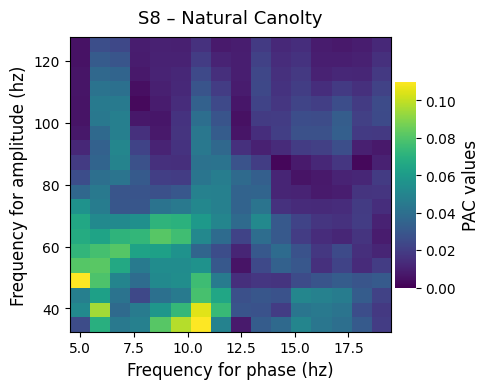

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [3.55024898e-07 5.67878218e-08 9.12920743e-06 5.16613075e-05
 1.59352163e-04 3.22735659e-04 4.19453097e-04 6.07813881e-05
 2.93415000e-06 5.87948957e-06]


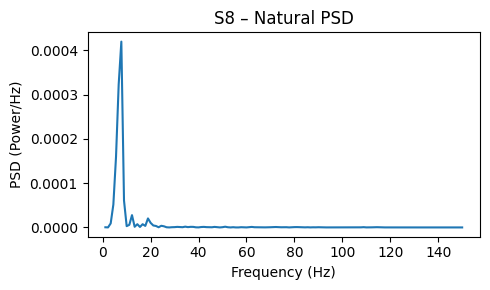

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-0.01614889 -0.02143252 -0.01913878 -0.01258537 -0.00713289 -0.00467273
 -0.00345813 -0.00192223 -0.00061556 -0.00045202]
  Artifact: avg_sig sample values after detrend: [-0.01408673 -0.01937085 -0.01707758 -0.01052466 -0.00507266 -0.00261298
 -0.00139886  0.00013656  0.00144275  0.00160581]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


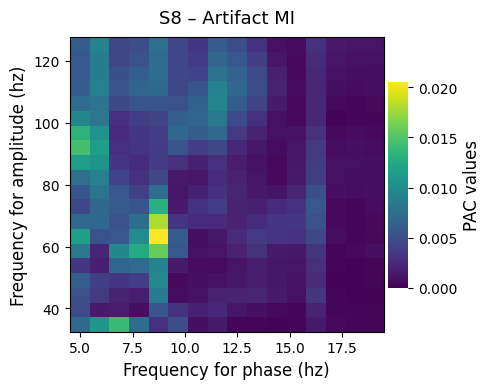

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


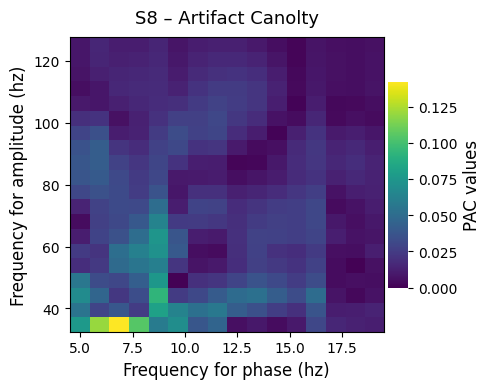

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [1.03030386e-06 7.23934947e-07 1.05251223e-04 2.40352378e-04
 2.23822695e-04 1.72299021e-04 2.13216187e-05 1.11771389e-05
 1.97121479e-05 1.46056640e-05]


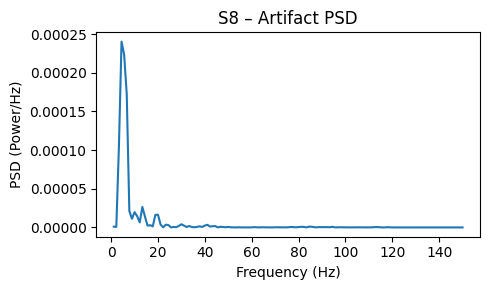

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension



Session 9: n_samples = 900, n_trials = 818, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.00315495 -0.00378143 -0.00320749 -0.00256844 -0.00288987 -0.00400228
 -0.00495753 -0.00515784 -0.0047221  -0.00392961]
  Face: avg_sig sample values after detrend: [-0.0019488  -0.00257937 -0.00200951 -0.00137454 -0.00170006 -0.00281655
 -0.00377589 -0.00398028 -0.00354862 -0.00276022]
  Face: Calculated PAC (MI and Canolty)


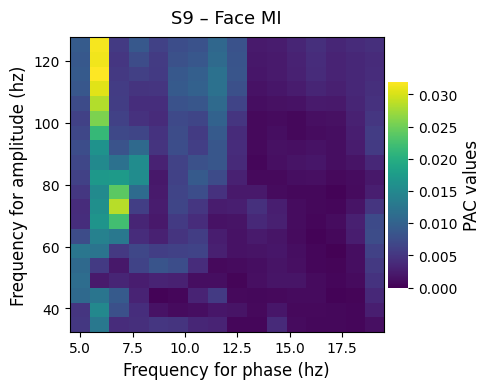

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


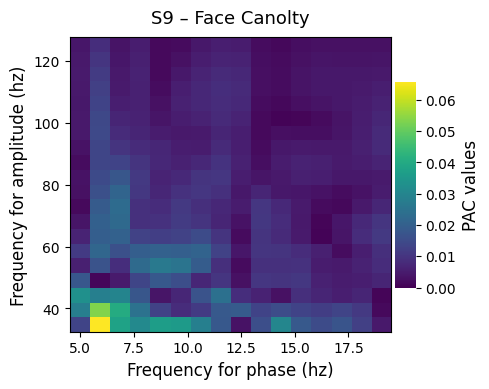

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [4.30784120e-07 6.39540258e-09 6.54825670e-06 2.47198875e-05
 8.87034431e-09 1.49232053e-06 5.97114637e-07 1.46329729e-05
 2.23903833e-06 8.30743857e-06]


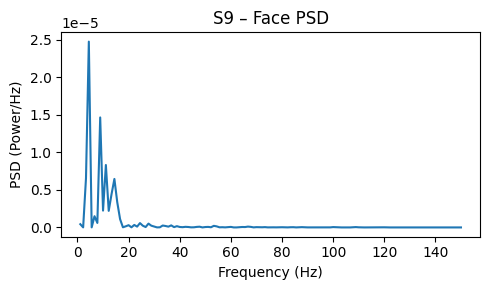

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.00427802 -0.00502217 -0.00367791 -0.00144856  0.00036219  0.00170535
  0.00332686  0.00546582  0.00755864  0.00909341]
  Body: avg_sig sample values after detrend: [-7.59899532e-03 -8.33936009e-03 -6.99132457e-03 -4.75819443e-03
 -2.94366893e-03 -1.59673210e-03  2.85582714e-05  2.17130003e-03
  4.26789427e-03  5.80644307e-03]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


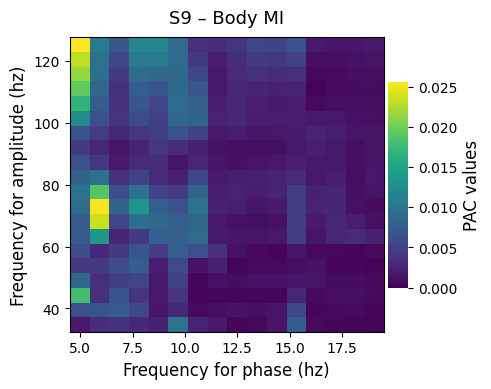

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


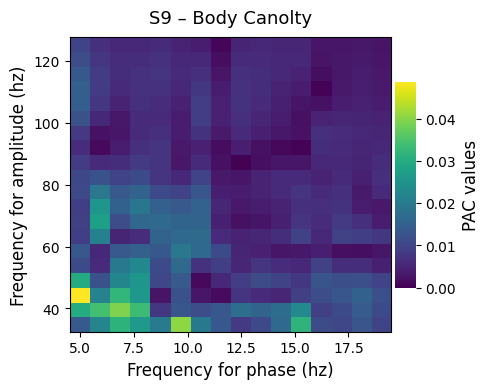

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [1.20054515e-06 3.44825891e-09 5.00322597e-06 5.19514304e-06
 3.50874086e-06 1.25189414e-05 9.37069060e-06 1.04294257e-05
 8.65827345e-06 1.36479517e-05]


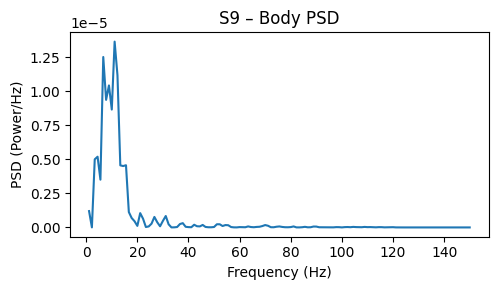

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.01059144 -0.01596755 -0.01786055 -0.01755439 -0.01754339 -0.0185632
 -0.019453   -0.0192566  -0.01832035 -0.01729207]
  Natural: avg_sig sample values after detrend: [-0.01271819 -0.01808843 -0.01997556 -0.01966354 -0.01964667 -0.02066061
 -0.02154454 -0.02134228 -0.02040015 -0.01936601]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


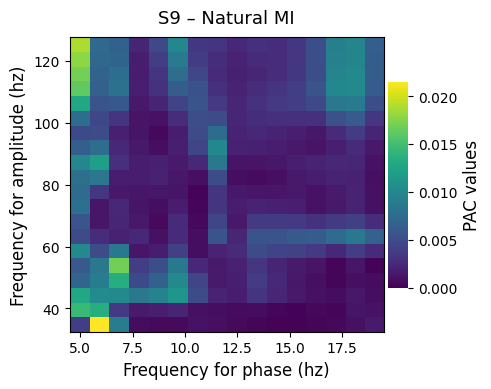

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


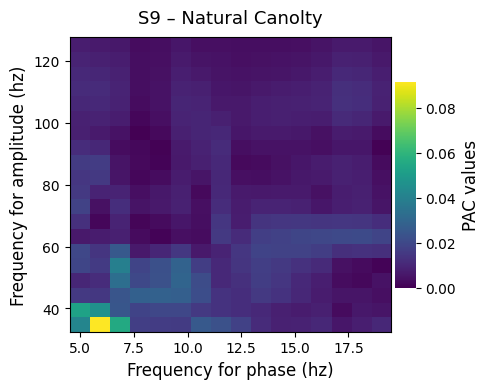

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [6.67942104e-07 5.53042654e-08 1.17436489e-05 6.61833394e-05
 3.82022470e-05 1.19318100e-05 2.45731560e-05 4.87342199e-07
 2.29697000e-07 2.55151954e-06]


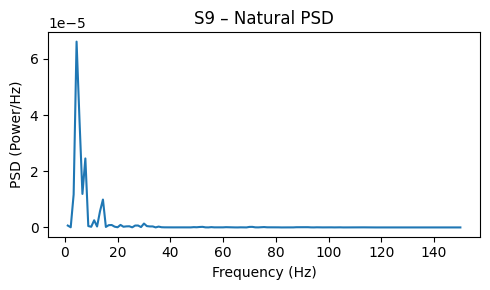

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [ 0.00682752  0.00860803  0.00733455  0.00475517  0.0030051   0.00237836
  0.00175095  0.00051259 -0.00075892 -0.00137204]
  Artifact: avg_sig sample values after detrend: [0.00869928 0.01047599 0.0091987  0.00661552 0.00486165 0.00423111
 0.0035999  0.00235773 0.00108242 0.0004655 ]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


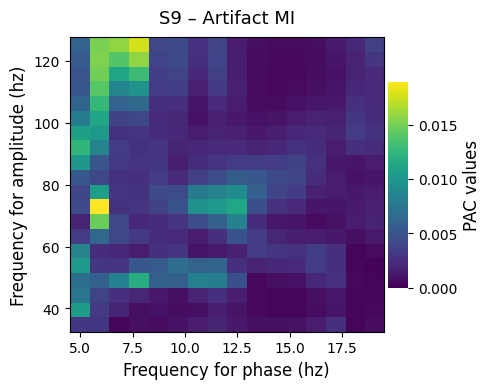

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


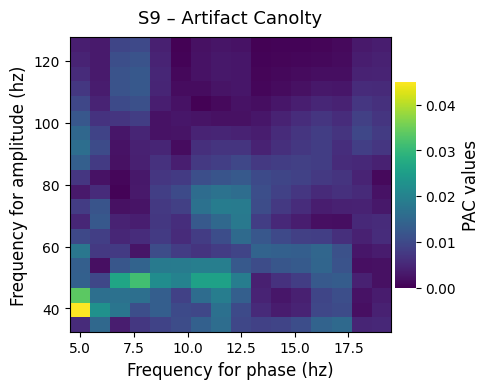

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [2.21685247e-07 6.82530898e-08 2.77880900e-06 1.38398024e-05
 4.45578442e-05 3.34251641e-05 2.39648727e-07 2.50431121e-08
 9.00950761e-06 9.75384595e-06]


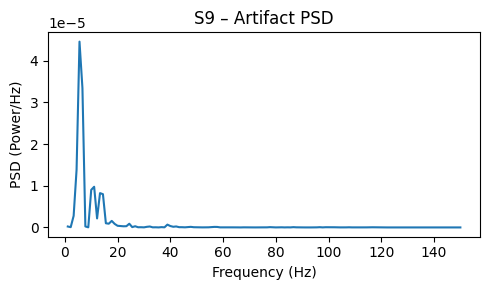

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 10: n_samples = 900, n_trials = 821, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [ 0.00813283  0.01118104  0.01060732  0.00768673  0.0047428   0.00268944
  0.00097572 -0.00074721 -0.00193291 -0.00212659]
  Face: avg_sig sample values after detrend: [0.01081486 0.01385911 0.01328141 0.01035685 0.00740895 0.00535161
 0.00363391 0.00190701 0.00071735 0.00051969]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


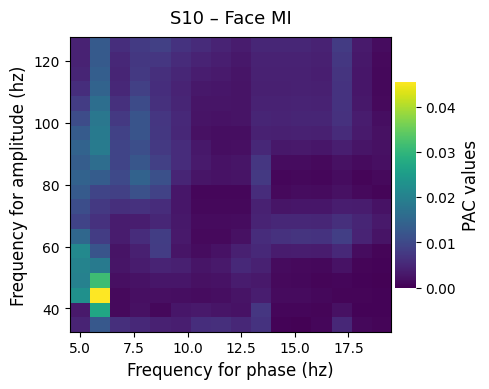

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


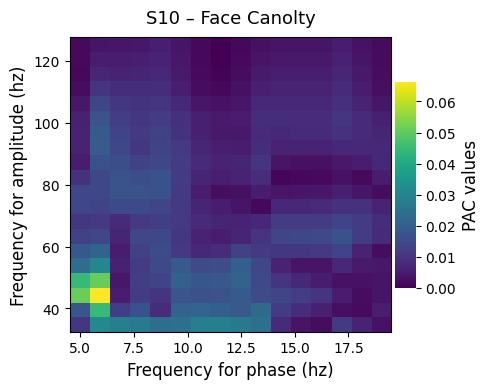

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [5.22760780e-07 9.55518678e-08 1.67400705e-05 3.45956180e-05
 8.54362997e-06 7.64419240e-06 4.79747636e-06 1.77501989e-06
 1.58774796e-06 4.62208162e-06]


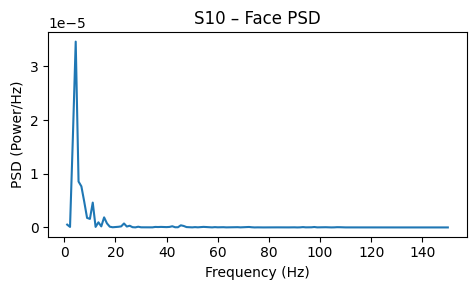

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-8.74644991e-05 -1.48799491e-04  4.37748461e-05  5.81555533e-04
  1.34627120e-03  2.13383985e-03  2.84642204e-03  3.53904231e-03
  4.29724097e-03  5.10672314e-03]
  Body: avg_sig sample values after detrend: [-0.00110946 -0.00116851 -0.00097365 -0.00043359  0.00033342  0.00112327
  0.00183814  0.00253304  0.00329353  0.00410529]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


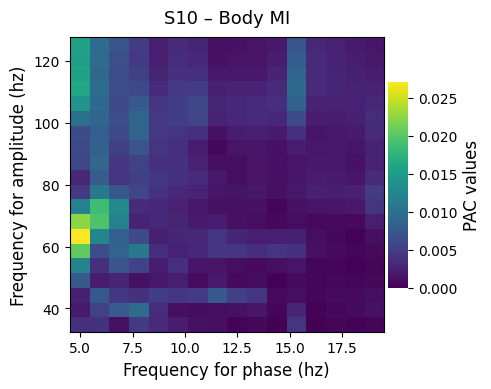

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


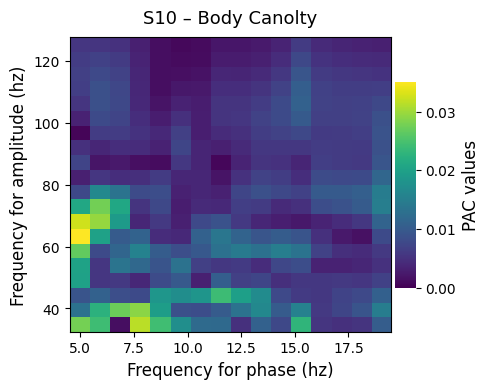

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [7.84059126e-08 9.89214493e-08 8.61679290e-06 6.25442336e-05
 8.31643249e-05 4.23415708e-06 2.46782581e-06 3.41964979e-06
 8.17842691e-06 2.64553537e-06]


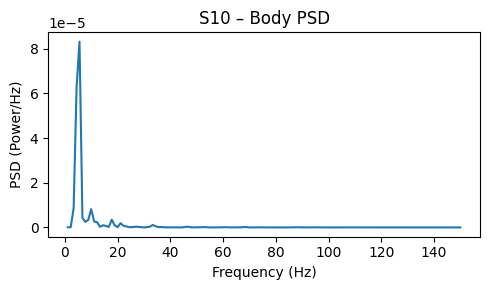

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.00649412 -0.00958713 -0.01035567 -0.00966459 -0.00914231 -0.00927384
 -0.00931099 -0.00862794 -0.00745373 -0.0062608 ]
  Natural: avg_sig sample values after detrend: [-0.00797436 -0.01106568 -0.01183254 -0.01113977 -0.01061581 -0.01074564
 -0.01078111 -0.01009637 -0.00892047 -0.00772586]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


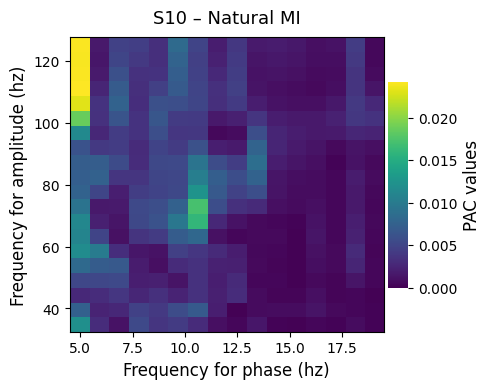

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


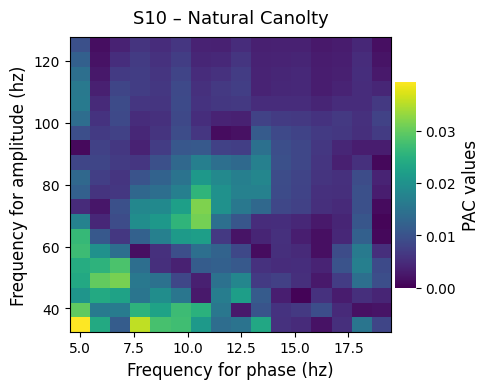

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [2.32659103e-07 1.41899222e-08 4.78354376e-06 1.07308505e-05
 1.84388139e-05 4.79667400e-05 1.83563847e-05 1.51600402e-07
 1.89946811e-07 1.83719602e-06]


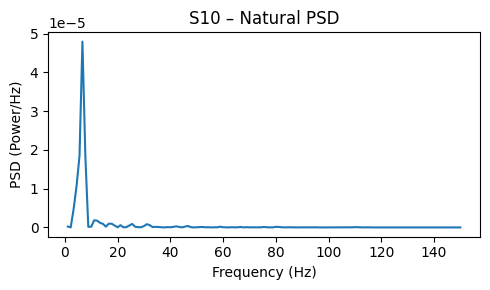

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-0.00532084 -0.00623115 -0.00468017 -0.00250448 -0.00165607 -0.00222636
 -0.00290059 -0.00275881 -0.00198038 -0.00101824]
  Artifact: avg_sig sample values after detrend: [-0.00778691 -0.00869459 -0.00714098 -0.00496266 -0.00411163 -0.00467928
 -0.00535088 -0.00520648 -0.00442541 -0.00346064]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


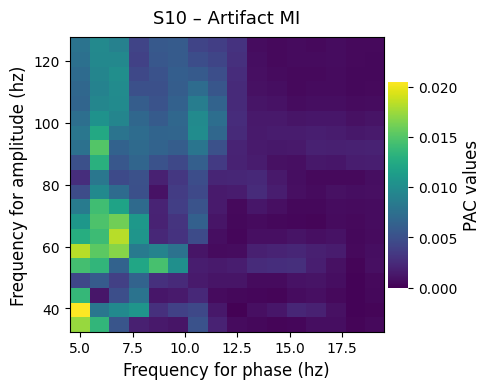

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


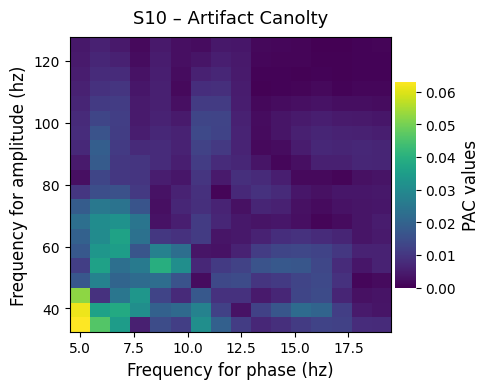

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [6.12254728e-07 4.29823188e-07 4.69251026e-05 5.79690194e-05
 3.63756468e-07 2.00895964e-06 2.41149162e-06 3.53800002e-06
 9.76420072e-07 2.06647309e-06]


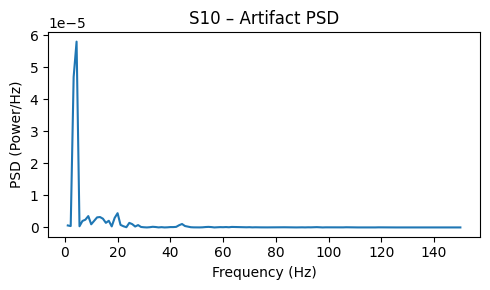

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)



Session 11: n_samples = 900, n_trials = 778, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.00183732 -0.00126339  0.00076946  0.00311628  0.00456393  0.00486555
  0.00459605  0.00433283  0.00428172  0.00454065]
  Face: avg_sig sample values after detrend: [-0.00432471 -0.00374437 -0.00170511  0.00064812  0.00210218  0.00241021
  0.00214713  0.00189031  0.00184561  0.00211096]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


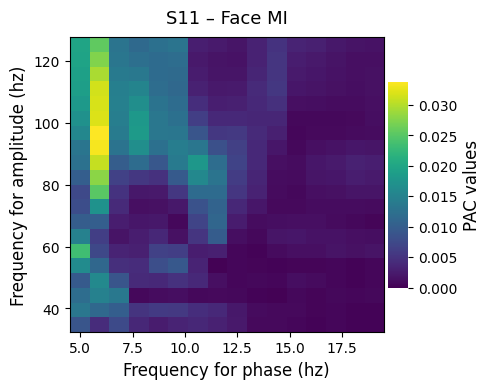

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


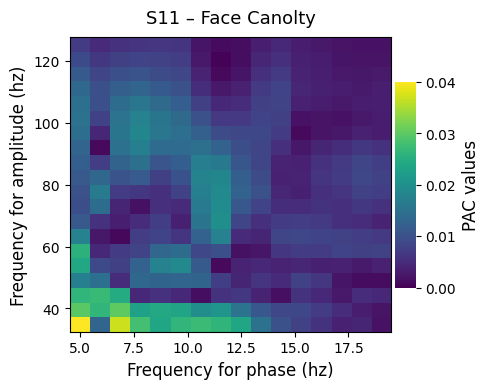

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [7.55518450e-07 1.57431059e-08 1.44214278e-06 1.30133602e-06
 1.51357069e-07 5.61615669e-06 1.55834547e-05 1.21205517e-05
 1.90119118e-06 6.00556315e-06]


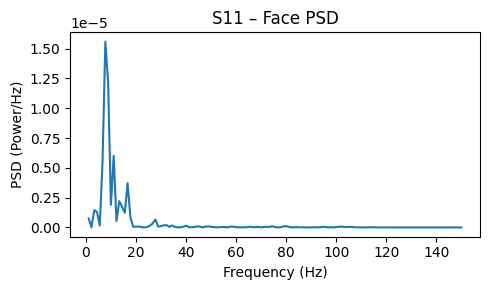

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.00517088 -0.00621891 -0.00518152 -0.00395956 -0.00445531 -0.00663815
 -0.00903283 -0.01054818 -0.01123667 -0.01153718]
  Body: avg_sig sample values after detrend: [-0.00283467 -0.00388721 -0.00285433 -0.00163687 -0.00213713 -0.00432447
 -0.00672366 -0.00824351 -0.0089365  -0.00924153]


WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


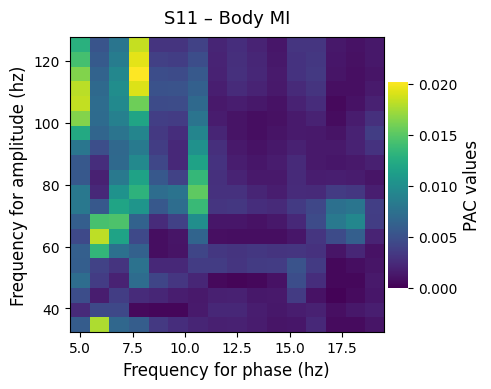

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


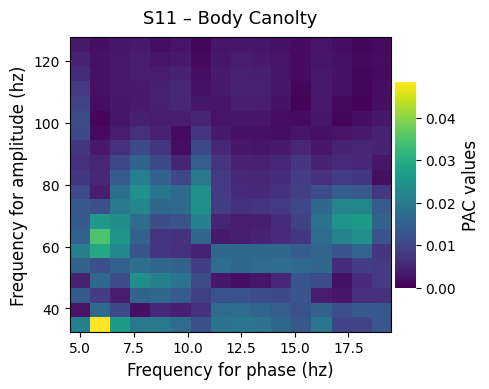

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [3.74723325e-07 2.34512148e-08 6.89122336e-06 5.14761924e-05
 9.56440971e-05 4.92878944e-05 6.13247285e-06 1.03335722e-05
 1.13811598e-05 6.27922068e-06]


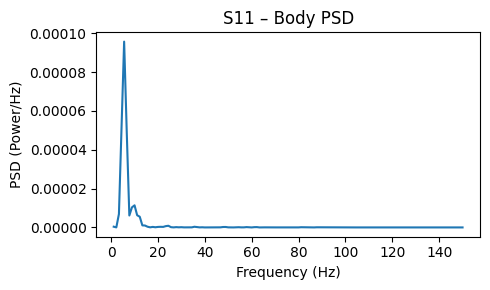

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [0.02024374 0.02809319 0.02812523 0.02420493 0.02198251 0.02267997
 0.02351729 0.02260136 0.02105683 0.02052497]
  Natural: avg_sig sample values after detrend: [0.01963597 0.02748817 0.02752297 0.02360541 0.02138574 0.02208596
 0.02292603 0.02201284 0.02047107 0.01994196]
  Natural: Calculated PAC (MI and Canolty)


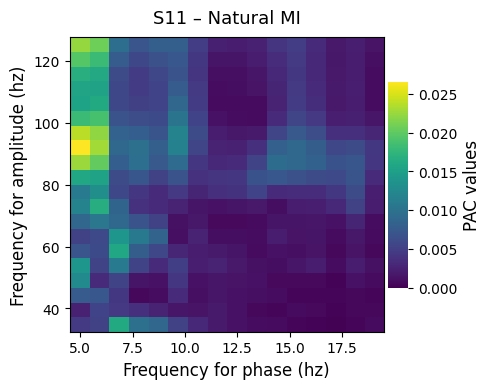

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


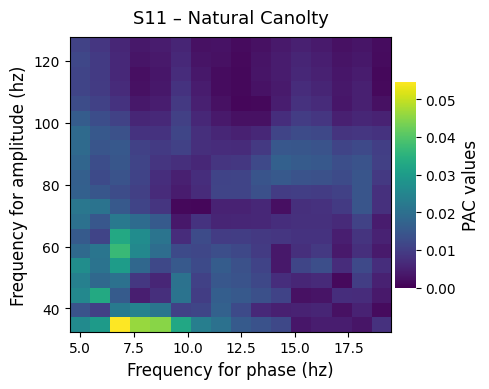

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [2.80729228e-07 4.41530400e-08 1.81473945e-06 3.02012454e-05
 4.59871525e-05 2.16990387e-05 2.35186109e-05 4.03994485e-06
 8.36656396e-08 7.60875159e-07]


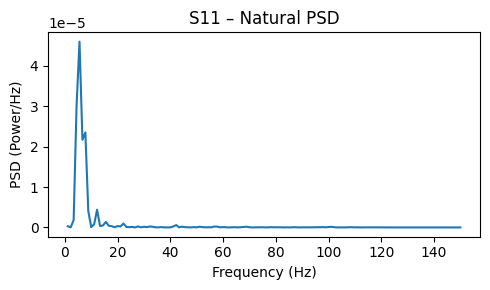

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-0.01098233 -0.01655193 -0.01848907 -0.0180105  -0.01757067 -0.01793782
 -0.01814846 -0.01761347 -0.01705175 -0.01725828]
  Artifact: avg_sig sample values after detrend: [-0.00919329 -0.01476641 -0.01670708 -0.01623203 -0.01579572 -0.01616639
 -0.01638055 -0.01584908 -0.01529089 -0.01550093]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


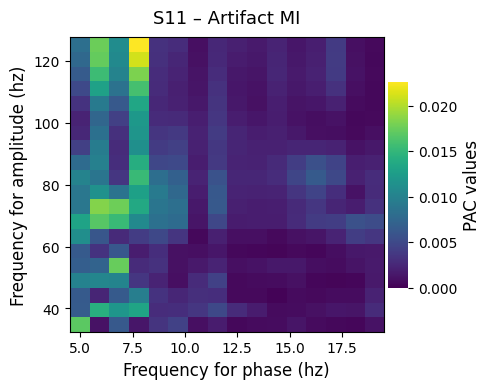

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


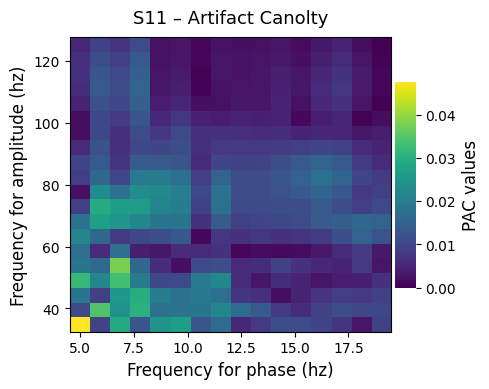

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [2.22570507e-07 3.13094740e-08 2.64718845e-06 8.47152529e-06
 8.89654038e-07 1.19245822e-05 1.42790739e-05 1.44348824e-05
 7.59838172e-06 1.38493128e-06]


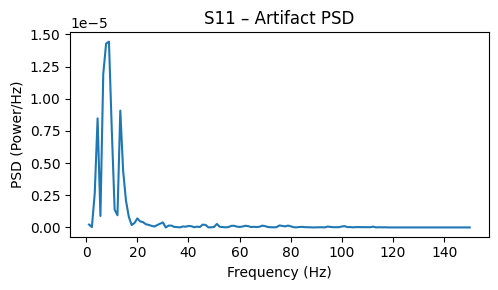

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 12: n_samples = 900, n_trials = 821, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [0.00404444 0.00580149 0.00573059 0.00438093 0.00308525 0.00261826
 0.0028615  0.0034711  0.00435248 0.00541087]
  Face: avg_sig sample values after detrend: [0.00541066 0.00716427 0.00708995 0.00573685 0.00443774 0.00396732
 0.00420712 0.00481329 0.00569124 0.0067462 ]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


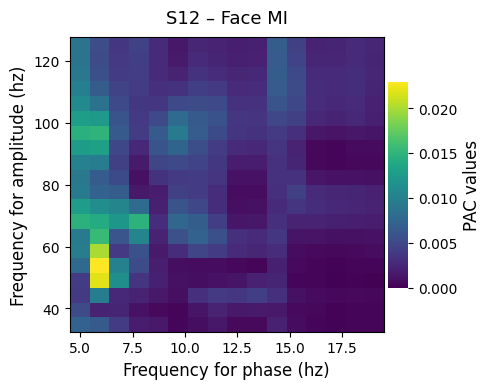

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


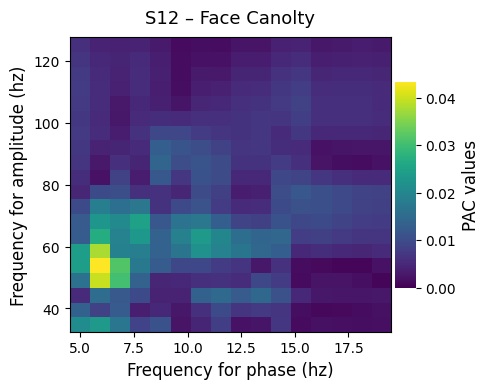

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [2.19018391e-07 3.18449888e-08 3.85975464e-06 3.69138889e-05
 3.21025616e-05 4.31558018e-06 5.05316215e-06 5.74859781e-06
 1.27282685e-06 1.73272556e-06]


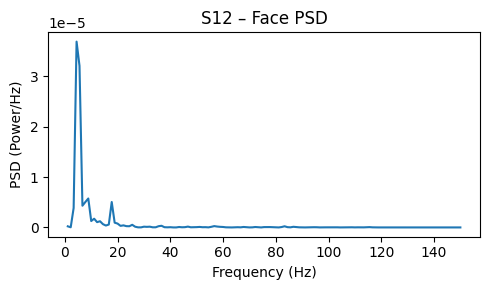

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.00102401 -0.00115502 -0.00086492 -0.0006264  -0.00091983 -0.00182107
 -0.00308582 -0.00448006 -0.00587127 -0.0070461 ]
  Body: avg_sig sample values after detrend: [ 3.60436284e-05 -9.73132986e-05  1.90430968e-04  4.26603121e-04
  1.30822676e-04 -7.72766245e-04 -2.03986978e-03 -3.43645727e-03
 -4.83002193e-03 -6.00720294e-03]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


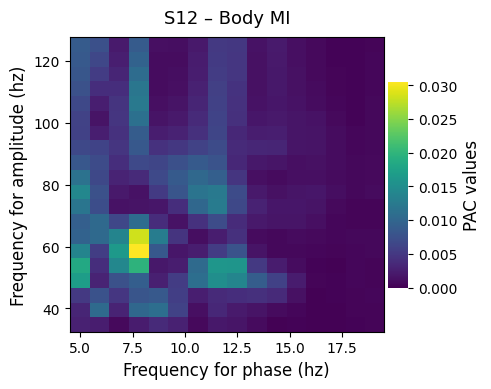

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


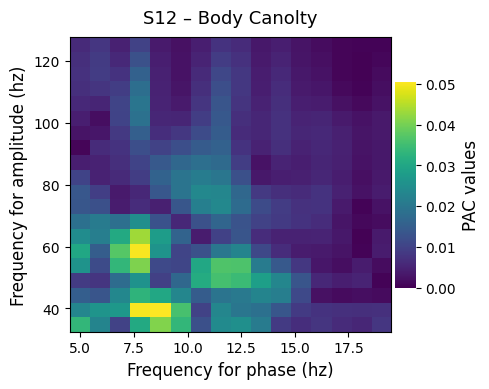

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [1.04663577e-07 8.97589399e-08 6.72471677e-06 3.13835312e-05
 2.98591978e-05 1.86086916e-05 5.60017382e-07 2.13825659e-05
 2.39642051e-06 8.79292535e-07]


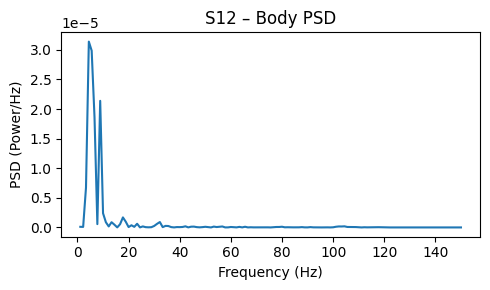

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.00893371 -0.01160322 -0.01106836 -0.00976381 -0.01015228 -0.0120022
 -0.01332703 -0.01315148 -0.01236792 -0.0121817 ]
  Natural: avg_sig sample values after detrend: [-0.00946058 -0.01212937 -0.01159378 -0.01028851 -0.01067625 -0.01252544
 -0.01384955 -0.01367328 -0.01288899 -0.01270204]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


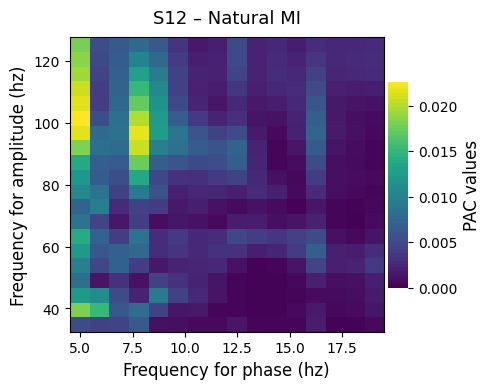

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


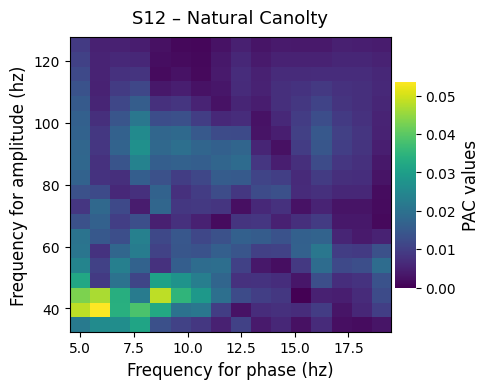

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [3.53206205e-08 3.06825477e-07 1.23825960e-05 1.59889033e-05
 2.43391582e-05 2.37202627e-05 2.33120904e-06 4.89257325e-07
 4.33631331e-06 7.91566307e-06]


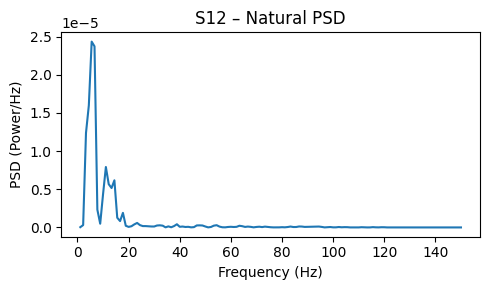

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [0.00746776 0.01014461 0.01000817 0.00905352 0.00990413 0.01306574
 0.01692433 0.01980483 0.0212072  0.02124357]
  Artifact: avg_sig sample values after detrend: [0.00730747 0.00998572 0.00985069 0.00889744 0.00974946 0.01291248
 0.01677247 0.01965438 0.02105816 0.02109594]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


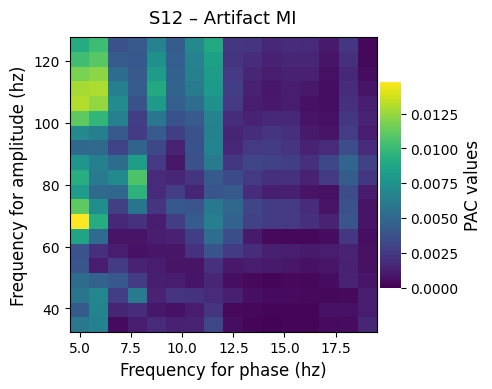

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


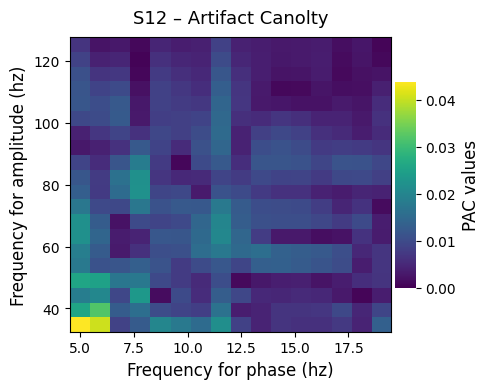

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [9.56470978e-08 6.62282102e-08 1.01022023e-06 1.49422337e-05
 2.55481619e-05 7.26319708e-06 1.07921617e-06 8.30960474e-06
 4.65210451e-06 2.70329986e-06]


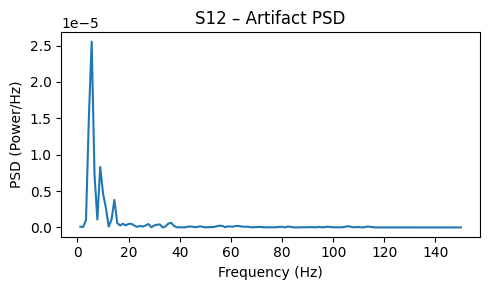

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 13: n_samples = 900, n_trials = 822, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [0.01458818 0.02104176 0.02263052 0.02164024 0.02134171 0.02204873
 0.0217216  0.01937276 0.01630902 0.01413485]
  Face: avg_sig sample values after detrend: [0.01556464 0.02201728 0.0236051  0.02261388 0.0223144  0.02302048
 0.02269241 0.02034263 0.01727795 0.01510284]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


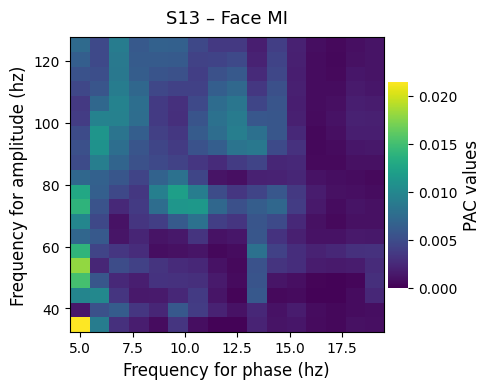

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


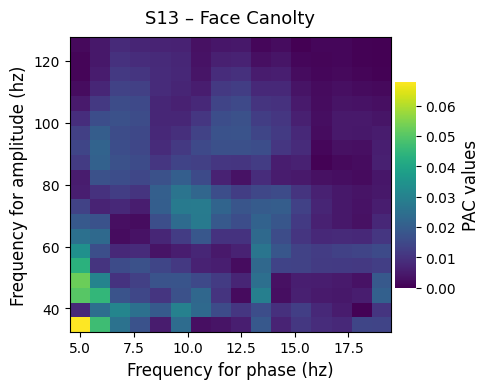

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [1.14035787e-07 1.77791018e-08 6.20416597e-06 1.71014612e-05
 4.64861215e-06 1.21342478e-05 4.36345839e-05 2.98296883e-05
 2.43990770e-05 2.07349929e-05]


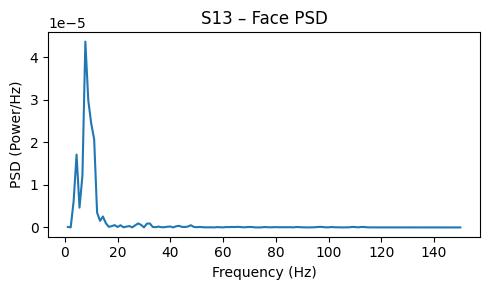

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.00896583 -0.01280496 -0.01343514 -0.01250973 -0.01251621 -0.01397728
 -0.01551809 -0.01602827 -0.01577545 -0.01547522]
  Body: avg_sig sample values after detrend: [-0.0083101  -0.01214689 -0.01277473 -0.01184699 -0.01185112 -0.01330985
 -0.01484832 -0.01535616 -0.015101   -0.01479843]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


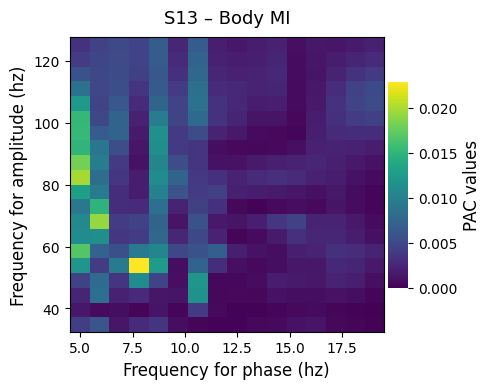

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


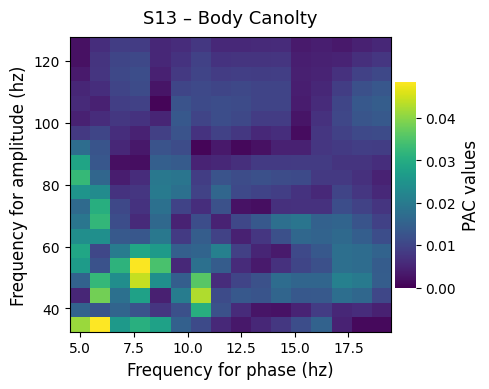

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [1.06444058e-06 3.94296616e-07 4.08428531e-05 7.02279754e-05
 2.16807693e-05 1.17003905e-05 2.41667759e-05 1.03977766e-05
 1.22535844e-06 1.05578759e-06]


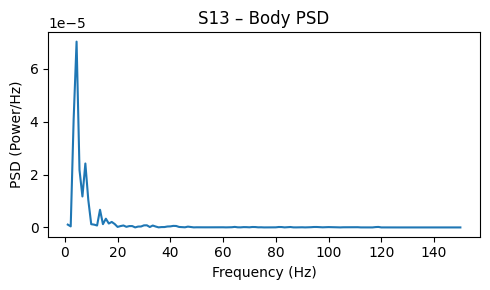

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [0.01025252 0.01386529 0.01280814 0.00918548 0.00658078 0.00648804
 0.00794389 0.00974573 0.01172307 0.01386325]
  Natural: avg_sig sample values after detrend: [0.00903839 0.01265304 0.01159777 0.00797699 0.00537417 0.00528331
 0.00674104 0.00854476 0.01052397 0.01266604]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


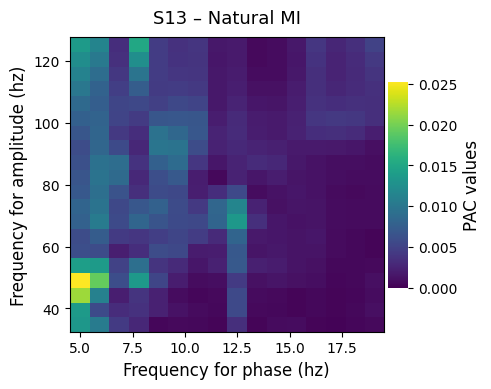

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


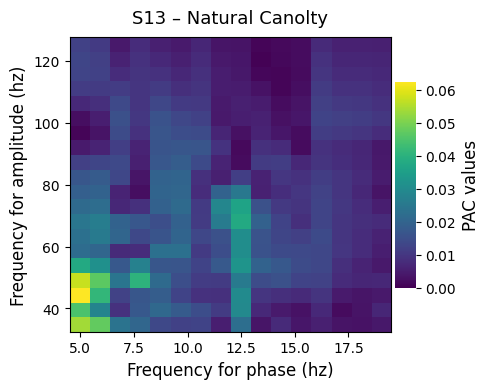

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [9.12202838e-08 1.17463367e-07 1.56963605e-06 3.35990291e-05
 4.20654734e-05 9.39824544e-06 5.16216271e-06 5.44836409e-06
 5.35727152e-06 2.09540314e-06]


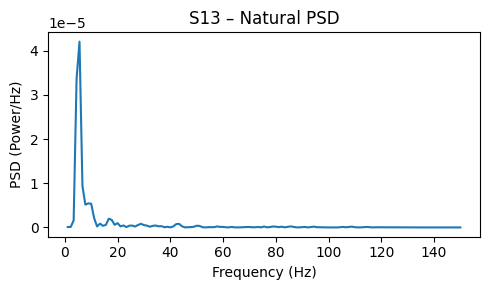

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-0.0083834  -0.01183125 -0.01177003 -0.00938196 -0.00691232 -0.00522788
 -0.00378915 -0.00236761 -0.00174805 -0.00264052]
  Artifact: avg_sig sample values after detrend: [-0.00881221 -0.01225999 -0.01219869 -0.00981054 -0.00734083 -0.00565632
 -0.00421751 -0.0027959  -0.00217626 -0.00306865]


Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


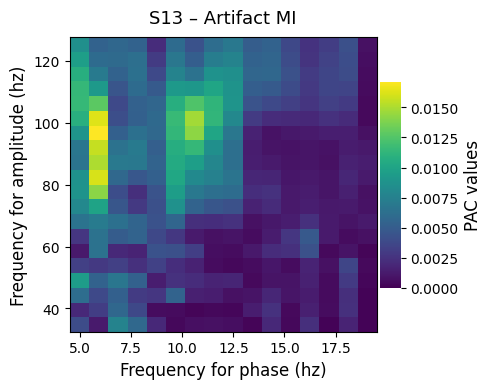

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


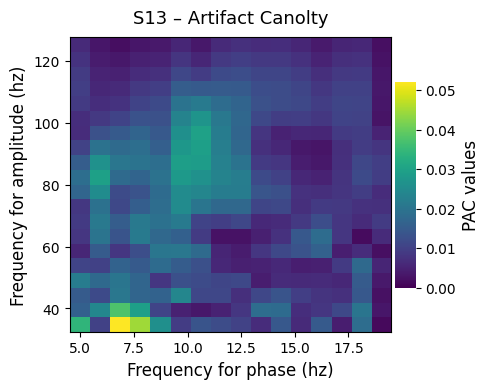

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [3.29601661e-08 1.25665869e-07 6.05945833e-05 2.74991521e-04
 1.11174983e-04 3.20500117e-05 1.32987372e-05 1.39600288e-05
 1.95046544e-05 9.29145108e-06]


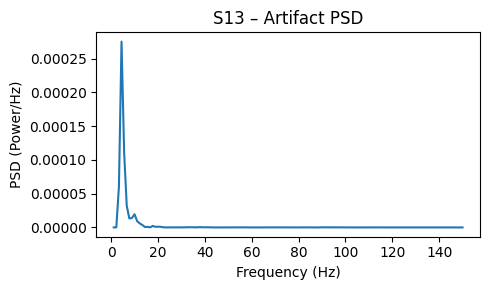

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)



Session 14: n_samples = 900, n_trials = 820, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [0.02607877 0.03521082 0.03378941 0.02728599 0.02323232 0.02304992
 0.02288604 0.02022267 0.01660983 0.0142569 ]
  Face: avg_sig sample values after detrend: [0.02870946 0.03784273 0.03642254 0.02992034 0.02586789 0.02568671
 0.02552405 0.0228619  0.01925029 0.01689857]


WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


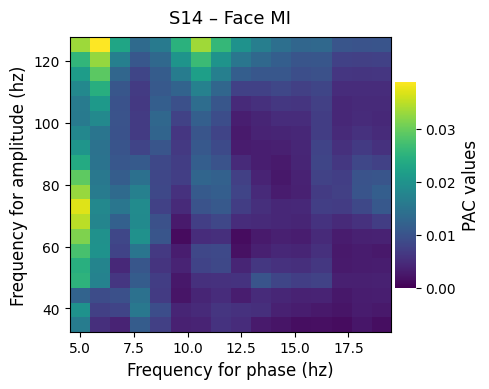

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


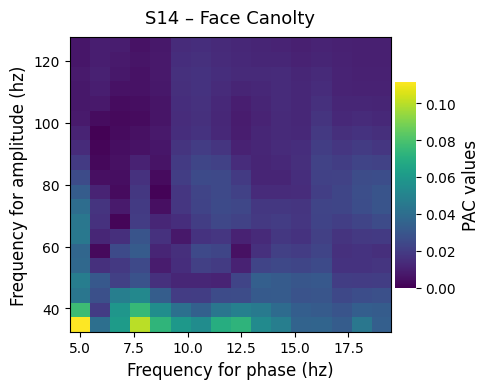

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [3.64582747e-06 1.38766446e-07 2.49846881e-05 1.01429170e-05
 1.36963296e-04 4.81014276e-05 3.57085944e-06 4.07588097e-05
 2.08699806e-04 1.21867630e-04]


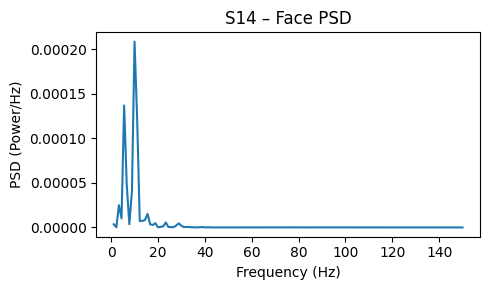

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [ 0.00024     0.00031134  0.00012092 -0.00026589 -0.00061529 -0.00078282
 -0.00090645 -0.00134056 -0.00241431 -0.0042363 ]
  Body: avg_sig sample values after detrend: [ 0.00434535  0.00440592  0.00420472  0.00380714  0.00344696  0.00326866
  0.00313425  0.00268937  0.00160485 -0.00022791]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)


  Body: Calculated PAC (MI and Canolty)

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


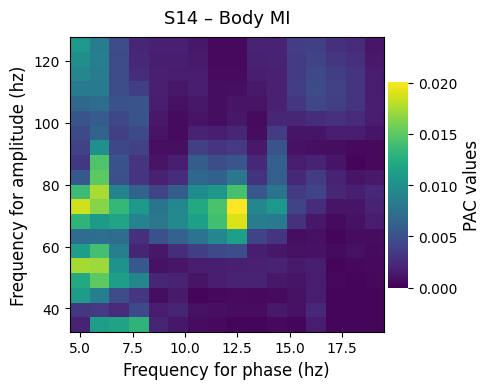

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


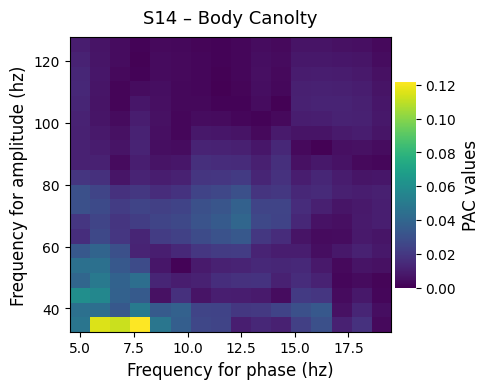

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [2.10271381e-06 5.57758717e-08 8.77870718e-05 7.13727255e-04
 6.30207282e-04 8.11106562e-06 1.38074430e-05 4.24737184e-05
 8.22220398e-06 6.31799104e-05]


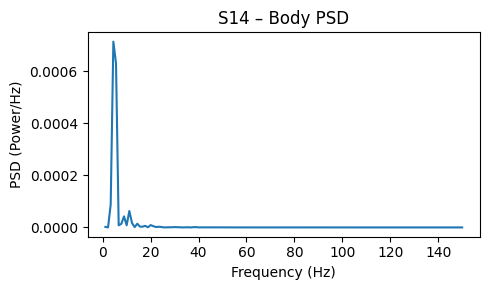

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.02740808 -0.03870226 -0.03956335 -0.03463144 -0.03123414 -0.03125646
 -0.03148623 -0.02979139 -0.02778169 -0.02749593]
  Natural: avg_sig sample values after detrend: [-0.02595694 -0.03724723 -0.03810442 -0.03316862 -0.02976743 -0.02978586
 -0.03001174 -0.028313   -0.02629941 -0.02600976]


WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


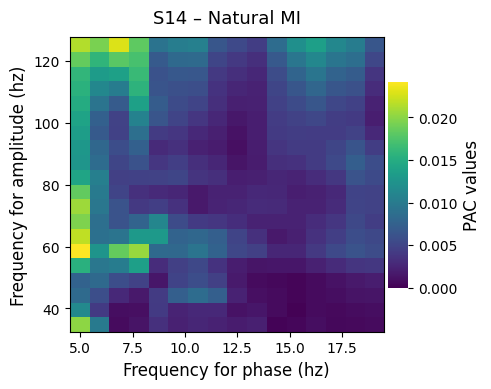

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


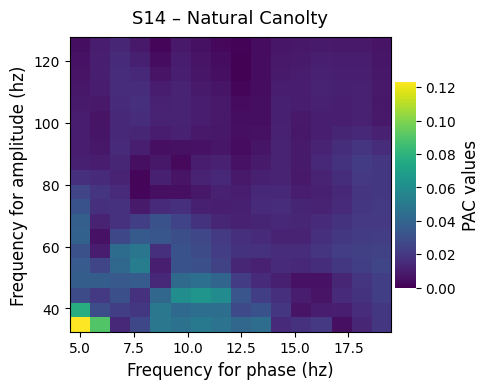

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [3.83724577e-06 8.91736638e-07 9.48221504e-05 1.01944496e-04
 4.64784158e-05 7.53160890e-05 2.58520777e-05 1.29252774e-05
 1.30783213e-04 1.66176290e-04]


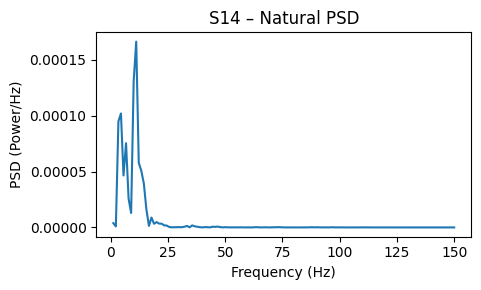

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [0.04610126 0.06416742 0.06455129 0.05561582 0.0495935  0.04887077
 0.04726707 0.04109192 0.03364258 0.02917401]
  Artifact: avg_sig sample values after detrend: [0.05491919 0.07296471 0.07332795 0.06437184 0.0583289  0.05758553
 0.0559612  0.04976542 0.04229545 0.03780624]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


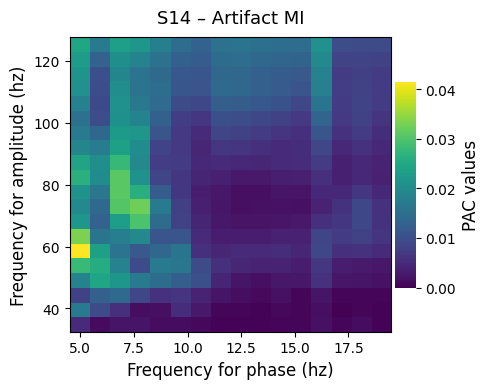

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


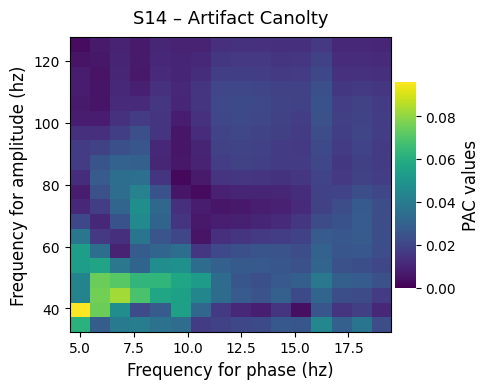

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [7.44434809e-06 7.26965431e-07 3.41978847e-05 2.19660139e-04
 5.71382256e-04 2.10826190e-04 1.49050116e-06 4.50300092e-05
 7.17966862e-07 1.04074455e-05]


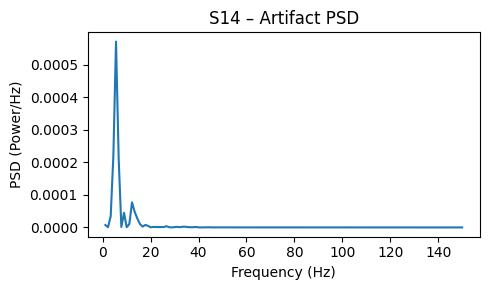

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)



Session 15: n_samples = 900, n_trials = 821, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.0294059  -0.04133998 -0.04208407 -0.03685835 -0.03372119 -0.03473618
 -0.03635501 -0.03611913 -0.03556479 -0.03668622]
  Face: avg_sig sample values after detrend: [-0.02684088 -0.03878419 -0.03953752 -0.03432103 -0.03119309 -0.03221731
 -0.03384537 -0.03361872 -0.03307361 -0.03420427]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Face: Calculated PAC (MI and Canolty)


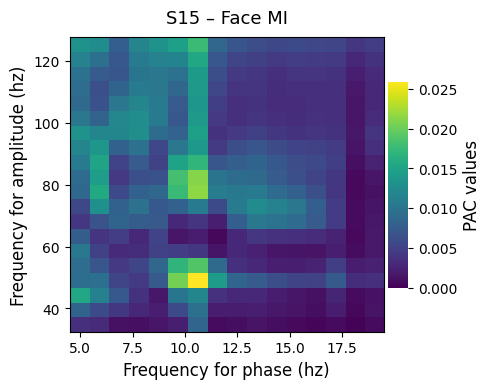

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


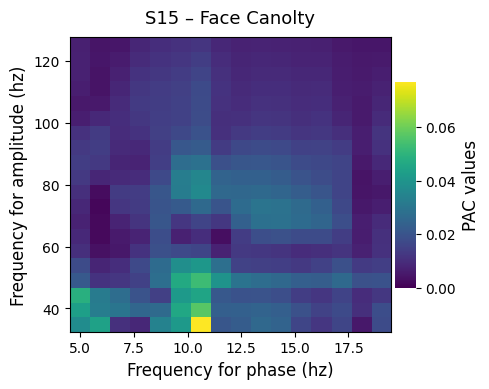

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [2.37376351e-06 4.96591145e-08 3.17192371e-06 1.42341905e-05
 6.06909078e-05 1.24403260e-04 1.10431985e-04 2.21366360e-05
 2.95252288e-05 6.00639937e-06]


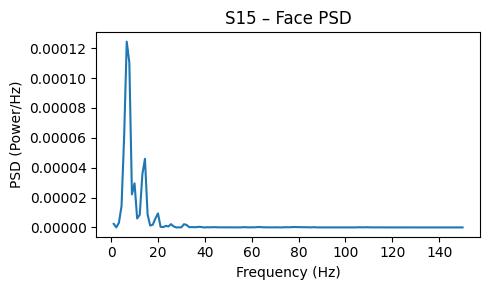

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [0.02266686 0.03195732 0.03299555 0.02988743 0.02861766 0.03038712
 0.03222509 0.03235118 0.03233831 0.03413846]
  Body: avg_sig sample values after detrend: [0.02220532 0.03149804 0.03253854 0.02943269 0.02816519 0.02993692
 0.03177715 0.03190552 0.03189492 0.03369733]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


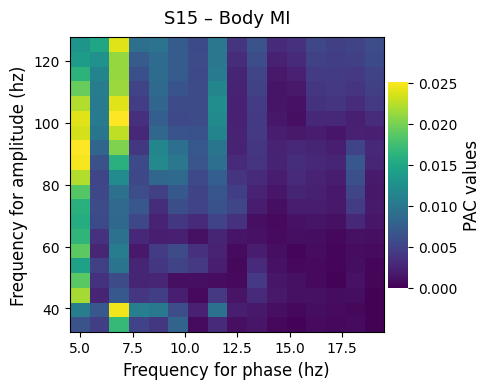

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


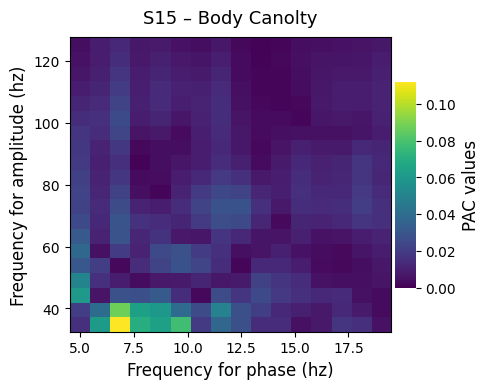

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [1.37386239e-07 7.19015915e-07 5.01162730e-05 1.64539899e-04
 2.58709568e-04 9.00334259e-05 1.80887028e-06 3.88661721e-05
 4.93995092e-05 7.47555443e-05]


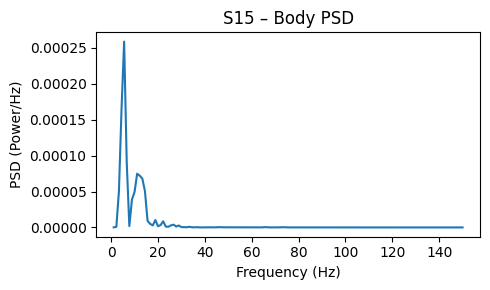

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.0122191  -0.01796872 -0.01884235 -0.01634931 -0.0139126  -0.0131174
 -0.01315313 -0.01310876 -0.01334896 -0.01444823]
  Natural: avg_sig sample values after detrend: [-0.0130086  -0.01875511 -0.01962563 -0.01712948 -0.01468967 -0.01389136
 -0.01392398 -0.0138765  -0.01411359 -0.01520974]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


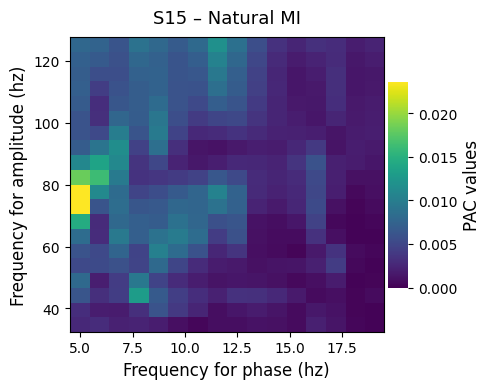

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


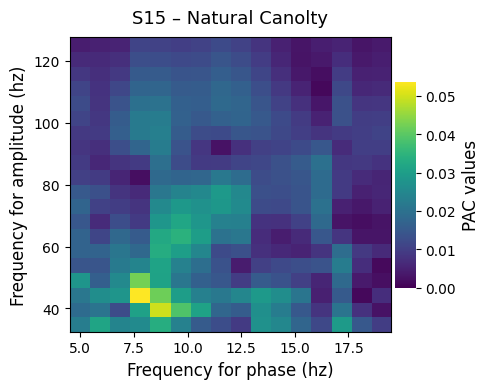

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [2.92816440e-07 1.84416113e-07 2.75106411e-05 4.70666762e-05
 2.26428009e-04 1.19429249e-04 1.35182152e-05 1.16228983e-05
 1.67766939e-04 5.04372703e-05]


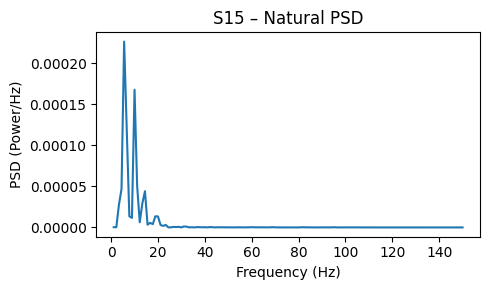

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [0.06274486 0.09179099 0.09890034 0.09336249 0.09110798 0.09657279
 0.10268254 0.10417999 0.10395084 0.10623354]
  Artifact: avg_sig sample values after detrend: [0.05084676 0.0799157  0.08704785 0.08153281 0.07930111 0.08478873
 0.09092129 0.09244154 0.0922352  0.09454071]


    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: Calculated PAC (MI and Canolty)


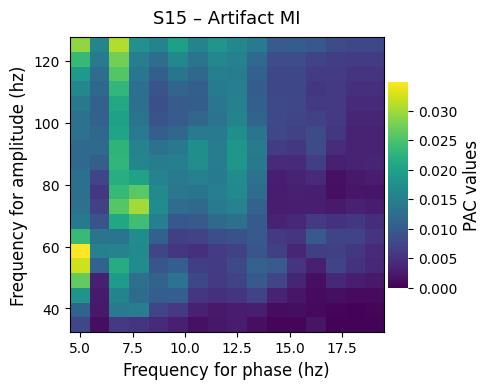

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


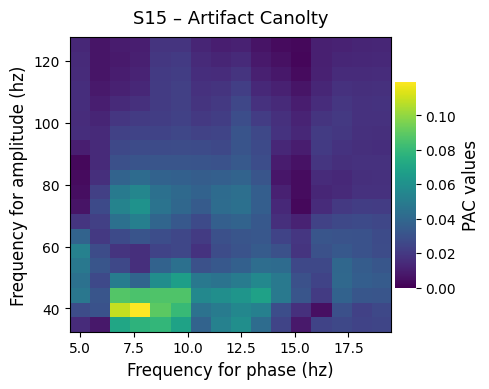

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [9.94580019e-06 7.76393009e-07 5.22454506e-05 2.20082793e-04
 2.39648053e-04 4.89199264e-05 1.93296370e-04 3.14571659e-04
 1.58976137e-04 9.17286290e-05]


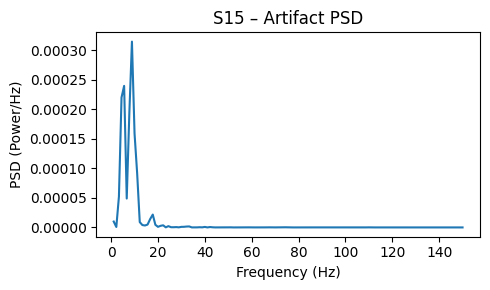

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension



Session 16: n_samples = 900, n_trials = 822, FS = 1000.00 Hz
  Face: avg_sig shape before detrend: (900,)
  Face: avg_sig sample values before detrend: [-0.00495007 -0.00870825 -0.01142672 -0.01293476 -0.01393105 -0.01498887
 -0.0161993  -0.01762612 -0.01960426 -0.02236793]
  Face: avg_sig sample values after detrend: [ 0.00067847 -0.00308945 -0.00581766 -0.00733543 -0.00834146 -0.00940902
 -0.01062919 -0.01206575 -0.01405363 -0.01682703]
  Face: Calculated PAC (MI and Canolty)


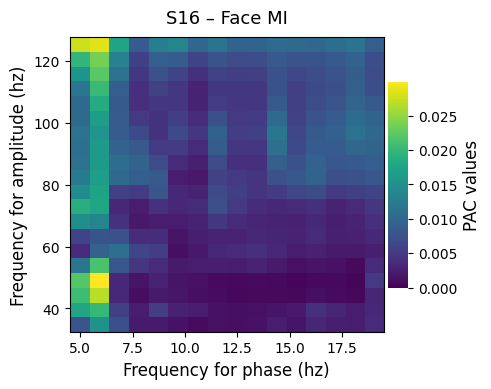

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


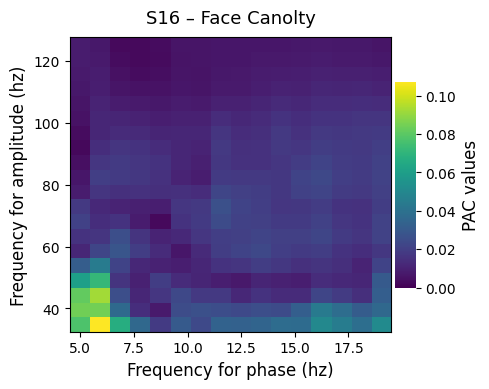

Effective window size : 0.900 (s)
  Face: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Face: PSD power sample: [1.85372033e-06 1.29559211e-06 1.85640440e-04 7.32480629e-04
 3.68841425e-04 1.14945022e-04 2.42330766e-06 4.43574366e-06
 2.32054931e-05 3.21391386e-05]


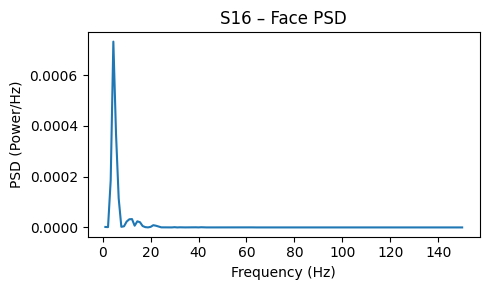

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)


  Body: avg_sig shape before detrend: (900,)
  Body: avg_sig sample values before detrend: [-0.01836908 -0.02583852 -0.02719269 -0.02604881 -0.02695874 -0.03016928
 -0.03263522 -0.03271687 -0.0318828  -0.03206731]
  Body: avg_sig sample values after detrend: [-0.01744343 -0.02491806 -0.02627742 -0.02513874 -0.02605386 -0.02926959
 -0.03174073 -0.03182757 -0.03099869 -0.03118839]


    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Body: Calculated PAC (MI and Canolty)


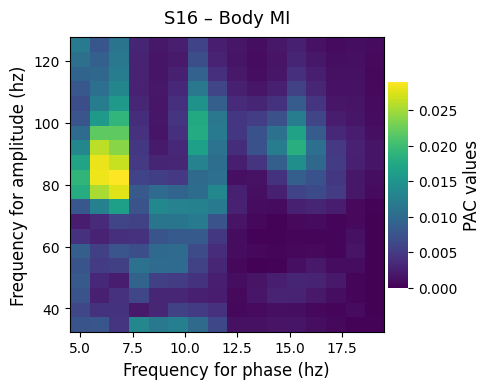

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


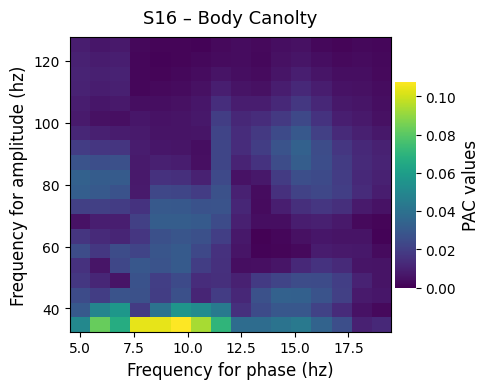

Effective window size : 0.900 (s)
  Body: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Body: PSD power sample: [1.15936730e-06 5.59462412e-07 2.01202939e-05 2.07511952e-04
 4.04394487e-05 4.60909829e-05 8.94474758e-05 2.31958302e-04
 1.10675029e-04 3.82932793e-05]


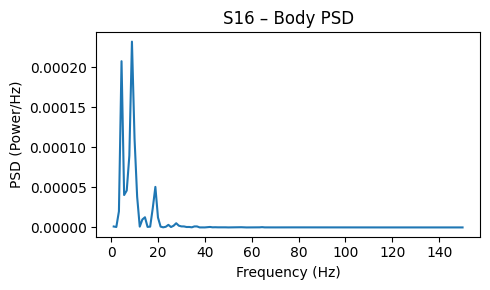

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)


  Natural: avg_sig shape before detrend: (900,)
  Natural: avg_sig sample values before detrend: [-0.00469095 -0.00681232 -0.00779934 -0.00858609 -0.01008848 -0.01203072
 -0.01342937 -0.0138779  -0.01390174 -0.01416939]
  Natural: avg_sig sample values after detrend: [-0.00907889 -0.01119216 -0.01217107 -0.0129497  -0.01444399 -0.01637812
 -0.01776866 -0.01820908 -0.01822481 -0.01848435]


    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Natural: Calculated PAC (MI and Canolty)


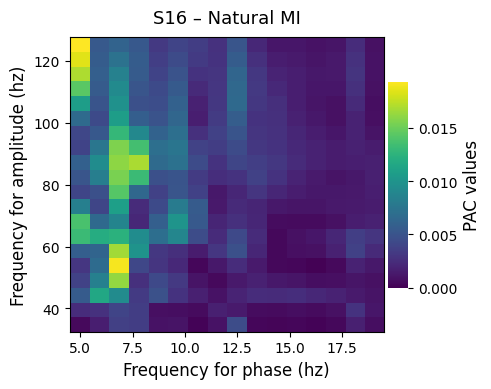

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


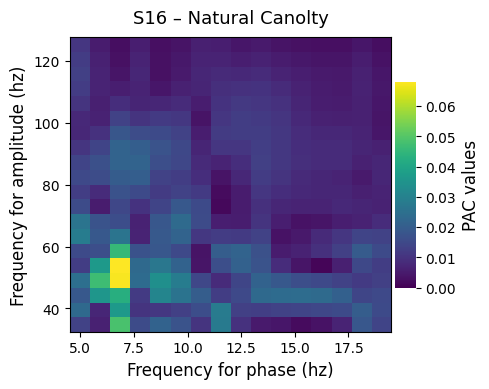

Effective window size : 0.900 (s)
  Natural: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Natural: PSD power sample: [1.32128213e-06 3.27254165e-07 8.45901900e-06 7.26369191e-05
 1.89082863e-04 1.32756906e-05 2.84067516e-04 2.86658159e-04
 2.40876791e-05 1.26025127e-06]


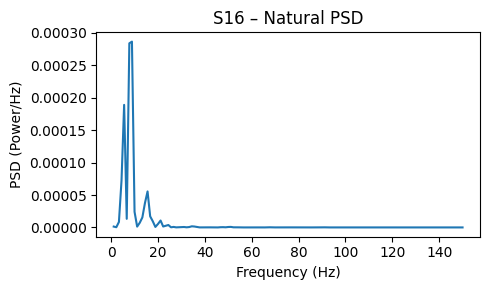

Phase Amplitude Coupling object defined
WARNING | MVL is amplitude dependent which means that if the amplitude increases, MVL also increases. You should select a normalization method for correcting this limitation (e.g idpac=(1, 2, 4))
Phase Amplitude Coupling object defined
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Modulation Index (MI, Tort et al. 2010)
    extract phases (n_pha=16) and amplitudes (n_amps=20)
    true PAC estimation using Mean Vector Length (MVL, Canolty et al. 2006)
WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


  Artifact: avg_sig shape before detrend: (900,)
  Artifact: avg_sig sample values before detrend: [-0.04783229 -0.06695724 -0.06824163 -0.06036211 -0.0558529  -0.0569819
 -0.05715722 -0.05240536 -0.04601979 -0.04231098]
  Artifact: avg_sig sample values after detrend: [-0.05577258 -0.07488474 -0.07615634 -0.06826403 -0.06374203 -0.06485823
 -0.06502077 -0.06025612 -0.05385775 -0.05013616]
  Artifact: Calculated PAC (MI and Canolty)


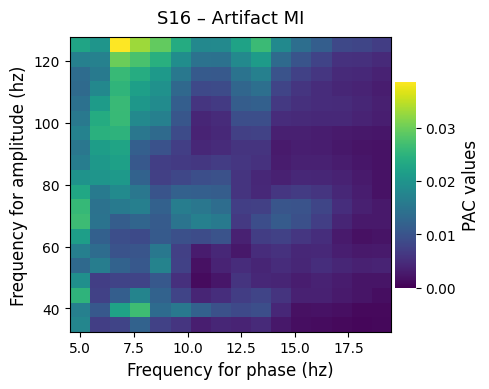

WARNING | 3d pac array has been given as an input. Only 2d arrays are supported for plotting. Taking the mean across the last dimension


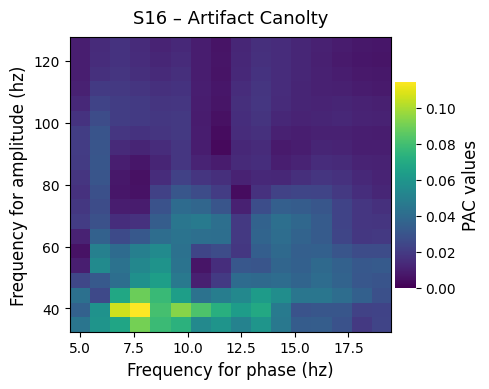

Effective window size : 0.900 (s)
  Artifact: PSD frequency range sample: [ 1.11111111  2.22222222  3.33333333  4.44444444  5.55555556  6.66666667
  7.77777778  8.88888889 10.         11.11111111]
  Artifact: PSD power sample: [3.87773679e-06 1.81940021e-06 2.70480799e-04 3.61204154e-04
 4.98368540e-05 5.04716370e-04 3.89535737e-04 2.52993766e-04
 2.03043853e-05 5.10902163e-05]


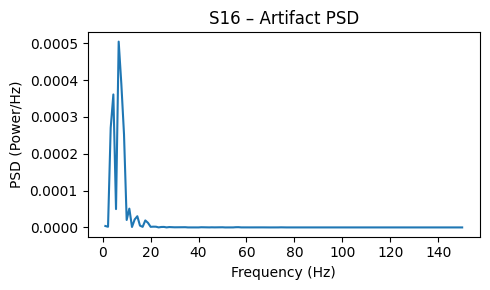

✓ Done processing sessions.


In [15]:
import numpy as np
import mat73
import matplotlib.pyplot as plt
from tensorpac import Pac
from mne.time_frequency import psd_array_welch
from scipy.signal import detrend
MAT_FILE = 'data_LFP.mat'
FS = 900 / 0.9
PHASE_BAND = np.linspace(4, 20, 17)
AMP_BAND = np.linspace(30, 130, 21)
CATEGORIES = ['Face', 'Body', 'Natural', 'Artifact']
MIN_TRIALS = 5
N_AVG_SESS = 17
FACE_LABELS = {1,2,3,4,5,6,7,8,9,10,11,12,13,15,17,18,27,75,76,77,78,79,80,83,
               102,103,104,105,106,107,110,129,130,131,132,133,134,137,
               156,157,158,159,160,161,162,163,164,165,166,167,168,169,170}
BODY_LABELS = {14,16,19,20,21,22,23,24,25,26,28,29,30,31,33,34,35,36,37,
               84,85,86,87,88,89,111,112,113,114,115,116,138,139,140,
               141,142,143}
NATURAL_LABELS = {32,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,72,73,
                  90,91,92,93,94,95,117,118,119,120,121,122,144,145,146,147,
                  148,149}
ARTIFACT_LABELS = {55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,74,
                   96,97,98,99,100,101,123,124,125,126,127,128,150,151,
                   152,153,154,155}
LABELS_MAP = {**{lbl: 'Face' for lbl in FACE_LABELS},
              **{lbl: 'Body' for lbl in BODY_LABELS},
              **{lbl: 'Natural' for lbl in NATURAL_LABELS},
              **{lbl: 'Artifact' for lbl in ARTIFACT_LABELS}}
mat = mat73.loadmat(MAT_FILE)
data_it_list = mat['data_LFP_it']['data_it']
cm_list = mat['data_LFP_it']['cm']
mi_store = {cat: [] for cat in CATEGORIES}
ca_store = {cat: [] for cat in CATEGORIES}
for sess_idx, (data_it, cm_vec) in enumerate(zip(data_it_list, cm_list)):
    if sess_idx >= N_AVG_SESS:
        break
    sig = np.asarray(data_it)
    if sig.ndim != 2:
        raise ValueError(f"Session {sess_idx}: data_it must be 2D")
    if sig.shape[0] < sig.shape[1]:
        sig = sig.T
    n_samples, n_trials = sig.shape
    print(f"\nSession {sess_idx}: n_samples = {n_samples}, n_trials = {n_trials}, FS = {FS:.2f} Hz")
    cm_arr = np.asarray(cm_vec).squeeze()
    if cm_arr.ndim != 1:
        cm_arr = cm_arr.ravel()
    labels = np.array([LABELS_MAP.get(int(x), 'Unknown') for x in cm_arr], dtype=object)
    if labels.size != n_trials:
        n_min = min(labels.size, n_trials)
        sig = sig[:, :n_min]
        labels = labels[:n_min]
        n_samples, n_trials = sig.shape
    for cat in CATEGORIES:
        mask = (labels == cat)
        n_cat = mask.sum()
        if n_cat < MIN_TRIALS:
            print(f"  {cat}: only {n_cat} trials (skipped)")
            continue
        avg_sig = sig[:, mask].mean(axis=1)
        print(f"  {cat}: avg_sig shape before detrend: {avg_sig.shape}")
        print(f"  {cat}: avg_sig sample values before detrend: {avg_sig[:10]}")
        avg_sig = detrend(avg_sig)
        print(f"  {cat}: avg_sig sample values after detrend: {avg_sig[:10]}")
        sig2d = avg_sig[np.newaxis, :]
        pac_mi = Pac(idpac=(2,0,0), f_pha=PHASE_BAND, f_amp=AMP_BAND, dcomplex='wavelet')
        pac_ca = Pac(idpac=(1,0,0), f_pha=PHASE_BAND, f_amp=AMP_BAND, dcomplex='wavelet')
        mi = pac_mi.filterfit(FS, sig2d)
        ca = pac_ca.filterfit(FS, sig2d)
        mi_store[cat].append(mi)
        ca_store[cat].append(ca)
        print(f"  {cat}: Calculated PAC (MI and Canolty)")
        plt.figure(figsize=(5,4))
        pac_mi.comodulogram(mi, title=f'S{sess_idx} – {cat} MI')
        plt.tight_layout()
        plt.show()
        plt.figure(figsize=(5,4))
        pac_ca.comodulogram(ca, title=f'S{sess_idx} – {cat} Canolty')
        plt.tight_layout()
        plt.show()
        psd, freqs = psd_array_welch(avg_sig, sfreq=FS, fmin=0.5, fmax=150,
                                     n_fft=min(2048, n_samples))
        print(f"  {cat}: PSD frequency range sample: {freqs[:10]}")
        print(f"  {cat}: PSD power sample: {psd[:10]}")
        plt.figure(figsize=(5,3))
        plt.plot(freqs, psd)
        plt.xlabel('Frequency (Hz)')
        plt.ylabel('PSD (Power/Hz)')
        plt.title(f'S{sess_idx} – {cat} PSD')
        plt.tight_layout()
        plt.show()
print("✓ Done processing sessions.")